# Use spectra of CTIO Data in June 2017 to do atmospheric studies
==================================================================================================
## Look at equivalent width

- author : Sylvie Dagoret-Campagne
- date   : July 5th 2017

This notebook is supposed to perform an atmospheric properties measurement on spectra

In [154]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [155]:
print theNotebook

AnaEqWdtCalibSpectrum


In [156]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl
from astropy.modeling import models
from astropy import units as u
from astropy import nddata
from astropy.io import fits
import re
import os
import pandas as pd

In [157]:
from matplotlib.backends.backend_pdf import PdfPages

In [158]:
import ccdproc
print 'ccdproc version',ccdproc.__version__

from astropy.modeling import models

ccdproc version 1.0.1


In [159]:
from scipy import stats  
from scipy import ndimage
from datetime import datetime, timedelta
from mpl_toolkits.mplot3d import Axes3D
import scipy.signal
from scipy.interpolate import interp1d

In [160]:
from scipy.optimize import curve_fit

In [161]:
import bottleneck as bn  # numpy's masked median is slow...really slow (in version 1.8.1 and lower)
print 'bottleneck version',bn.__version__

bottleneck version 1.2.0


In [162]:
import photutils
from astropy.stats import sigma_clipped_stats
from photutils import daofind
from photutils import CircularAperture
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
#from photutils.background import Background2D
from photutils import Background2D, SigmaClip, MedianBackground

In [163]:
import sys
sys.path.append("../../common_tools/")
from holo_specs import *

In [164]:
%load_ext Cython

The Cython extension is already loaded. To reload it, use:
  %reload_ext Cython


In [165]:
from IPython.display import Image, display

In [166]:
import matplotlib
matplotlib.rc('xtick', labelsize=20) 
matplotlib.rc('ytick', labelsize=20) 

In [167]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (10, 10),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [168]:
%config InlineBackend.rc = {}
matplotlib.rc_file("../../templates/matplotlibrc")

In [169]:
from scipy.interpolate import interp1d

In [170]:
import datetime
from dateutil import parser  # very usefull time format smart parser

In [171]:
from matplotlib.dates import MonthLocator, WeekdayLocator,DateFormatter
from matplotlib.dates import MONDAY

In [172]:
mondays = WeekdayLocator(MONDAY)
months = MonthLocator(range(1, 13), bymonthday=1, interval=1)
monthsFmt = DateFormatter("%b '%y")

In [173]:
import matplotlib.dates as mdates

years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
days=mdates.DayLocator()  # every day
hour=mdates.HourLocator()  # every day
yearsFmt = mdates.DateFormatter('%Y')

In [174]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (4, 4),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [175]:
############################################################################
def ensure_dir(f):
    d = os.path.dirname(f)
    if not os.path.exists(f):
        os.makedirs(f)
#########################################################################

## Config

In [176]:
inputdir="./spectrum_calibspec"
MIN_IMGNUMBER=144
MAX_IMGNUMBER=357
object_name='HD205905 Jun 08th 2017'
object_name_sim='HD205905_Jun_08th'
SelectTagRe='^calibSpectra_20170608_([0-9]+).fits$' # regular expression to select the file
SearchTagRe='^calibSpectra_20170608_[0-9]+.fits$'
NBIMGPERROW=2

### Input sim files

In [177]:
inputsimfitsfile='AllSimSpectra_'+object_name_sim+'.fits'

### Output files

In [178]:
outputdir="./spectrum_eqwana"

In [179]:
ensure_dir(outputdir)

In [180]:
output_file='AnaEqWdtFromSpectra_'+object_name_sim+'.csv'

In [181]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images

In [182]:
ensure_dir(dir_top_images) # create that directory

## Location of calibrated spectra and Simulations
----------------------------------

### Input simulation files

In [183]:
hdu_list=fits.open(inputsimfitsfile)
header=hdu_list[0].header
print header
simspectra_data=hdu_list[0].data

SIMPLE  =                    T / conforms to FITS standard                      BITPIX  =                  -64 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                 4839                                                  NAXIS2  =                   54                                                  EXTEND  =                    T                                                  END                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                     

In [184]:
print simspectra_data.shape

(54, 4839)


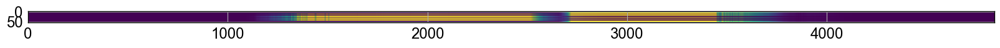

In [185]:
plt.figure(figsize=(20,20))
plt.imshow(simspectra_data[:,:],vmin=0,vmax=1e-12)
plt.xmin=(0.,10000.)

### Make tables

In [186]:
allspectra_sim=simspectra_data[1:,:]
thewl_sim=simspectra_data[0,:]

In [187]:
NBSPECSIM=allspectra_sim.shape[0]

In [188]:
allwl_sim = [thewl_sim for _ in range(NBSPECSIM)]

In [189]:
allwl_sim =np.array(allwl_sim )

In [190]:
allwl_sim=allwl_sim/10.

In [191]:
print NBSPECSIM

53


(0.0, 1000.0)

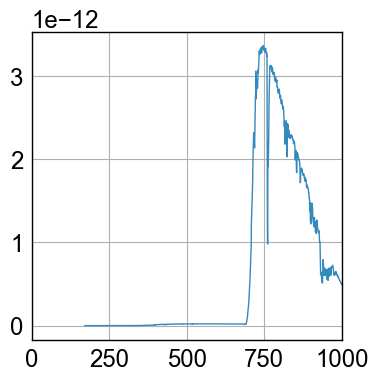

In [192]:
sel=1
plt.plot(allwl_sim[sel],allspectra_sim[sel])
plt.xlim(0.,1000.)

### Input data files

In [193]:
input_filelist=os.listdir(inputdir) 

In [194]:
if '.DS_Store' in input_filelist:
    input_filelist.remove('.DS_Store')
input_filelist=np.array(input_filelist)

In [195]:
print input_filelist[0:5]

['calibSpectra_20170608_155.fits' 'calibSpectra_20170608_159.fits'
 'calibSpectra_20170608_160.fits' 'calibSpectra_20170608_161.fits'
 'calibSpectra_20170608_162.fits']


In [196]:
indexes_files= [] # global list
filelist_fitsimages= []  # global list

In [197]:
#%%cython

import numpy as np
import re

def MakeFileList(inputdir,input_filelist):
    """
    MakeFileList : Make The List of files to open
    =============
    """
    
#    import numpy as np
#    import re
    indexes_files= [] # global list
    filelist_fitsimages= []  # global list
    
    for file in input_filelist: # loop on directories, one per image       
            filename=inputdir+'/'+file 
            
            if re.search('.*fits$',filename):  #example of filename filter
                
                num_str=re.findall(SelectTagRe,file)[0]
               
                index=int(num_str)
                filelist_fitsimages.append(filename)
                indexes_files.append(index)   
                
                
    return indexes_files, filelist_fitsimages

In [198]:
indexes_files, filelist_fitsimages=MakeFileList(inputdir,input_filelist)   # filter to select fits file only

In [199]:
# transform into numpy arrays
indexes_files=np.array(indexes_files)
filelist_fitsimages=np.array(filelist_fitsimages)

In [200]:
print indexes_files

[155 159 160 161 162 165 167 173 176 183 185 189 190 193 196 197 198 209
 213 215 221 226 231 242 244 246 247 251 254 256 258 262 263 274 275 276
 283 286 289 296 297 298 302 318 319 321 322 323 327 336 346 348 357]


In [201]:
sorted_indexes=np.argsort(indexes_files) # sort the file indexes

In [202]:
sorted_numbers=indexes_files[sorted_indexes]

In [203]:
print sorted_indexes

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49
 50 51 52]


In [204]:
#sorted_files= [filelist_fitsimages[index] for index in sorted_indexes] # sort files
sorted_files=filelist_fitsimages[sorted_indexes]

In [205]:
sorted_files[0:5]

array(['./spectrum_calibspec/calibSpectra_20170608_155.fits',
       './spectrum_calibspec/calibSpectra_20170608_159.fits',
       './spectrum_calibspec/calibSpectra_20170608_160.fits',
       './spectrum_calibspec/calibSpectra_20170608_161.fits',
       './spectrum_calibspec/calibSpectra_20170608_162.fits'], 
      dtype='|S51')

## Build full filename
----------------------------

In [206]:
sorted_filenames=[]
for file in sorted_files:
    #fullfilename=os.path.join(inputdir,file)
    fullfilename=file
    sorted_filenames.append(fullfilename)

In [207]:
#sorted_filenames=np.array(sorted_filenames)
sorted_filenames=np.copy(sorted_files)

In [208]:
print sorted_filenames.shape

(53,)


## Acces to spectrum data
----------------------------------

In [209]:
%%cython

import numpy as np
from astropy.io import fits

def BuildCalibSpec(sorted_filenames,sorted_numbers,object_name):
    """
    BuildRawSpec
    ===============
    """

    all_dates = []
    all_airmass = []
    all_leftspectra_data = []
    all_rightspectra_data = []
    all_totleftspectra_data = []
    all_totrightspectra_data = []
    all_leftspectra_data_staterr = []
    all_rightspectra_data_staterr = []
    
    all_leftspectra_wl = []
    all_rightspectra_wl = []
    
    all_titles = []
    all_header = []
    all_expo = []
    all_filt= []
    all_filt1= []
    all_filt2= []
    all_hum = []
    
    all_elecgain = []
    
    NBFILES=sorted_filenames.shape[0]

    for idx in range(NBFILES):  
        
        file=sorted_filenames[idx]    
        
        hdu_list=fits.open(file)
        
        #hdu_list.info()
        
        header=hdu_list[0].header
        #print header
        date_obs = header['DATE-OBS']
        airmass = header['AIRMASS']
        expo = header['EXPTIME']
        num=sorted_numbers[idx]
        title=object_name+" z= {:3.2f} Nb={}".format(float(airmass),num)
        filters = header['FILTERS'].split(' ')[1]
        filters1= header['FILTER1']
        filters2= header['FILTER2']
        filters= filters1 + ' + ' + filters2
        hum= float(header['OUTHUM'])
        gain = 0.25*(float(header['GTGAIN11'])+float(header['GTGAIN12'])+float(header['GTGAIN21'])+float(header['GTGAIN22']))
        
        # now reads the spectra
        
        table_data=hdu_list[1].data
        
        if idx==0:
            cols = hdu_list[1].columns
            cols.info()
            print hdu_list[1].columns
            cols.names
     
    
        left_spectrum_wl=table_data.field('CalibLeftSpecWL')
        left_spectrum_data=table_data.field('CalibLeftSpec')
        left_totspectrum_data=table_data.field('CalibTotLeftSpec')
        left_spectrum_data_staterr=table_data.field('CalibStatErrorLeftSpec')
        
        right_spectrum_wl=table_data.field('CalibRightSpecWL')
        right_spectrum_data=table_data.field('CalibRightSpec')
        right_totspectrum_data=table_data.field('CalibTotRightSpec')
        right_spectrum_data_staterr=table_data.field('CalibStatErrorRightSpec')
        
        all_dates.append(date_obs)
        all_airmass.append(float(airmass))
        
        all_leftspectra_data.append(left_spectrum_data)
        all_rightspectra_data.append(right_spectrum_data)
        
        all_totleftspectra_data.append(left_totspectrum_data)
        all_totrightspectra_data.append(right_totspectrum_data)
        
        all_leftspectra_data_staterr.append(left_spectrum_data_staterr)
        all_rightspectra_data_staterr.append(right_spectrum_data_staterr)
        
        all_leftspectra_wl.append(left_spectrum_wl)
        all_rightspectra_wl.append(right_spectrum_wl)
        
       
        
        all_titles.append(title)
        all_header.append(header)
        all_expo.append(expo)
        
        all_filt.append(filters)
        all_filt1.append(filters1)
        all_filt2.append(filters2)
        all_hum.append(hum)
        all_elecgain.append(gain)
        
            
        hdu_list.close()
        
        
        
        
    return all_dates,all_airmass,all_titles,all_header,all_expo, all_leftspectra_data,all_rightspectra_data,all_totleftspectra_data,all_totrightspectra_data, all_leftspectra_data_staterr,all_rightspectra_data_staterr,all_leftspectra_wl,all_rightspectra_wl,all_filt,all_filt1,all_filt2,all_hum,all_elecgain

In [210]:
all_dates,all_airmass,all_titles,all_header,all_expo,all_leftspectra_data,all_rightspectra_data,all_totleftspectra_data,all_totrightspectra_data,all_leftspectra_data_staterr,all_rightspectra_data_staterr,all_leftspectra_wl,all_rightspectra_wl,all_filt,all_filt1,all_filt2,all_hum,all_gainelec=BuildCalibSpec(sorted_files,sorted_numbers,object_name)

name:
    ['CalibLeftSpecWL', 'CalibLeftSpec', 'CalibTotLeftSpec', 'CalibRightSpecWL', 'CalibRightSpec', 'CalibTotRightSpec', 'CalibStatErrorLeftSpec', 'CalibStatErrorRightSpec']
format:
    ['E', 'E', 'E', 'E', 'E', 'E', 'E', 'E']
unit:
    ['', '', '', '', '', '', '', '']
null:
    ['', '', '', '', '', '', '', '']
bscale:
    ['', '', '', '', '', '', '', '']
bzero:
    ['', '', '', '', '', '', '', '']
disp:
    ['', '', '', '', '', '', '', '']
start:
    ['', '', '', '', '', '', '', '']
dim:
    ['', '', '', '', '', '', '', '']
ColDefs(
    name = 'CalibLeftSpecWL'; format = 'E'
    name = 'CalibLeftSpec'; format = 'E'
    name = 'CalibTotLeftSpec'; format = 'E'
    name = 'CalibRightSpecWL'; format = 'E'
    name = 'CalibRightSpec'; format = 'E'
    name = 'CalibTotRightSpec'; format = 'E'
    name = 'CalibStatErrorLeftSpec'; format = 'E'
    name = 'CalibStatErrorRightSpec'; format = 'E'
)


In [211]:
NDATA=len(all_dates)

In [212]:
print NDATA

53


In [213]:
all_dt=all_dates

In [214]:
Thor300_index=np.where(np.array(all_filt) == 'Thor300')[0]
Ron400_index=np.where(np.array(all_filt) == 'Ron400')[0]
Ron200_index=np.where(np.array(all_filt) == 'Ron200')[0]
HoloPhP_index=np.where(np.array(all_filt) == 'HoloPhP')[0]
HoloPhAg_index=np.where(np.array(all_filt) == 'HoloPhAg')[0]
HoloAmAg_index=np.where(np.array(all_filt) == 'HoloAmAg')[0]

In [215]:
print Thor300_index
print Ron400_index
print Ron200_index
print HoloPhP_index
print HoloPhAg_index
print HoloAmAg_index

[]
[]
[]
[]
[]
[]


In [216]:
print all_expo


[15.0, 15.0, 30.0, 30.0, 30.0, 15.0, 15.0, 30.0, 15.0, 30.0, 15.0, 15.0, 30.0, 30.0, 15.0, 15.0, 15.0, 15.0, 30.0, 15.0, 30.0, 15.0, 30.0, 30.0, 15.0, 15.0, 15.0, 30.0, 15.0, 15.0, 15.0, 30.0, 30.0, 15.0, 15.0, 15.0, 30.0, 15.0, 15.0, 15.0, 15.0, 15.0, 30.0, 15.0, 15.0, 30.0, 30.0, 30.0, 15.0, 15.0, 15.0, 15.0, 15.0]


## Airmasses

In [217]:
NDATA=len(all_rightspectra_data)
all_dt= [ parser.parse(all_dates[i]) for i in range(NDATA)]

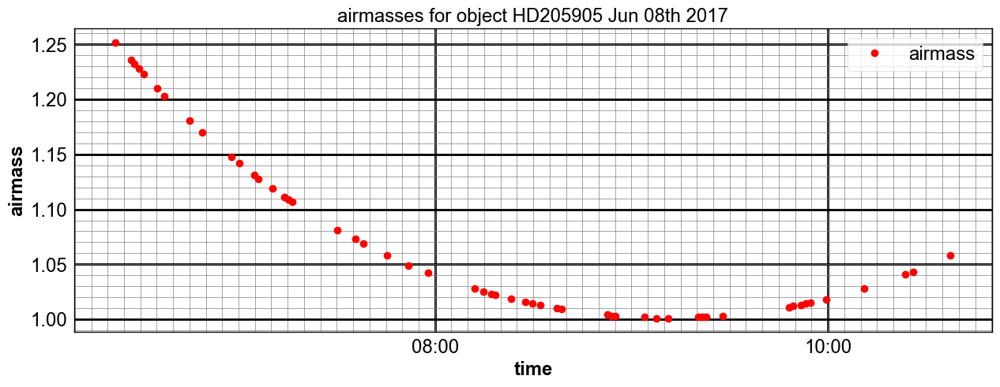

In [218]:
fig=plt.figure(figsize=(15,5))

ax=fig.add_subplot(1,1,1)
ax.plot_date(all_dt, all_airmass,marker='o',color='red',lw=0,label='airmass',linewidth=3)
#ax.plot_date(all_dt, am,marker='.',color='blue',lw=0,label='relative airmass',linewidth=3)

#ax.set_ylim(0.,2)

date_range = all_dt[NDATA-1] - all_dt[0]

if date_range > datetime.timedelta(days = 1):
    ax.xaxis.set_major_locator(mdates.DayLocator(bymonthday=range(1,32), interval=1))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    ax.get_xaxis().set_minor_locator(mdates.HourLocator(byhour=range(0,24,2)))
    #ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
else:
    ax.xaxis.set_major_locator(mdates.HourLocator(byhour=range(0,24,2)))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
    #ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    ax.get_xaxis().set_minor_locator(mdates.MinuteLocator(byminute=range(0,60,5)))
    
ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())

ax.grid(b=True, which='major', color='k', linewidth=2.0)
ax.grid(b=True, which='minor', color='grey', linewidth=0.5)
ax.set_ylabel('airmass')
ax.set_xlabel('time')


title='airmasses for object {}'.format(object_name)

plt.title(title)
plt.legend(loc='best')

figfilename=os.path.join(dir_top_images,'airmass_vs_time.pdf')
fig.savefig(figfilename)

## Dispersers

In [219]:
ListOfDisperserNames=['Ron200', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg']

## Show Spectra
-----------------------

In [307]:
%%cython
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import math as m
import os

from matplotlib.backends.backend_pdf import PdfPages
    
def ShowSpectrawithBG(all_spectra,all_totspectra,all_wl,all_titles,object_name,all_filt,all_filt1,dir_top_img):
    """
    ShowSpectra: Show the raw images without background subtraction
    ==============
    """
    NBSPEC=len(all_spectra)
    NBIMGPERROW=2
    MAXIMGROW=max(2,m.ceil(NBSPEC/NBIMGPERROW))
    #MAXIMGROW=int(MAXIMGROW)
        
    
     # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    
    figfilename=os.path.join(dir_top_img,'intput_calibrated_spectra_withBG.pdf')
    pp = PdfPages(figfilename) # create a pdf file
    
    title='Calibrated spectra for {}'.format(object_name)
         
    thex0 = []  # container of central position   
        
    
    for index in np.arange(0,NBSPEC):
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20,fontweight='bold')
            
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        
        spectrum=all_spectra[index]
        spectrum2=all_totspectra[index]
       
        wl=all_wl[index]
        axarr[iy,ix].plot(wl,spectrum,'r-',lw=2,label='data')
        axarr[iy,ix].plot(wl,spectrum2,'k:',lw=2,label='data with BG')
        
        
        max_y_to_plot=spectrum[:].max()*1.2
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
        
        axarr[iy,ix].text(0.,max_y_to_plot*1.1/1.2, all_filt[index],verticalalignment='top', horizontalalignment='left',color='blue',fontweight='bold', fontsize=20)
       
        axarr[iy,ix].set_title(all_titles[index])
        #axarr[iy,ix].set_title(all_filt[index])
        axarr[iy,ix].set_xlabel("wavelength (nm)")
        
        axarr[iy,ix].get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        axarr[iy,ix].get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        axarr[iy,ix].grid(b=True, which='major', color='k', linewidth=2.0)
        axarr[iy,ix].grid(b=True, which='minor', color='grey', linewidth=0.5)
      
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
        
          
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()
    

In [306]:
%%cython
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import math as m
import os,re

from matplotlib.backends.backend_pdf import PdfPages
 
#NormSpecRange= [790,810] # range where to normalize

NormSpecRange2= [790,810] # range where to normalize
NormSpecRange1= [590,610] # range where to normalize

def ShowSpectra(all_spectra,all_wl,all_titles,object_name,all_filt,all_filt1,dir_top_img,sim_data):
    """
    ShowSpectra: Show the raw images without background subtraction
    ==============
    """
    NBSPEC=len(all_spectra)
    NBIMGPERROW=2
    MAXIMGROW=max(2,m.ceil(NBSPEC/NBIMGPERROW))
    #MAXIMGROW=int(MAXIMGROW)
        

    calibdatasimfactor = []    
        
        
     # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    
    figfilename=os.path.join(dir_top_img,'intput_calibrated_spectra.pdf')
    pp = PdfPages(figfilename) # create a pdf file
    
    title='Calibrated spectra for {}'.format(object_name)
         
    thex0 = []  # container of central position   
    wl_sim=sim_data[0]/10.
    
    for index in np.arange(0,NBSPEC):
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20,fontweight='bold')
 
  


        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        wl=all_wl[index]  # wavelength in data
        
        spectrum=all_spectra[index]   # data
        
        #maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange[0],wl<NormSpecRange[1]))]) # max in data in selected wl range
        
        
        spectrum_sim=sim_data[index+1] # sim
        
        if re.search('.* RG175.*',all_filt1[index]):
            print 'found RG175 : ',all_filt1[index]
            maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange2[0],wl<NormSpecRange2[1]))]) # max in data in selected wl range
            maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange2[0],wl_sim<NormSpecRange2[1]))]) # max in sim in selected wl range
        elif all_filt1[index]=='RG175':
            print 'found RG175 : ',all_filt1[index]
            maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange2[0],wl<NormSpecRange2[1]))]) # max in data in selected wl range
            maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange2[0],wl_sim<NormSpecRange2[1]))]) # max in sim in selected wl range
        elif re.search('.* FGB37.*',all_filt1[index]):
            print 'found FGB37 : ',all_filt1[index]
            maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange1[0],wl<NormSpecRange1[1]))]) # max in data in selected wl range
            maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange1[0],wl_sim<NormSpecRange1[1]))]) # max in sim in selected wl range
        elif all_filt1[index]=='FGB37':
            print 'found FGB37 : ',all_filt1[index]
            maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange1[0],wl<NormSpecRange1[1]))]) # max in data in selected wl range
            maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange1[0],wl_sim<NormSpecRange1[1]))]) # max in sim in selected wl range
        else:
            print 'Filter Not found ::', all_filt1[index]
            maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange2[0],wl<NormSpecRange2[1]))]) # max in data in selected wl range
            maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange2[0],wl_sim<NormSpecRange2[1]))]) # max in sim in selected wl range
        
        #maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange[0],wl_sim<NormSpecRange[1]))]) # max in sim in selected wl range
        
        calibfactor=maxdata_in_range/maxsim_in_range   # calib factor data/sim in wl range
        
        calibdatasimfactor.append(calibfactor) # for later analysis
        
       
        axarr[iy,ix].plot(wl,spectrum,'r-',lw=2,label='data') # plot data
        
        
        spectrum_sim=spectrum_sim*calibfactor  # renormalize the sim to data units
        
        axarr[iy,ix].plot(wl_sim,spectrum_sim,'b-',lw=2,label='sim')
        
        max_y_to_plot=spectrum[:].max()*1.4
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
       
        axarr[iy,ix].set_xlim(0.,1200.)
        axarr[iy,ix].text(0.,max_y_to_plot*1.1/1.4, all_filt[index],verticalalignment='top', horizontalalignment='left',color='blue',fontweight='bold', fontsize=20)
       
        axarr[iy,ix].set_title(all_titles[index])
        #axarr[iy,ix].set_title(all_filt[index])
        axarr[iy,ix].set_xlabel("wavelength (nm)")
        
        axarr[iy,ix].get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        axarr[iy,ix].get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        axarr[iy,ix].grid(b=True, which='major', color='k', linewidth=2.0)
        axarr[iy,ix].grid(b=True, which='minor', color='grey', linewidth=0.5)
      
        axarr[iy,ix].legend()
        
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
            
                
          
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()
    return np.array(calibdatasimfactor)
    

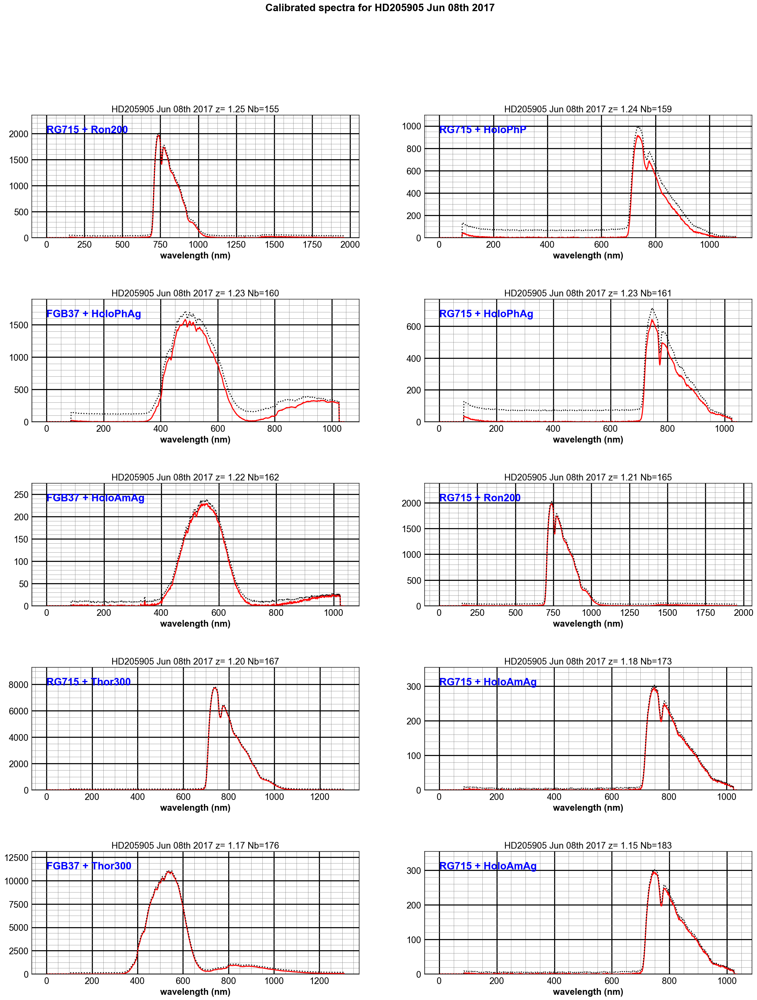

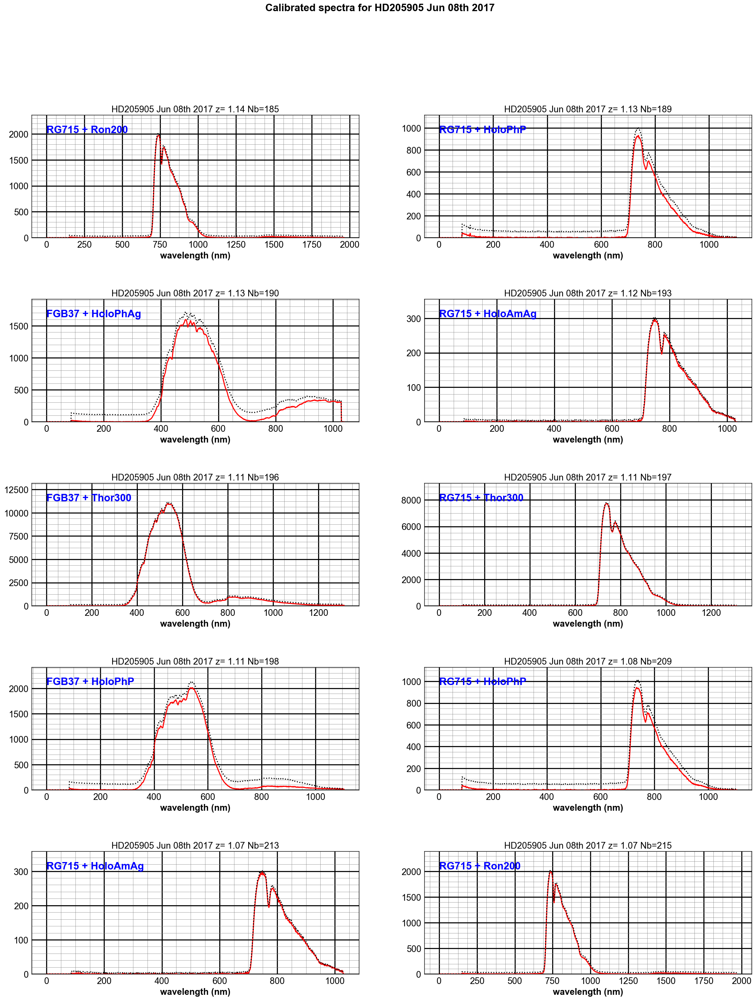

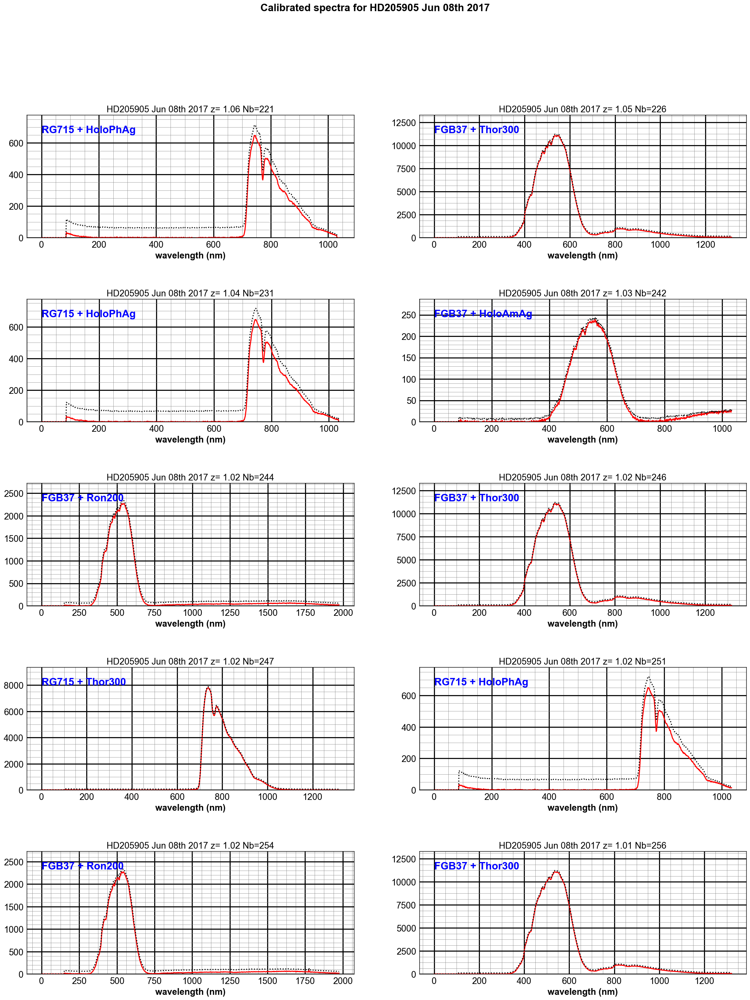

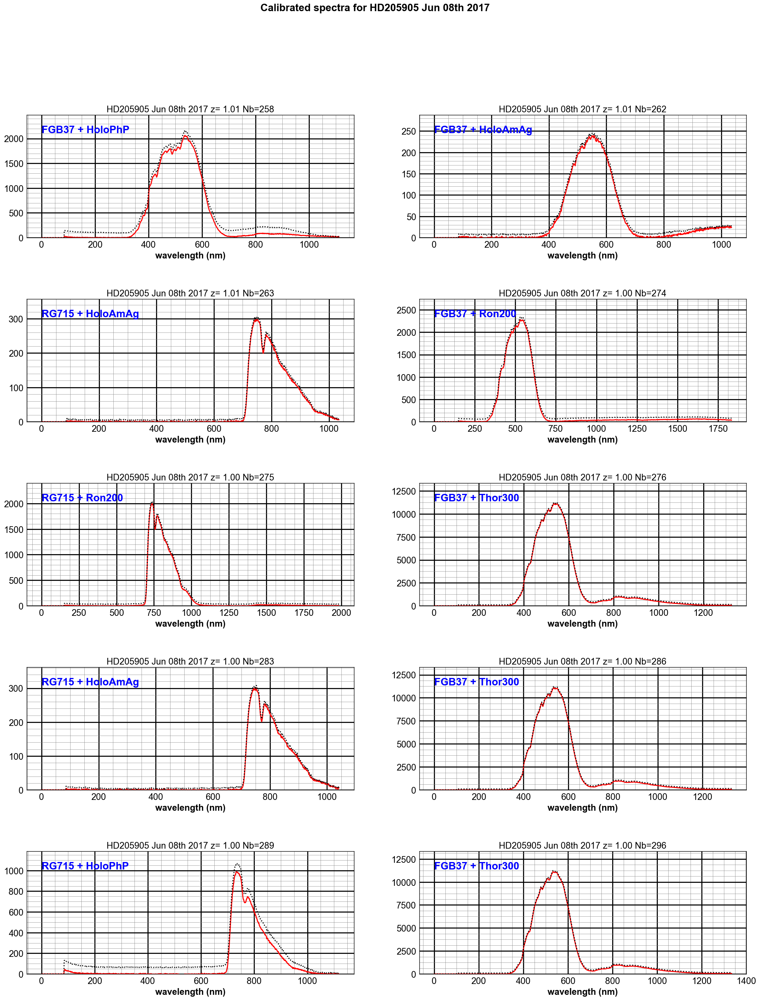

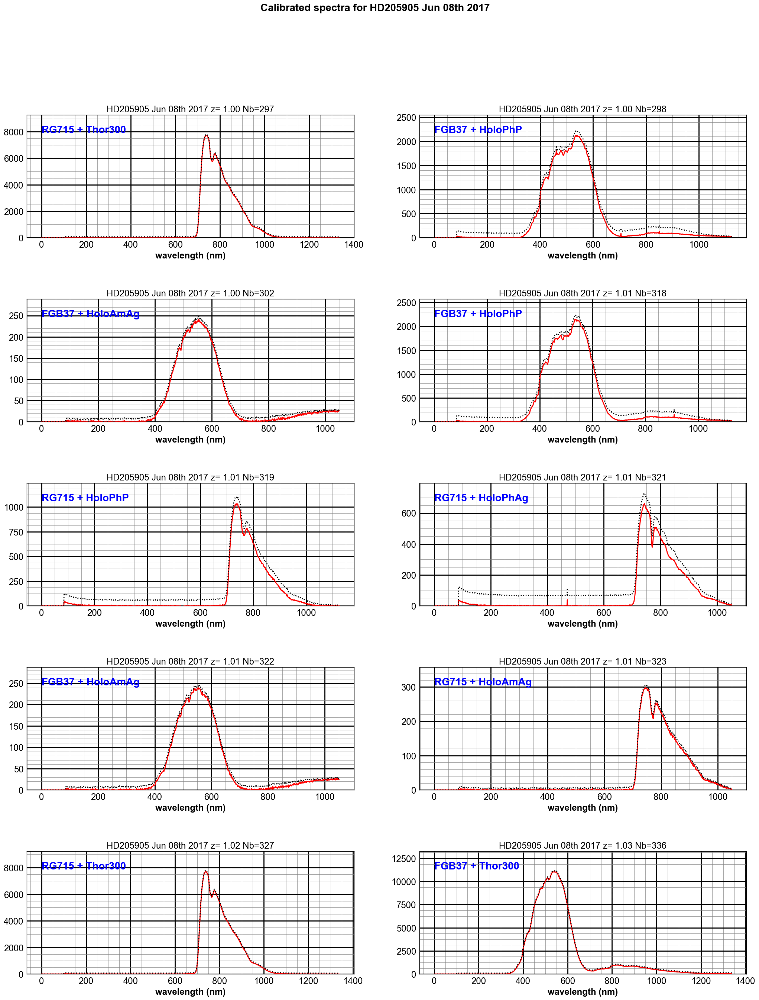

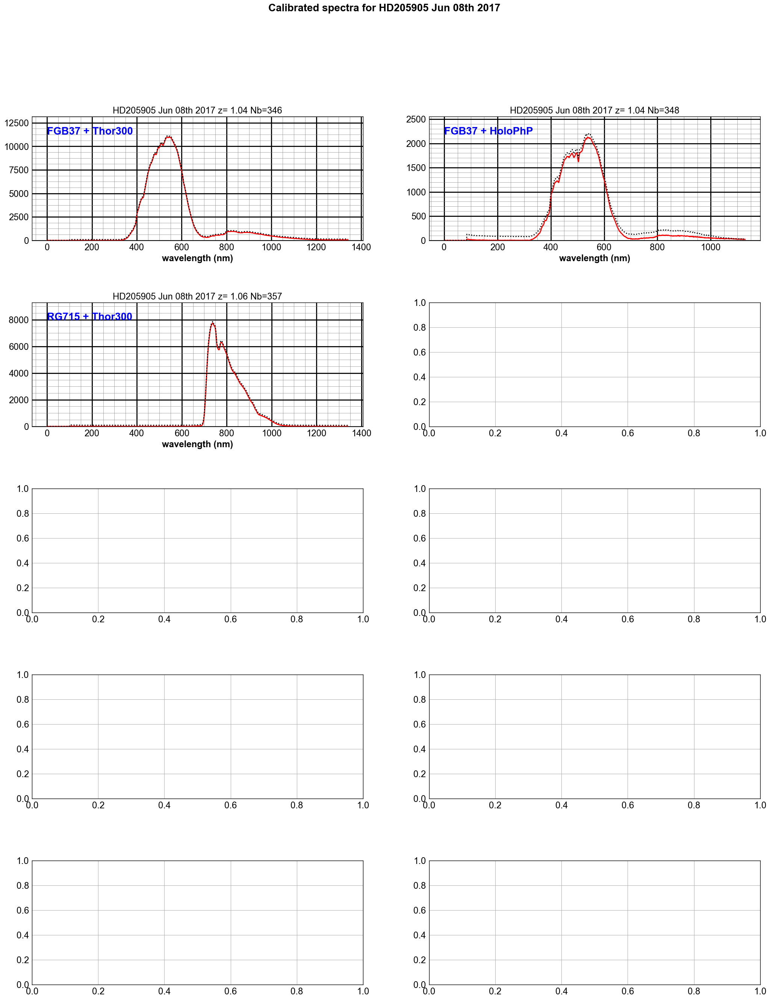

In [308]:
ShowSpectrawithBG(all_rightspectra_data,all_totrightspectra_data,all_rightspectra_wl,all_titles,object_name,all_filt,all_filt1,dir_top_images)

### Work only on right spectra

Filter Not found :: RG715
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
Filter Not found :: RG715
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
Filter Not found :: RG715
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
Filter Not found :: RG715
Filter Not found :: RG715
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
found FGB37 :  FGB37
found FGB37 :  FGB37
Filter Not found :: RG715
Filter Not found :: RG715
found FGB37 :  FGB37
found FGB37 :  FGB37
found FGB37 :  FGB37
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
fou

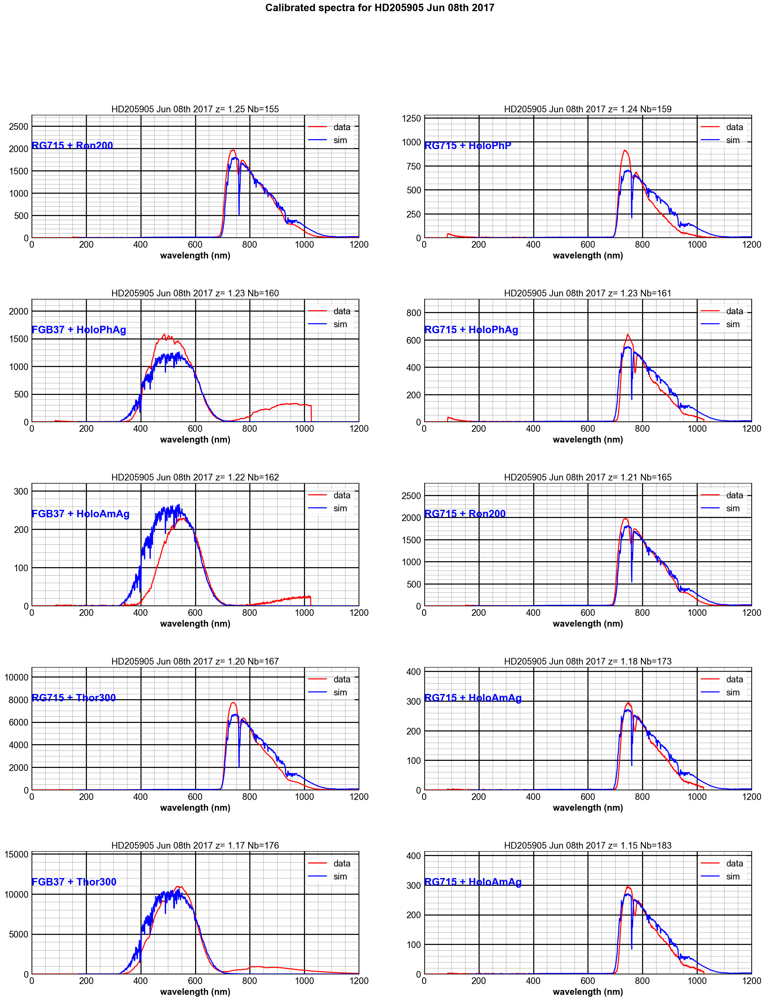

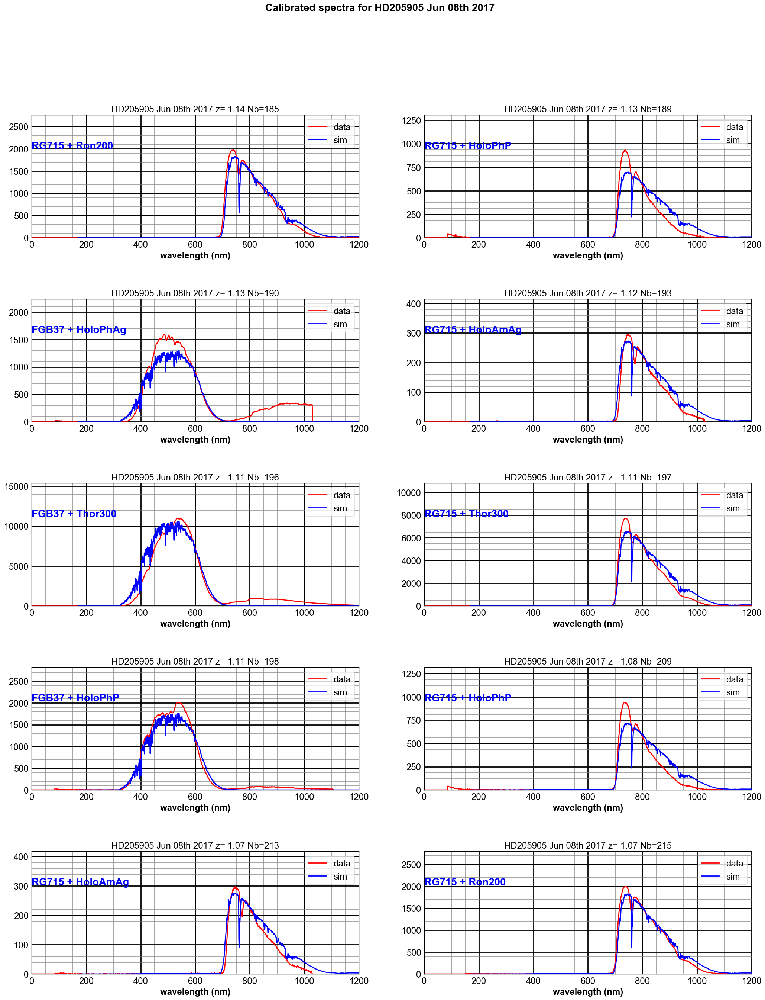

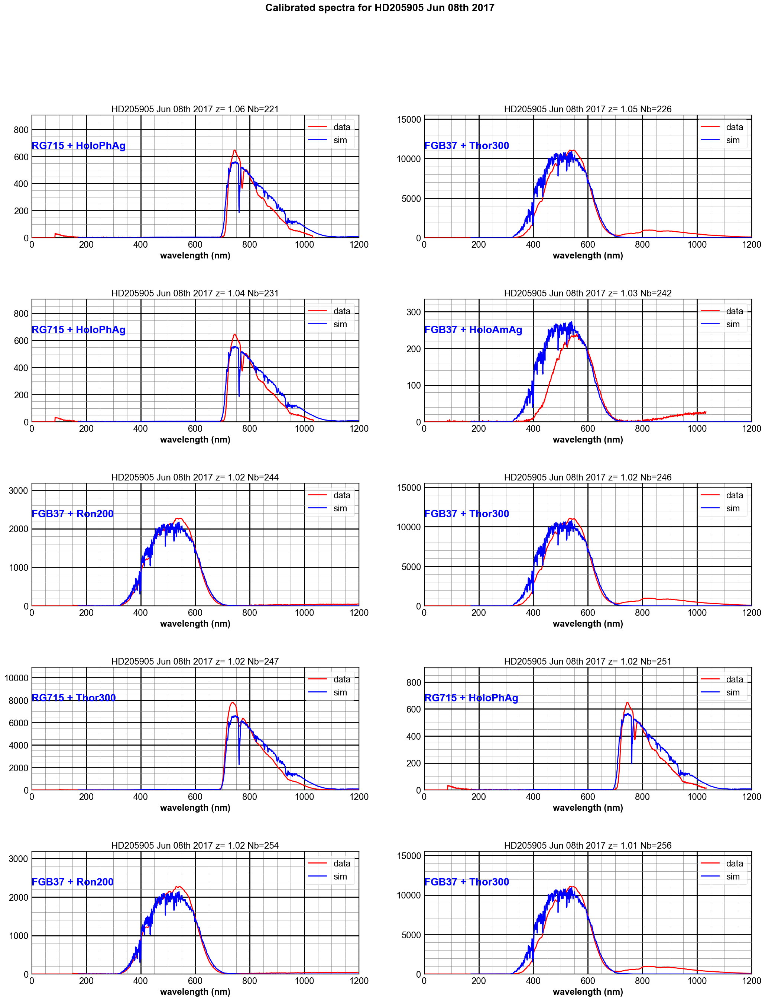

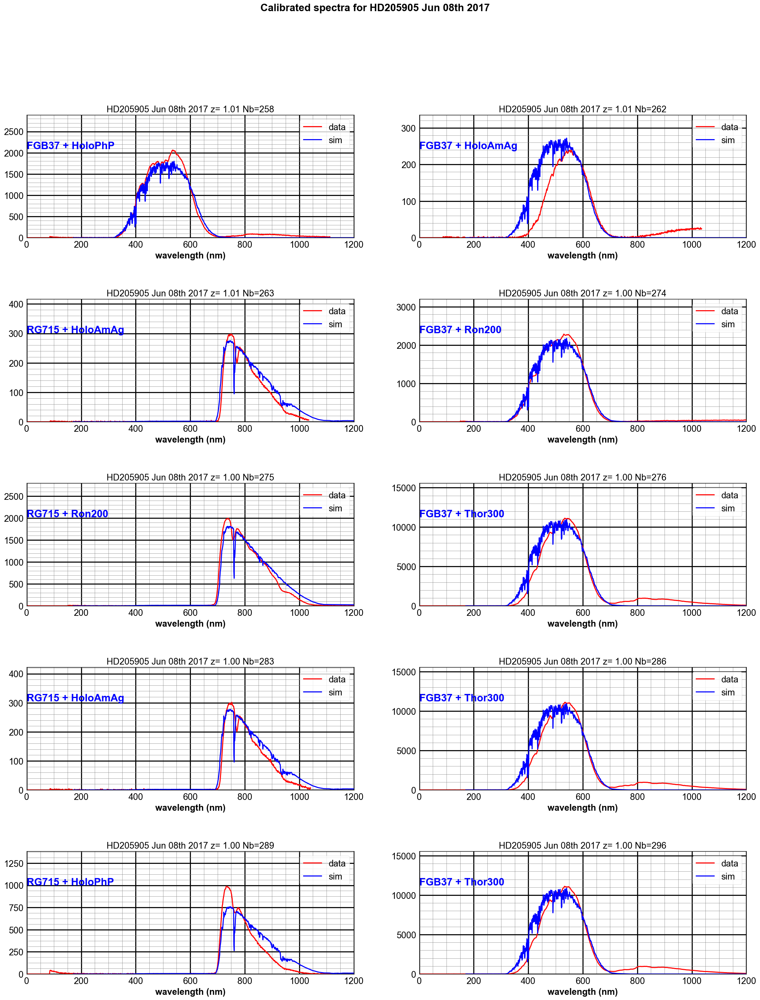

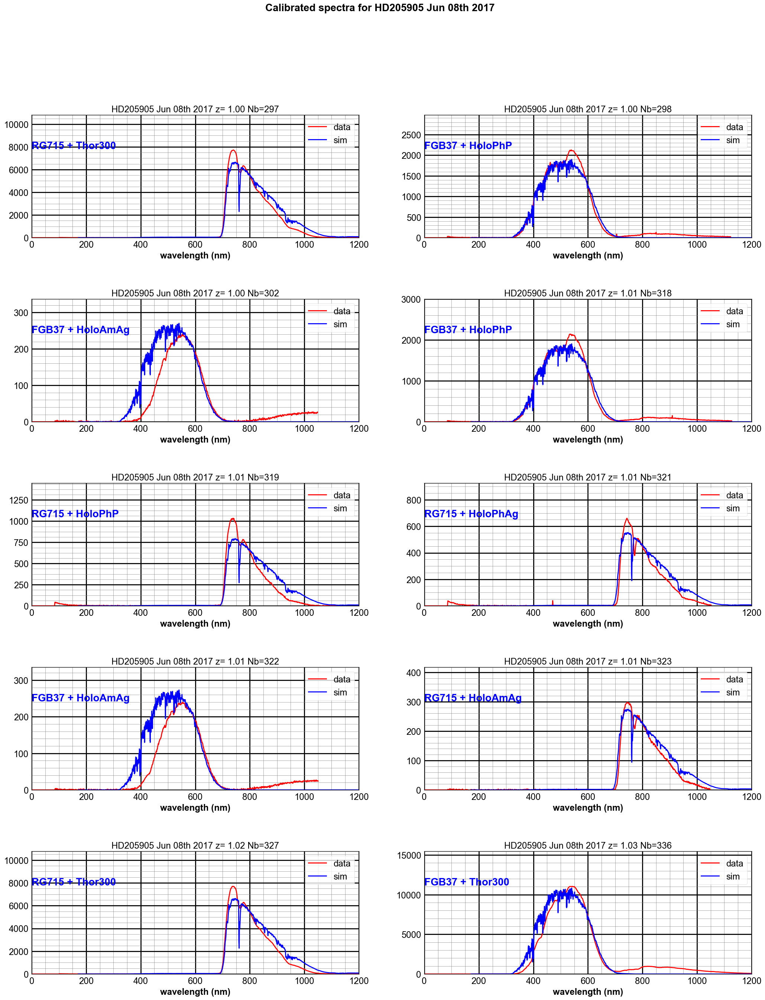

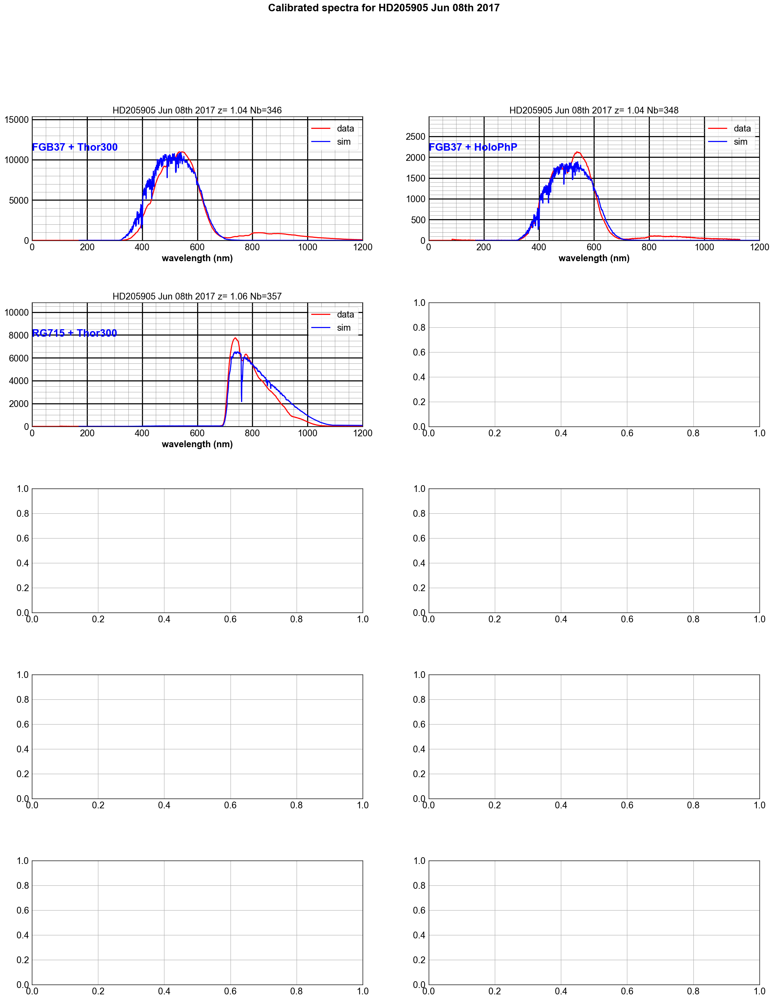

In [309]:
all_calibdatasimfactors=ShowSpectra(all_rightspectra_data,all_rightspectra_wl,all_titles,object_name,all_filt,all_filt1,dir_top_images,simspectra_data)

# Start the analysis

## Few definition

In [310]:
wl_O2Aline=759.37      # Balmer Lines
wl_O2Bline=686.719
wl_Haline=656.281 
wl_Hbline=486.134
wl_Hgline=434.047 
wl_Hdline=410.175
wl_Heline=397.0

In [311]:
def ShowOneSpectrum(sel):
    """
    ShowOneSpectrum
    ================
    """

    # get sim spectrum
    wl_sim=simspectra_data[0]/10.
    spectrum_sim=simspectra_data[sel+1]*all_calibdatasimfactors[sel] # sim
    
    
    # get the data
    thespectrum=all_rightspectra_data[sel]
    thewl=all_rightspectra_wl[sel]
    
    
    
    ymin=thespectrum.min()
    ymax=thespectrum.max()*1.1

    fig, ax = plt.subplots(1, 1, figsize=(15,8))


    ax.plot(thewl,thespectrum,'r-',lw=2,label='data')
    ax.plot(wl_sim,spectrum_sim,'b-',lw=2,label='sim')

    max_y_to_plot=thespectrum[:].max()*1.2
    ax.set_ylim(0.,max_y_to_plot)
    ax.text(0.,max_y_to_plot*1.1/1.2, all_filt[sel],verticalalignment='top', horizontalalignment='left',color='blue',fontweight='bold', fontsize=20)

    ax.set_title(all_titles[sel])
    ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    ax.grid(b=True, which='major', color='k', linewidth=2.0)
    ax.grid(b=True, which='minor', color='grey', linewidth=0.5)

    ax.plot([wl_O2Aline,wl_O2Aline],[ymin,ymax],'b-',label='$O_2(A)$',lw=1)
    ax.plot([wl_O2Bline,wl_O2Bline],[ymin,ymax],'b-',label='$O_2(B)$',lw=1)
    ax.plot([wl_Haline,wl_Haline],[ymin,ymax],'r-',label='$H_{alpha}$',lw=1)
    ax.plot([wl_Hbline,wl_Hbline],[ymin,ymax],'g-',label='$H_{beta}$',lw=1)
    ax.plot([wl_Hgline,wl_Hgline],[ymin,ymax],'c-',label='$H_{gamma}$',lw=1)
    ax.plot([wl_Hdline,wl_Hdline],[ymin,ymax],'k-',label='$H_{delta}$',lw=1)
    ax.plot([wl_Heline,wl_Heline],[ymin,ymax],'y-',label='$H_{delta}$',lw=1)

    ax.legend(loc=3,fontsize=20)
    ax.set_xlim(0,1100)
    ax.set_xlabel("$\lambda$ (nm)")
    
    figfilename=os.path.join(dir_top_images,'one_intput_calibrated_spectra.pdf')
    fig.savefig(figfilename)

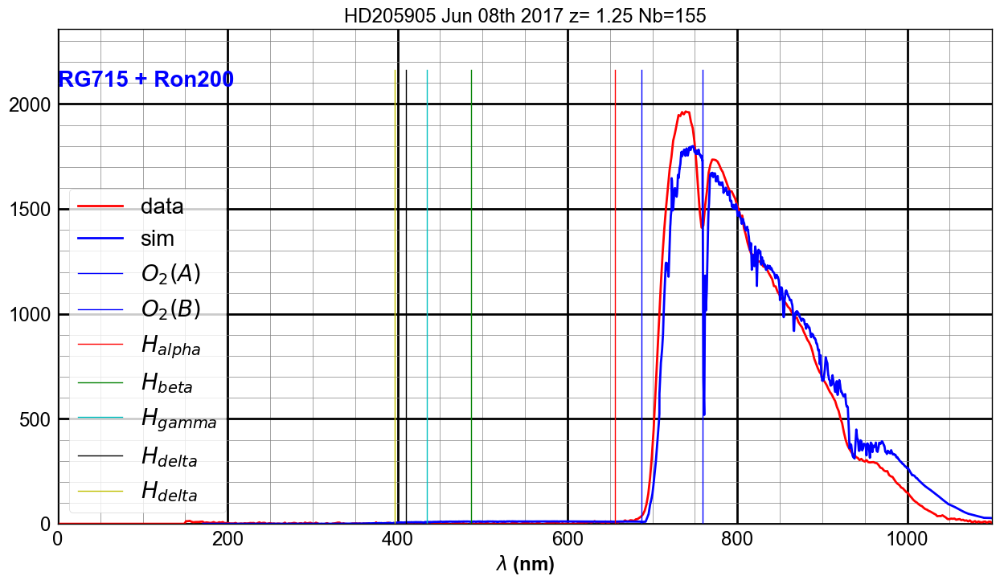

In [312]:
ShowOneSpectrum(0)

In [313]:
def ShowOneSpectrumNextFilt(sel):
    """
    ShowOneSpectrum
    ================
    """

    NBSPECTOPLOT=5
    
    the_spectra= []
    the_wl=[]
    the_max = []
    the_label= []
    
    for i in np.arange(NBSPECTOPLOT):

        the_spectrum=all_rightspectra_data[sel+i]
        thewl=all_rightspectra_wl[sel+i]
        theymin=the_spectrum.min()
        theymax=the_spectrum.max()
        thelabel=all_filt[sel+i]
        
        the_spectra.append(the_spectrum)
        the_wl.append(thewl)
        the_max.append(theymax)
        the_label.append(thelabel)

        
    fig, ax = plt.subplots(1, 1, figsize=(15,8))
    for i in np.arange(NBSPECTOPLOT):        
        ax.plot(the_wl[i],the_spectra[i],lw=3,label=the_label[i])

 
        
    max_y_to_plot=(np.array(the_max)).max()
    ymin=0
    ymax=max_y_to_plot
    ax.set_ylim(0.,max_y_to_plot)
    
    ax.set_title(all_titles[sel])
    ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    ax.grid(b=True, which='major', color='k', linewidth=2.0)
    ax.grid(b=True, which='minor', color='grey', linewidth=0.5)

    ax.plot([wl_O2Aline,wl_O2Aline],[ymin,ymax],'b:',label='$O_2(A)$',lw=3)
    ax.plot([wl_O2Bline,wl_O2Bline],[ymin,ymax],'b:',label='$O_2(B)$',lw=3)
    ax.plot([wl_Haline,wl_Haline],[ymin,ymax],'r:',label='$H_{alpha}$',lw=3)
    ax.plot([wl_Hbline,wl_Hbline],[ymin,ymax],'g:',label='$H_{beta}$',lw=3)
    ax.plot([wl_Hgline,wl_Hgline],[ymin,ymax],'c:',label='$H_{gamma}$',lw=3)
    ax.plot([wl_Hdline,wl_Hdline],[ymin,ymax],'k:',label='$H_{delta}$',lw=3)
    ax.plot([wl_Heline,wl_Heline],[ymin,ymax],'y:',label='$H_{delta}$',lw=3)

    ax.legend(loc='best',fontsize=20)
    ax.set_xlim(0,1100)
    ax.set_xlabel("$\lambda$ (nm)")
    
    figfilename=os.path.join(dir_top_images,'five_intput_calibrated_spectra.pdf')
    fig.savefig(figfilename)

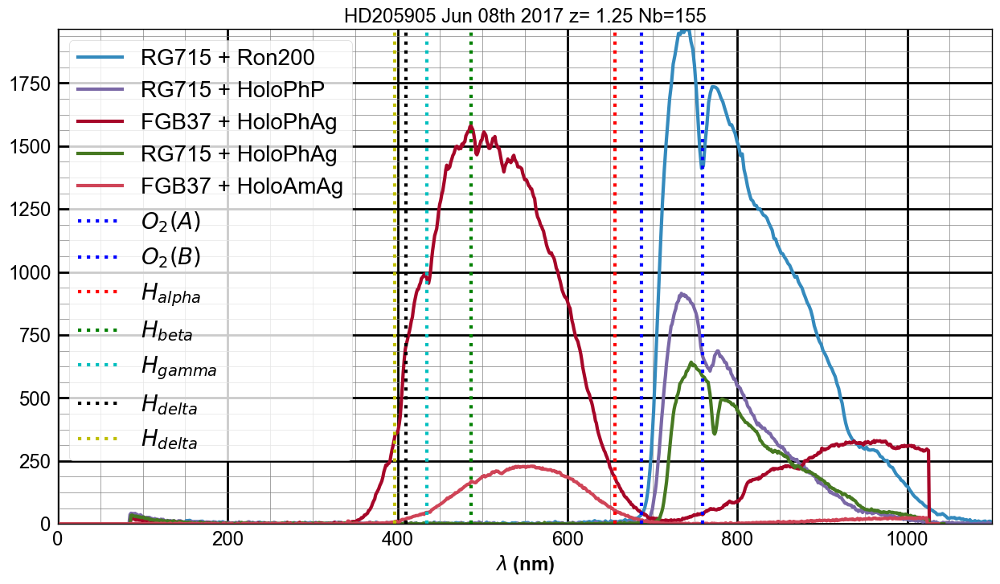

In [314]:
 ShowOneSpectrumNextFilt(0)

# Measurement of Equivalent Width
==============================================

In [315]:
def errorfill(x, y, yerr, color=None, alpha_fill=0.3, ax=None):
    ax = ax if ax is not None else plt.gca()
    if color is None:
        color = ax._get_lines.color_cycle.next()
    if np.isscalar(yerr) or len(yerr) == len(y):
        ymin = y - yerr
        ymax = y + yerr
    elif len(yerr) == 2:
        ymin, ymax = yerr
    ax.plot(x, y, color=color)
    ax.fill_between(x, ymax, ymin, color=color, alpha=alpha_fill)

## Select the spectrum under study

In [316]:
sel=0 # spectrum number

In [317]:
thespectrum=all_rightspectra_data[sel]
thewl=all_rightspectra_wl[sel]
thelabel=all_filt[sel]
thespecstaterr=all_rightspectra_data_staterr[sel]

In [318]:
wl_sim=simspectra_data[sel]/10.
spectrum_sim=simspectra_data[sel+1]*all_calibdatasimfactors[sel] # sim

## O2 absorption line

In [319]:
#O2WL1=732
#O2WL2=744
O2WL1=740
O2WL2=750
O2WL3=780
O2WL4=790

In [320]:
def ShowEquivalentWidth(wl,spec,wl1,wl2,wl3,wl4):
    """
    ShowEquivalentWidth : show how the equivalent width must be computed
    """
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    plt.figure()
    plt.plot(wl_cut,spec_cut)
    plt.plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    plt.plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    
    # continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    z_cont_fit=np.polyfit(x_cont, y_cont,1)
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    plt.plot(x_cont,y_cont,'o')
    
    plt.plot(fit_line_x,fit_line_y,'g--',lw=1)
    
    plt.grid(True)
    plt.title('Equivalent width computation')
    
    # compute the ratio spectrum/continuum
    full_continum=pol_cont_fit(wl_cut)    
    ratio=spec_cut/full_continum
    
    plt.figure()
    plt.plot(wl_cut,ratio)
    plt.plot([wl2,wl2],[0,1.2],'k-.',lw=2)
    plt.plot([wl3,wl3],[0,1.2],'k-.',lw=2)
    plt.grid(True)
    
    
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width
    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum()
    
    
    return equivalent_width

In [321]:

import numpy.core.numeric as NX
from numpy.core import isscalar, abs, finfo, atleast_1d, hstack, dot
from numpy.lib.twodim_base import diag, vander
from numpy.lib.function_base import trim_zeros, sort_complex
from numpy.lib.type_check import iscomplex, real, imag
from numpy.linalg import eigvals, lstsq, inv


In [322]:
def polyfit(x, y, deg, rcond=None, full=False, w=None, cov=False):
    """
    Least squares polynomial fit.
    Fit a polynomial ``p(x) = p[0] * x**deg + ... + p[deg]`` of degree `deg`
    to points `(x, y)`. Returns a vector of coefficients `p` that minimises
    the squared error.
    Parameters
    ----------
    x : array_like, shape (M,)
        x-coordinates of the M sample points ``(x[i], y[i])``.
    y : array_like, shape (M,) or (M, K)
        y-coordinates of the sample points. Several data sets of sample
        points sharing the same x-coordinates can be fitted at once by
        passing in a 2D-array that contains one dataset per column.
    deg : int
        Degree of the fitting polynomial
    rcond : float, optional
        Relative condition number of the fit. Singular values smaller than
        this relative to the largest singular value will be ignored. The
        default value is len(x)*eps, where eps is the relative precision of
        the float type, about 2e-16 in most cases.
    full : bool, optional
        Switch determining nature of return value. When it is False (the
        default) just the coefficients are returned, when True diagnostic
        information from the singular value decomposition is also returned.
    w : array_like, shape (M,), optional
        weights to apply to the y-coordinates of the sample points.
    cov : bool, optional
        Return the estimate and the covariance matrix of the estimate
        If full is True, then cov is not returned.
    Returns
    -------
    p : ndarray, shape (M,) or (M, K)
        Polynomial coefficients, highest power first.  If `y` was 2-D, the
        coefficients for `k`-th data set are in ``p[:,k]``.
    residuals, rank, singular_values, rcond :
        Present only if `full` = True.  Residuals of the least-squares fit,
        the effective rank of the scaled Vandermonde coefficient matrix,
        its singular values, and the specified value of `rcond`. For more
        details, see `linalg.lstsq`.
    V : ndarray, shape (M,M) or (M,M,K)
        Present only if `full` = False and `cov`=True.  The covariance
        matrix of the polynomial coefficient estimates.  The diagonal of
        this matrix are the variance estimates for each coefficient.  If y
        is a 2-D array, then the covariance matrix for the `k`-th data set
        are in ``V[:,:,k]``
    Warns
    -----
    RankWarning
        The rank of the coefficient matrix in the least-squares fit is
        deficient. The warning is only raised if `full` = False.
        The warnings can be turned off by
        >>> import warnings
        >>> warnings.simplefilter('ignore', np.RankWarning)
    See Also
    --------
    polyval : Computes polynomial values.
    linalg.lstsq : Computes a least-squares fit.
    scipy.interpolate.UnivariateSpline : Computes spline fits.
    Notes
    -----
    The solution minimizes the squared error
    .. math ::
        E = \\sum_{j=0}^k |p(x_j) - y_j|^2
    in the equations::
        x[0]**n * p[0] + ... + x[0] * p[n-1] + p[n] = y[0]
        x[1]**n * p[0] + ... + x[1] * p[n-1] + p[n] = y[1]
        ...
        x[k]**n * p[0] + ... + x[k] * p[n-1] + p[n] = y[k]
    The coefficient matrix of the coefficients `p` is a Vandermonde matrix.
    `polyfit` issues a `RankWarning` when the least-squares fit is badly
    conditioned. This implies that the best fit is not well-defined due
    to numerical error. The results may be improved by lowering the polynomial
    degree or by replacing `x` by `x` - `x`.mean(). The `rcond` parameter
    can also be set to a value smaller than its default, but the resulting
    fit may be spurious: including contributions from the small singular
    values can add numerical noise to the result.
    Note that fitting polynomial coefficients is inherently badly conditioned
    when the degree of the polynomial is large or the interval of sample points
    is badly centered. The quality of the fit should always be checked in these
    cases. When polynomial fits are not satisfactory, splines may be a good
    alternative.
    References
    ----------
    .. [1] Wikipedia, "Curve fitting",
           http://en.wikipedia.org/wiki/Curve_fitting
    .. [2] Wikipedia, "Polynomial interpolation",
           http://en.wikipedia.org/wiki/Polynomial_interpolation
    Examples
    --------
    >>> x = np.array([0.0, 1.0, 2.0, 3.0,  4.0,  5.0])
    >>> y = np.array([0.0, 0.8, 0.9, 0.1, -0.8, -1.0])
    >>> z = np.polyfit(x, y, 3)
    >>> z
    array([ 0.08703704, -0.81349206,  1.69312169, -0.03968254])
    It is convenient to use `poly1d` objects for dealing with polynomials:
    >>> p = np.poly1d(z)
    >>> p(0.5)
    0.6143849206349179
    >>> p(3.5)
    -0.34732142857143039
    >>> p(10)
    22.579365079365115
    High-order polynomials may oscillate wildly:
    >>> p30 = np.poly1d(np.polyfit(x, y, 30))
    /... RankWarning: Polyfit may be poorly conditioned...
    >>> p30(4)
    -0.80000000000000204
    >>> p30(5)
    -0.99999999999999445
    >>> p30(4.5)
    -0.10547061179440398
    Illustration:
    >>> import matplotlib.pyplot as plt
    >>> xp = np.linspace(-2, 6, 100)
    >>> _ = plt.plot(x, y, '.', xp, p(xp), '-', xp, p30(xp), '--')
    >>> plt.ylim(-2,2)
    (-2, 2)
    >>> plt.show()
    """
    order = int(deg) + 1
    x = NX.asarray(x) + 0.0
    y = NX.asarray(y) + 0.0

    # check arguments.
    if deg < 0:
        raise ValueError("expected deg >= 0")
    if x.ndim != 1:
        raise TypeError("expected 1D vector for x")
    if x.size == 0:
        raise TypeError("expected non-empty vector for x")
    if y.ndim < 1 or y.ndim > 2:
        raise TypeError("expected 1D or 2D array for y")
    if x.shape[0] != y.shape[0]:
        raise TypeError("expected x and y to have same length")

    # set rcond
    if rcond is None:
        rcond = len(x)*finfo(x.dtype).eps

    # set up least squares equation for powers of x
    lhs = vander(x, order)
    rhs = y

    # apply weighting
    if w is not None:
        w = NX.asarray(w) + 0.0
        if w.ndim != 1:
            raise TypeError("expected a 1-d array for weights")
        if w.shape[0] != y.shape[0]:
            raise TypeError("expected w and y to have the same length")
        lhs *= w[:, NX.newaxis]
        if rhs.ndim == 2:
            rhs *= w[:, NX.newaxis]
        else:
            rhs *= w

    # scale lhs to improve condition number and solve
    scale = NX.sqrt((lhs*lhs).sum(axis=0))
    lhs /= scale
    
    
    print 'MyPolyfit lhs      =   ', lhs
    
    rcond =len(x)*2e-16
    
    c, resids, rank, s = lstsq(lhs, rhs, rcond)
    c = (c.T/scale).T  # broadcast scale coefficients
    
    
    print 'MyPolyfit  c, resids, rank, s   =  ',   c, resids, rank, s
    
    
    

    # warn on rank reduction, which indicates an ill conditioned matrix
    if rank != order and not full:
        msg = "Polyfit may be poorly conditioned"
        warnings.warn(msg, RankWarning)

    if full:
        return c, resids, rank, s, rcond
    elif cov:
        Vbase = inv(dot(lhs.T, lhs))
        Vbase /= NX.outer(scale, scale)
        # Some literature ignores the extra -2.0 factor in the denominator, but
        #  it is included here because the covariance of Multivariate Student-T
        #  (which is implied by a Bayesian uncertainty analysis) includes it.
        #  Plus, it gives a slightly more conservative estimate of uncertainty.
        fac = resids / (len(x) - order - 2.0)
        if y.ndim == 1:
            return c, Vbase * fac
        else:
            return c, Vbase[:,:, NX.newaxis] * fac
    else:
        return c

In [323]:
def ShowEquivalentWidthwthStatErr(wl,spec,specerr,wl1,wl2,wl3,wl4,ndeg=2):
    """
    ******************************************************************************
    ShowEquivalentWidthwthStatErr : show how the equivalent width must be computed
    
    - with errors
    - with non linear method
    
    *********************************************************************************
    """
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    spec_cut_err=specerr[selected_indexes]
    
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    #############
    ### Figure 1
    #############
    plt.figure()
    
    plt.plot(wl_cut,spec_cut,'b-')
    plt.errorbar(wl_cut,spec_cut,yerr=spec_cut_err,color='red',fmt='.')
    
    # vertical bars
    plt.plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    plt.plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    
    # continuum fit
    #------------------
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))

    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    y_cont_err=specerr[continuum_indexes]
    y_w=1./y_cont_err
    y_w[np.where(y_cont==0)]=0. # erase the empty bins
   
    
    popt_p , pcov_p= np.polyfit(x_cont, y_cont,ndeg,w=y_w,full=False,cov=True,rcond=2.0e-16*len(x_cont)) #rcond mandatory    
    z_cont_fit=popt_p
      

    pol_cont_fit=np.poly1d(z_cont_fit)
    
    # fitted curve with its error
    #---------------------------------
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    fit_line_y_err = []
    for thex in fit_line_x:
        dfdx = [ thex**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        fit_line_y_err.append(propagated_error)
    fit_line_y_err=np.array(fit_line_y_err)
    
    errorfill(fit_line_x,fit_line_y,fit_line_y_err, color='grey',ax=plt)
    plt.errorbar(x_cont,y_cont,yerr=y_cont_err,fmt='.',color='blue')
    plt.plot(fit_line_x,fit_line_y,'g--',lw=1)
    plt.xlabel(' wavelength (nm)')
    plt.ylabel(' ADU per second')
    
    plt.grid(True)
    plt.title('Equivalent width computation')
    
    # compute the ratio spectrum/continuum
    #-------------------------------------
    full_continum=pol_cont_fit(wl_cut)    
    
    full_continum_err= []
    for wl in wl_cut:
        dfdx = [ wl**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        full_continum_err.append(propagated_error)
    full_continum_err=np.array(full_continum_err)
    
    
    ratio=spec_cut/full_continum
    # error not correlated    
    ratio_err=ratio*np.sqrt( (spec_cut_err/spec_cut)**2+ (full_continum_err/full_continum)**2)
    
    
    
    
    ###################
    ### Second figure
    #################
    plt.figure()
    plt.plot(wl_cut,ratio,lw=2,color='blue')
    plt.errorbar(wl_cut,ratio,yerr=ratio_err,fmt='.',lw=2,color='red')
    plt.plot([wl2,wl2],[0,1.2],'k-.',lw=2)
    plt.plot([wl3,wl3],[0,1.2],'k-.',lw=2)
    plt.grid(True)
    plt.ylim(0.8*ratio.min(),1.2*ratio.max())
    plt.xlabel(' wavelength (nm)')
    plt.ylabel(' no unit')
    
    # Compute now the equavalent width
    #--------------------------------
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin in wavelength

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width and its error
    #-------------------------------------------------
    absorption_band=wl_bin_size*(1-ratio)
    absorption_band_error=wl_bin_size*ratio_err
    
    equivalent_width= absorption_band.sum()
    
    # quadratic sum of errors for each wl bin
    equivalend_width_error=np.sqrt((absorption_band_error*absorption_band_error).sum() )
    
    return equivalent_width,equivalend_width_error

In [324]:
def ShowEquivalentWidthNonLinear(wl,spec,wl1,wl2,wl3,wl4,ndeg=2):
    """
    ShowEquivalentWidthNonLinear : show how the equivalent width must be computed
    Do not use stats, for simulation by exammple
    """
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
   
    
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    plt.figure()
    plt.plot(wl_cut,spec_cut,'r-')
    plt.plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    plt.plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    
    # continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    z_cont_fit=np.polyfit(x_cont, y_cont,ndeg,rcond=2.0e-16*len(x_cont))
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    plt.plot(x_cont,y_cont,marker='.',color='blue',lw=0)
    plt.plot(fit_line_x,fit_line_y,'g--',lw=2)
    
    plt.grid(True)
    plt.xlabel(' wavelength (nm)')
    plt.ylabel(' ADU per second')
    plt.title('Equivalent width computation')
    
    # compute the ratio spectrum/continuum
    full_continum=pol_cont_fit(wl_cut)    
    ratio=spec_cut/full_continum
    
    plt.figure()
    plt.plot(wl_cut,ratio,'b-')
    plt.plot([wl2,wl2],[0,1.2],'k-.',lw=2)
    plt.plot([wl3,wl3],[0,1.2],'k-.',lw=2)
    plt.grid(True)
    plt.xlabel(' wavelength (nm)')
    plt.ylabel(' No unit')
    plt.ylim(0.8*ratio.min(),1.2*ratio.max())
    
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width
    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum()
    
    
    return equivalent_width

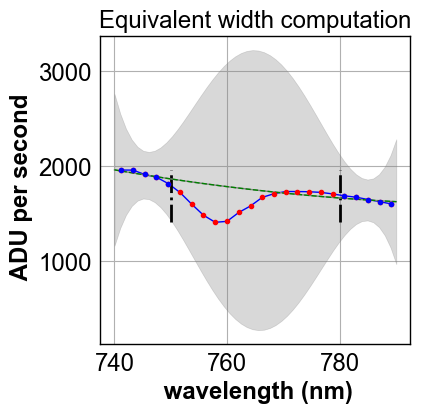

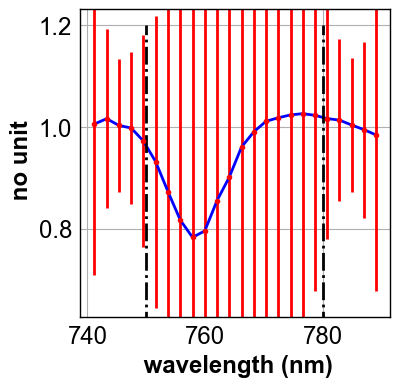

In [325]:
EQW_DATA, EQW_DATA_ERR= ShowEquivalentWidthwthStatErr(thewl,thespectrum,thespecstaterr,O2WL1,O2WL2,O2WL3,O2WL4)

In [326]:
print EQW_DATA, EQW_DATA_ERR

2.08005 4.68781178422


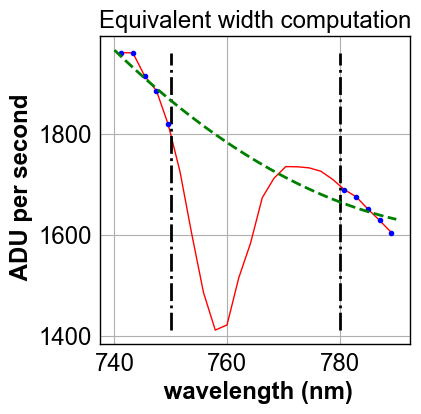

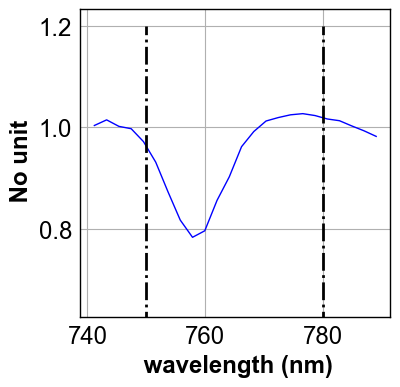

In [327]:
EQW_DATA = ShowEquivalentWidthNonLinear(thewl,thespectrum,O2WL1,O2WL2,O2WL3,O2WL4)

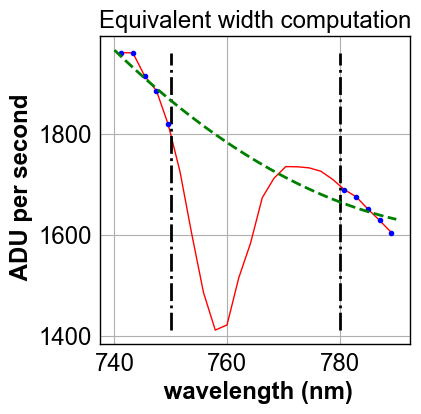

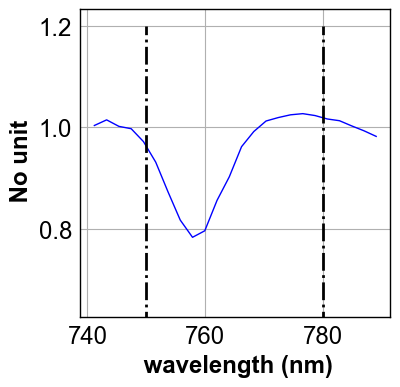

In [328]:
EQW_DATA = ShowEquivalentWidthNonLinear(thewl,thespectrum,O2WL1,O2WL2,O2WL3,O2WL4)

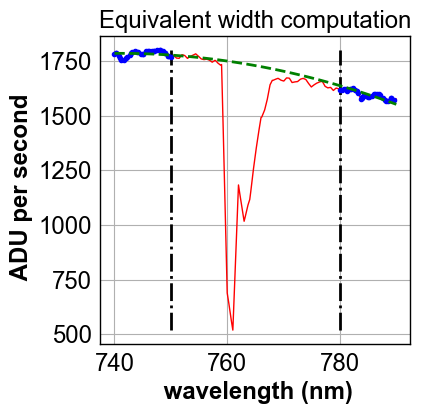

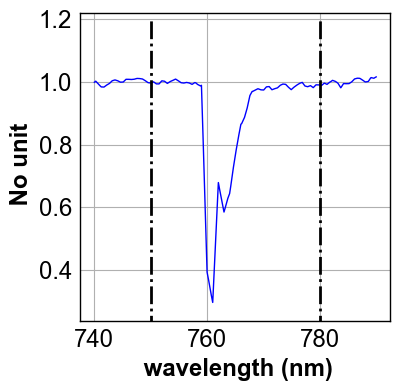

In [329]:
EQW_SIM = ShowEquivalentWidthNonLinear(wl_sim,spectrum_sim,O2WL1,O2WL2,O2WL3,O2WL4)

In [330]:
def ComputeEquivalentWidthNonLinear(wl,spec,wl1,wl2,wl3,wl4,ndeg=3):
    """
    ComputeEquivalentWidth : compute the equivalent width must be computed
    """
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    ymin=spec_cut.min()
    ymax=spec_cut.max()
     
    # continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    z_cont_fit=np.polyfit(x_cont, y_cont,ndeg,rcond=2.0e-16*len(x_cont))
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    
    # compute the ratio spectrum/continuum
    full_continum=pol_cont_fit(wl_cut)    
    ratio=spec_cut/full_continum
    

    # compute bin size in the band
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                                  
    
    # calculation of equivalent width    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum()    
    
    return equivalent_width

In [331]:
def ComputeEquivalentWidthNonLinearwthStatErr(wl,spec,specerr,wl1,wl2,wl3,wl4,ndeg=2):
    """
    ************************************************************************************
    ComputeEquivalentWidthNonLinearwthStatErr : compute the equivalent width must be computed
    
    *************************************************************************************
    """
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
    
    # extract
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    spec_cut_err=specerr[selected_indexes]
    
    
    ymin=spec_cut.min()
    ymax=spec_cut.max()
     
    # continuum fit
    #---------------
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    y_cont_err=specerr[continuum_indexes]
    
    y_w=1./y_cont_err
    y_w[np.where(y_cont==0)]=0. # erase the empty bins
   
    
    popt_p , pcov_p= np.polyfit(x_cont, y_cont,ndeg,w=y_w,full=False,cov=True,rcond=2.0e-16*len(x_cont)) #rcond mandatory    
    z_cont_fit=popt_p
    
    
    
    z_cont_fit=np.polyfit(x_cont, y_cont,ndeg)
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    fit_line_y_err = []
    for thex in fit_line_x:
        dfdx = [ thex**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        fit_line_y_err.append(propagated_error)
    fit_line_y_err=np.array(fit_line_y_err)
    
    
    # compute the ratio spectrum/continuum and its error
    full_continum=pol_cont_fit(wl_cut)    
    
    full_continum_err= []
    for wl in wl_cut:
        dfdx = [ wl**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        full_continum_err.append(propagated_error)
    full_continum_err=np.array(full_continum_err)
    
    
    ratio=spec_cut/full_continum
    # error not correlated    
    ratio_err=ratio*np.sqrt( (spec_cut_err/spec_cut)**2+ (full_continum_err/full_continum)**2)
    
    

    # compute bin size in the band
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
    
    
    
    # calculation of equivalent width    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum() 
    
    # return equavalent width error
    absorption_band_error=wl_bin_size*ratio_err
    # quadratic sum of errors for each wl bin
    equivalend_width_error=np.sqrt((absorption_band_error*absorption_band_error).sum() )
    
    return equivalent_width,equivalend_width_error

In [332]:
def ShowEquivalentWidth2(wl,spec,wl1,wl2,wl3,wl4,label='absortion line'):
    """
    ShowEquivalentWidth : show how the equivalent width must be computed
    """
    
    f, axarr = plt.subplots(1,2,figsize=(12,4))
    
    #############
    ## Figure 1
    ############
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    axarr[0].plot(wl_cut,spec_cut)
    axarr[0].plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    axarr[0].plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    # continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    z_cont_fit=np.polyfit(x_cont, y_cont,1)
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    
    axarr[0].plot(x_cont,y_cont,'o')
    axarr[0].plot(fit_line_x,fit_line_y,'g--',lw=1)
    
    axarr[0].grid(True)
    axarr[0].set_xlabel('$\lambda$ (nm)')
    
    # compute the ratio spectrum/continuum
    full_continum=pol_cont_fit(wl_cut)    
    ratio=spec_cut/full_continum
    
    # Figure 2
    #-----------
    axarr[1].plot(wl_cut,ratio)
    axarr[1].plot([wl2,wl2],[0,1.2],'r-.',lw=2)
    axarr[1].plot([wl3,wl3],[0,1.2],'r-.',lw=2)
    axarr[1].grid(True)
    axarr[1].ylim(0.8*ratio.min(),1.2*ratio.max())
    
    axarr[1].set_xlabel('$\lambda$ (nm)')
    
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width
    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum()
    
    
    title = 'Equivalent width computation for {}'.format(label)
    f.suptitle(title)
    
    return equivalent_width

In [333]:
def ShowEquivalentWidth2NonLinear(wl,spec,wl1,wl2,wl3,wl4,label='absortion line',ndeg=3):
    """
    ShowEquivalentWidth : show how the equivalent width must be computed
    """
    
    f, axarr = plt.subplots(1,2,figsize=(12,4))
    
    ################
    ## Figure 1
    #################
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    axarr[0].plot(wl_cut,spec_cut,marker='.',color='red')
    axarr[0].plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    axarr[0].plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    # continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    z_cont_fit=np.polyfit(x_cont, y_cont,ndeg)
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    
    axarr[0].plot(x_cont,y_cont,marker='.',color='blue',lw=0)
    axarr[0].plot(fit_line_x,fit_line_y,'g--',lw=2)
    
    axarr[0].grid(True)
    axarr[0].set_xlabel('$\lambda$ (nm)')
    axarr[0].set_ylabel('ADU per second')
    
    # compute the ratio spectrum/continuum
    full_continum=pol_cont_fit(wl_cut)    
    ratio=spec_cut/full_continum
    
    external_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    
    
    ############
    # Figure 2
    ###########
    
    axarr[1].plot(wl_cut,ratio,marker='.',color='red')
    axarr[1].plot(wl_cut[external_indexes],ratio[external_indexes],marker='.',color='blue',lw=0)
    
    axarr[1].plot([wl2,wl2],[0,1.2],'k-.',lw=2)
    axarr[1].plot([wl3,wl3],[0,1.2],'k-.',lw=2)
    axarr[1].grid(True)
    axarr[1].set_ylim(0.8*ratio.min(),1.2*ratio.max())
    
    axarr[1].set_xlabel('$\lambda$ (nm)')
    axarr[1].set_ylabel('No unit')
    
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width
    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum()
    
    
    title = 'Equivalent width computation for {}'.format(label)
    f.suptitle(title)
    
    return equivalent_width

In [334]:
def ShowEquivalentWidth2NonLinearwthStatErr(wl,spec,specerr,wl1,wl2,wl3,wl4,label='absortion line',ndeg=2):
    """
    ***********************************************************************
    ShowEquivalentWidth2NonLinearwthStatErr : 
    
    Fit equivalent width:
    - Non linear
    - with errors
    
    ************************************************************************
    """
    
    f, axarr = plt.subplots(1,2,figsize=(12,4))
    
    order=ndeg+1
    
    #######################
    ## Figure 1
    #########################
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    spec_cut_err=specerr[selected_indexes]
    
    
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    # plot points
    #axarr[0].plot(wl_cut,spec_cut,'b-')
    axarr[0].errorbar(wl_cut,spec_cut,yerr=spec_cut_err,color='red',fmt='.',lw=1)
    axarr[0].plot(wl_cut,spec_cut,'r-',lw=1)
    # plot vertical bars
    axarr[0].plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    axarr[0].plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    # continuum fit
    #----------------
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    

    # error for continum
    y_cont_err=specerr[continuum_indexes]
    y_w=1./y_cont_err
    y_w[np.where(y_cont==0)]=0. # erase the empty bins
    
    popt_p , pcov_p= np.polyfit(x_cont, y_cont,ndeg,w=y_w,full=False,cov=True,rcond=2.0e-16*len(x_cont)) #rcond mandatory
    
    z_cont_fit=popt_p
      
   
    pol_cont_fit=np.poly1d(z_cont_fit)
    

    # compute the fit and propagate the error
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    fit_line_y_err = []
    for thex in fit_line_x:
        dfdx = [ thex**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        fit_line_y_err.append(propagated_error)
    fit_line_y_err=np.array(fit_line_y_err)
    
    
    errorfill(fit_line_x,fit_line_y,fit_line_y_err,color='grey',ax=axarr[0])
    axarr[0].errorbar(x_cont,y_cont,yerr=y_cont_err,fmt='.',color='blue')
    
       
    axarr[0].grid(True)
    axarr[0].set_xlabel('$\lambda$ (nm)')
    axarr[0].set_ylabel('ADU per second')
    
    # compute the ratio spectrum/continuum and its error
    # -------------------------------------
    full_continum=pol_cont_fit(wl_cut)  
    
    full_continum_err= []
    external_indexes = []
    idx=0
    for wl in wl_cut:
        if wl<wl2 or wl>wl3:
            external_indexes.append(idx)
        idx+=1
        dfdx = [ wl**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        full_continum_err.append(propagated_error)
    full_continum_err=np.array(full_continum_err)
    
    
    ratio=spec_cut/full_continum
    # error not correlated    
    ratio_err=ratio*np.sqrt( (spec_cut_err/spec_cut)**2+ (full_continum_err/full_continum)**2)
    
    
    
    
    
    ##################
    # Figure 2
    ###################
    
    axarr[1].plot(wl_cut,ratio,lw=1,color='red')
    axarr[1].errorbar(wl_cut,ratio,yerr=ratio_err,fmt='.',lw=2,color='red')
    axarr[1].errorbar(wl_cut[external_indexes],ratio[external_indexes],yerr=ratio_err[external_indexes],fmt='.',lw=0,color='blue')
    
    
    axarr[1].plot([wl2,wl2],[0,1.2],'k-.',lw=2)
    axarr[1].plot([wl3,wl3],[0,1.2],'k-.',lw=2)
    axarr[1].grid(True)
    axarr[1].set_ylim(0.8*ratio.min(),1.2*ratio.max())
    axarr[1].set_xlabel('$\lambda$ (nm)')
    axarr[1].set_ylabel('ratio : no unit')
    
    
    #compute the equivalent width
    #-----------------------------
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width and its error (units nm because wl in nm)
    # ----------------------------------------------
    absorption_band=wl_bin_size*(1-ratio)
    absorption_band_error=wl_bin_size*ratio_err
    equivalent_width= absorption_band.sum()
    equivalent_width_err=np.sqrt((absorption_band_error**2).sum())
    
    
    title = 'Equivalent width computation for {}'.format(label)
    f.suptitle(title)
    
    return equivalent_width,equivalent_width_err

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned


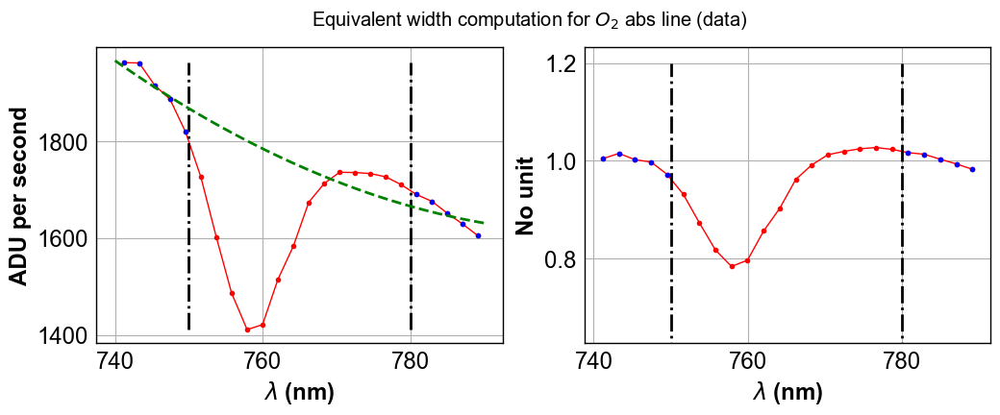

In [335]:
EQW_DATA = ShowEquivalentWidth2NonLinear(thewl,thespectrum,O2WL1,O2WL2,O2WL3,O2WL4,'$O_2$ abs line (data)',ndeg=3)

(2.0739932, 2.0085703794544623)

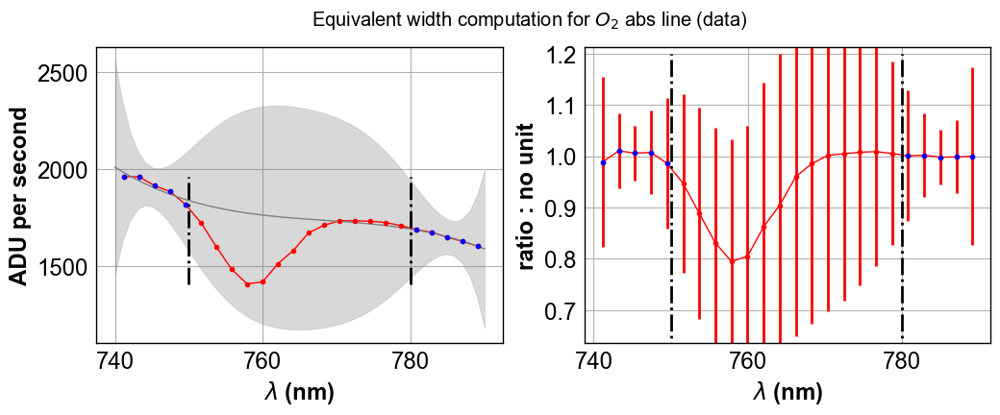

In [336]:
ShowEquivalentWidth2NonLinearwthStatErr(thewl,thespectrum,thespecstaterr,O2WL1,O2WL2,O2WL3,O2WL4,'$O_2$ abs line (data)',ndeg=3)

In [337]:
print EQW_DATA

2.04166


In [338]:
print ComputeEquivalentWidthNonLinear(thewl,thespectrum,O2WL1,O2WL2,O2WL3,O2WL4,ndeg=3)

2.07579


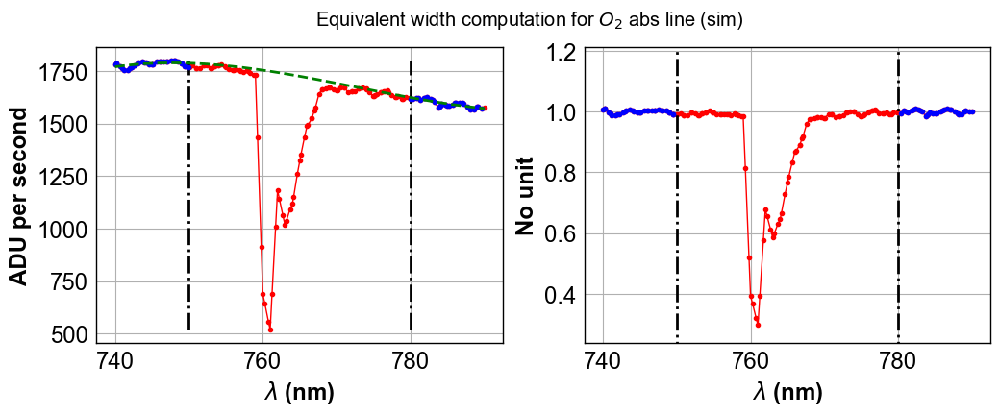

In [339]:
EQW_SIM = ShowEquivalentWidth2NonLinear(wl_sim,spectrum_sim,O2WL1,O2WL2,O2WL3,O2WL4,'$O_2$ abs line (sim)',ndeg=3)

In [254]:
print EQW_SIM

3.04098644687


## A) O2 absorption line
-------------------------------

In [340]:
EQW_DATA_O2 = ComputeEquivalentWidthNonLinear(thewl,thespectrum,732,744,770,790,ndeg=3)

In [341]:
print ' EQW_DATA(O2) = ',EQW_DATA_O2, 'nm'

 EQW_DATA(O2) =  3.06297 nm


In [342]:
WL1_O2_DATA=O2WL1
WL2_O2_DATA=O2WL2
WL3_O2_DATA=O2WL3
WL4_O2_DATA=O2WL4

In [343]:
WL1_O2_SIM=O2WL1
WL2_O2_SIM=O2WL2
WL3_O2_SIM=O2WL3
WL4_O2_SIM=O2WL4

In [344]:
def ShowAllEquivalentWidth(all_wl,all_spec,wl1,wl2,wl3,wl4,label='absorption line'):
        
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        wl=all_wl[index]
        
        newlabel = label+ ' for img {} with disp {}'.format(index,all_filt[index]) 
        
        ShowEquivalentWidth2(wl,spectrum,wl1,wl2,wl3,wl4,label=newlabel)


In [345]:
def ShowAllEquivalentWidthNonLinear(all_wl,all_spec,wl1,wl2,wl3,wl4,label='absorption line',ndeg=3):
        
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        wl=all_wl[index]
        
        newlabel = label+ ' for img {} with disp {}'.format(index,all_filt[index]) 
        
        ShowEquivalentWidth2NonLinear(wl,spectrum,wl1,wl2,wl3,wl4,label=newlabel,ndeg=ndeg)


In [346]:
def ShowAllEquivalentWidthNonLinearwthStatErr(all_wl,all_spec,all_staterr,wl1,wl2,wl3,wl4,label='absorption line',ndeg=2):
        
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        specerr=all_staterr[index]
        wl=all_wl[index]
        
        newlabel = label+ ' for img {} with disp {}'.format(index,all_filt[index]) 
        
        eqw,eqwerr=ShowEquivalentWidth2NonLinearwthStatErr(wl,spectrum,specerr,wl1,wl2,wl3,wl4,label=newlabel,ndeg=ndeg)

        print eqw,' nm',eqwerr, ' nm'    


In [347]:
def ComputeAllEquivalentWidth(all_wl,all_spec,wl1,wl2,wl3,wl4):
    
    EQW_coll = []
    
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        wl=all_wl[index]
        eqw=ComputeEquivalentWidth(wl,spectrum,wl1,wl2,wl3,wl4)
        EQW_coll.append(eqw)
        
    return EQW_coll

In [348]:
def ComputeAllEquivalentWidthNonLinear(all_wl,all_spec,wl1,wl2,wl3,wl4,ndeg=3):
    
    EQW_coll = []
    
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        wl=all_wl[index]
        eqw=ComputeEquivalentWidthNonLinear(wl,spectrum,wl1,wl2,wl3,wl4,ndeg=ndeg)
        EQW_coll.append(eqw)
        
    return EQW_coll

In [349]:
def ComputeAllEquivalentWidthNonLinearwthStatErr(all_wl,all_spec,all_espec,wl1,wl2,wl3,wl4,ndeg=3):
    
    EQW_coll = []
    EQW_ERR_coll = []
    
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        spectrum_err=all_espec[index]
        wl=all_wl[index]
        eqw,eqw_err=ComputeEquivalentWidthNonLinearwthStatErr(wl,spectrum,spectrum_err,wl1,wl2,wl3,wl4,ndeg=ndeg)
        EQW_coll.append(eqw)
        EQW_ERR_coll.append(eqw_err) 
        
    return EQW_coll,EQW_ERR_coll

2.07399  nm 2.00857037945  nm
3.21056  nm 0.0802615371495  nm
-2.51141  nm 0.515376024013  nm
3.21546  nm 0.162963580596  nm


/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:97: RuntimeWarning: divide by zero encountered in divide
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:99: RuntimeWarning: divide by zero encountered in divide
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:135: RuntimeWarning: invalid value encountered in multiply
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:136: RuntimeWarning: invalid value encountered in multiply


nan  nm nan  nm
2.31215  nm 1.55323252922  nm
3.36688  nm 0.17243401196  nm
2.96318  nm 0.118446488398  nm
-0.778612  nm 0.441143004717  nm
2.93367  nm 0.0827440244104  nm
2.4062  nm 1.82850378894  nm
3.20386  nm 0.105779305797  nm
-0.910693  nm 0.313855621649  nm
3.30623  nm 0.0900541691482  nm
-0.301137  nm 0.450867433092  nm
3.06365  nm 0.359487022342  nm
-6.43884  nm 2.62341783035  nm
3.0146  nm 0.0846144972828  nm
3.07899  nm 0.130068594418  nm
2.64533  nm 0.529843068935  nm
2.7584  nm 0.187661839965  nm
-1.22562  nm 0.892379062951  nm
2.87096  nm 0.139210319207  nm
-9.20558  nm 61.7315008889  nm
-14.2911  nm 27.6939598493  nm
-0.0387787  nm 0.397921361737  nm
2.92438  nm 0.282875352367  nm
2.79755  nm 0.180324137782  nm
3.79252  nm 6.59645380127  nm
-0.102679  nm 0.402061383133  nm
-1.70344  nm 1.03909736498  nm
15.1246  nm 181.309828426  nm
2.66429  nm 0.0547804517467  nm
-1.04355  nm 2.14363148056  nm
1.65644  nm 2.97223239511  nm
0.075558  nm 0.4813377364  nm
2.80177  nm 0.065

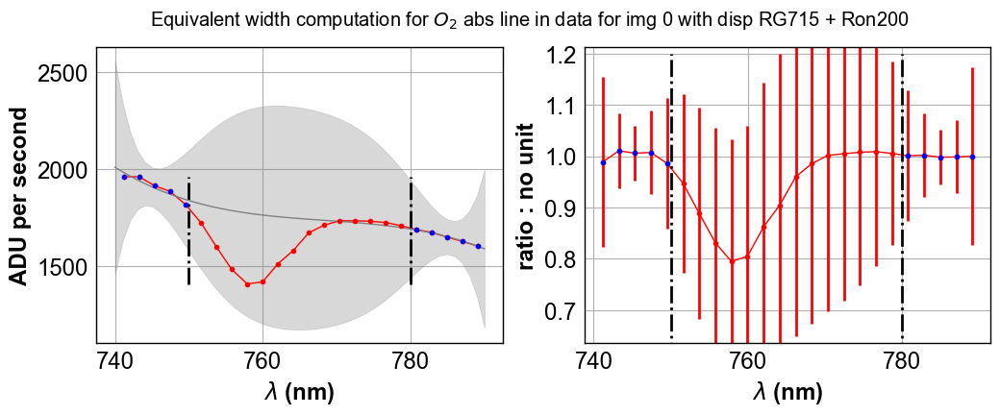

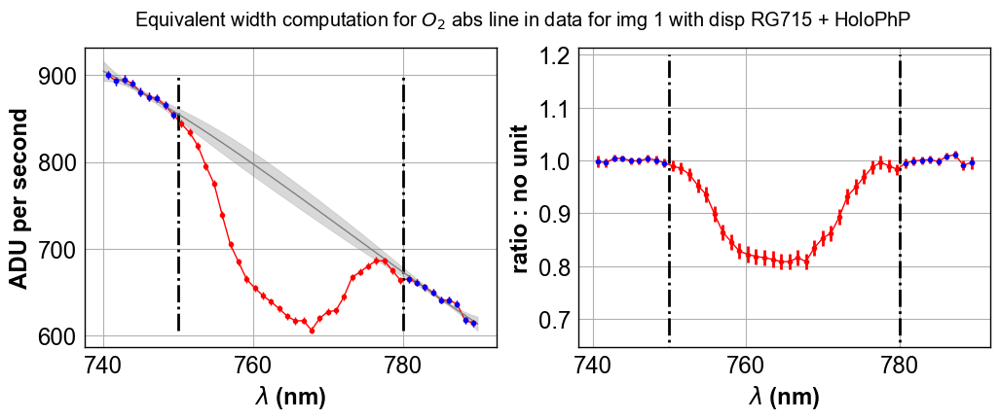

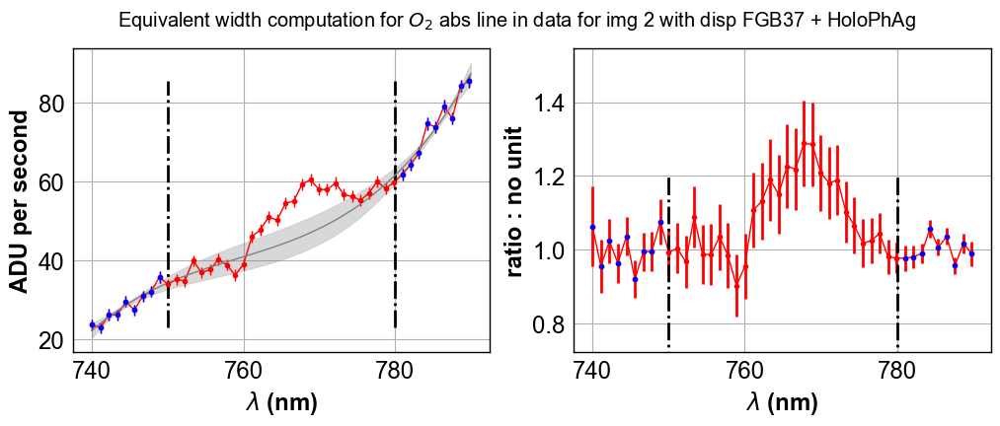

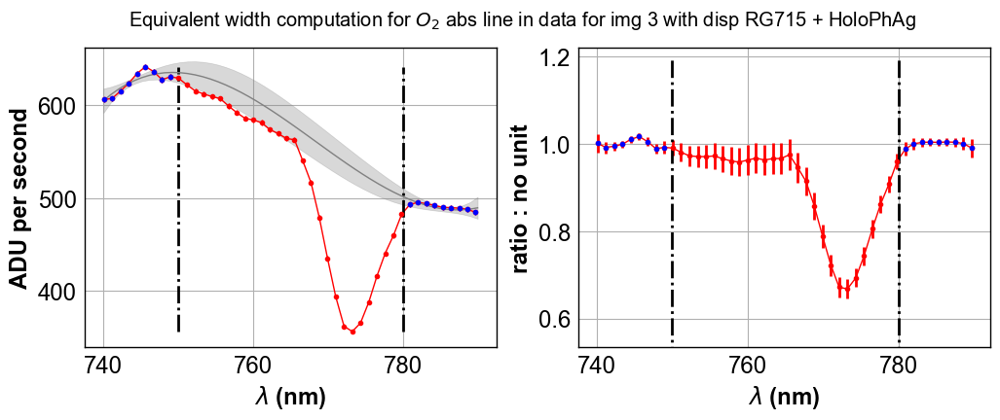

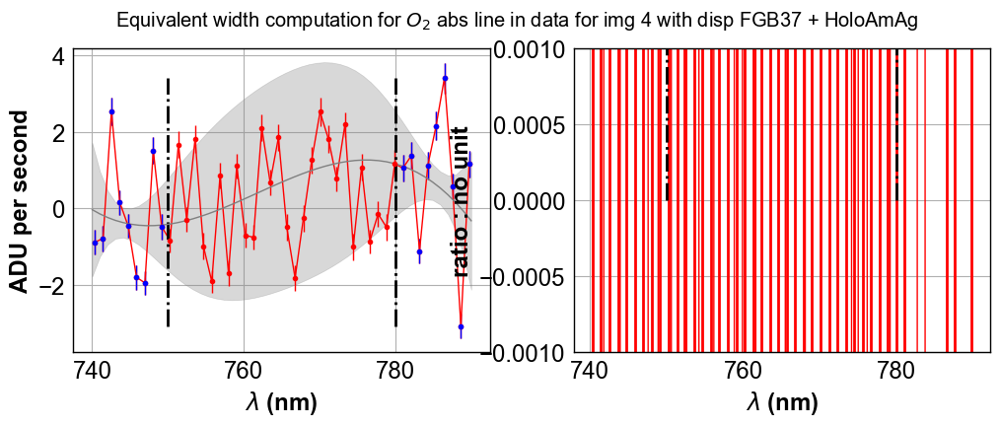

...

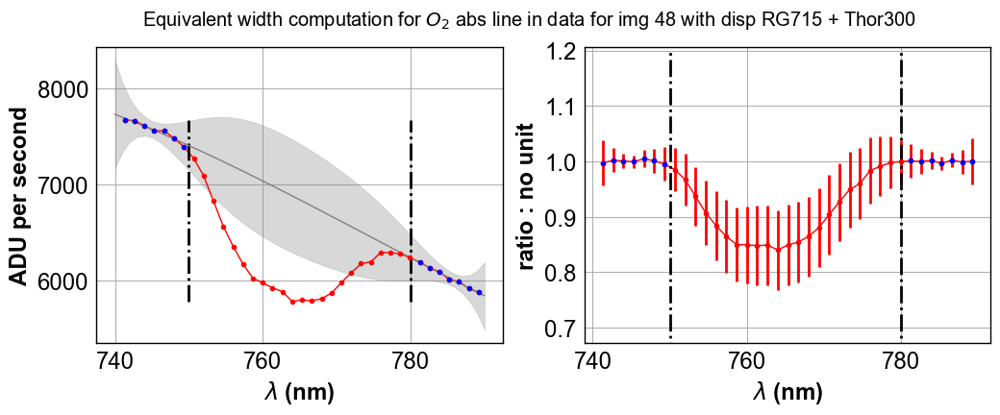

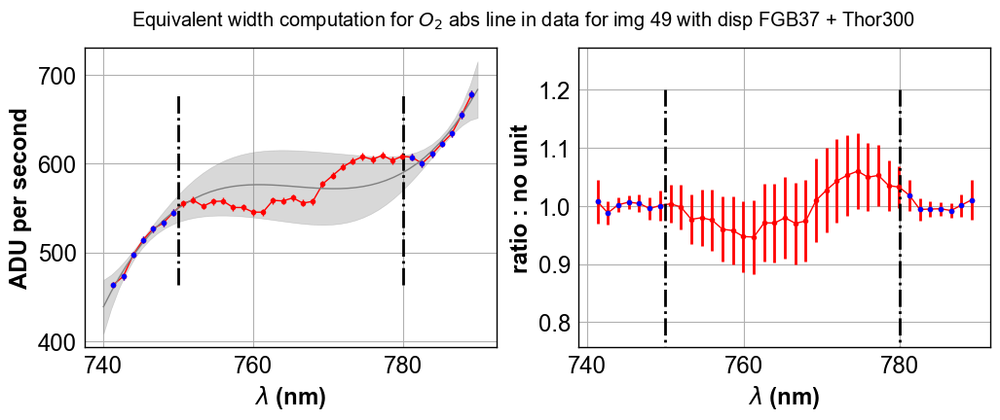

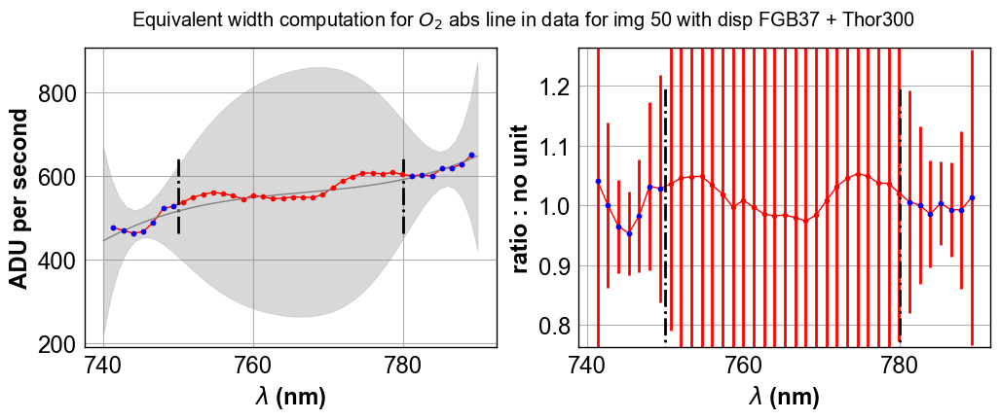

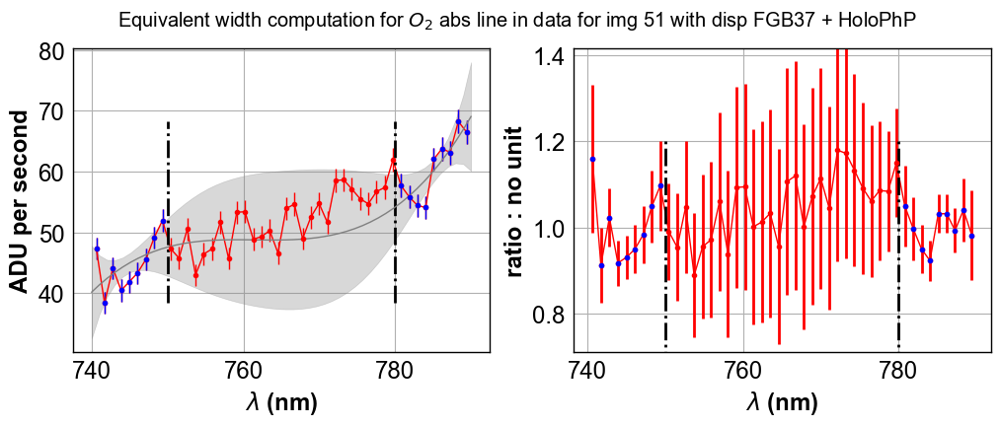

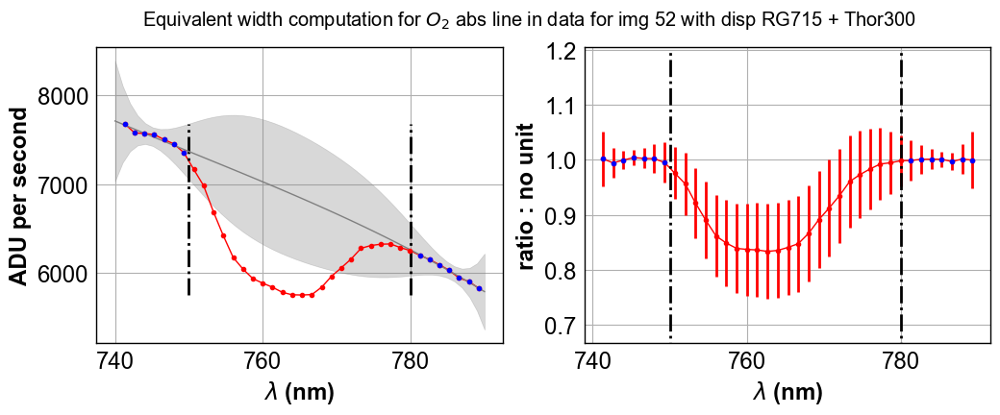

In [350]:
ShowAllEquivalentWidthNonLinearwthStatErr(all_rightspectra_wl,all_rightspectra_data,all_rightspectra_data_staterr,WL1_O2_DATA,WL2_O2_DATA,WL3_O2_DATA,WL4_O2_DATA,'$O_2$ abs line in data',ndeg=3)

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/li

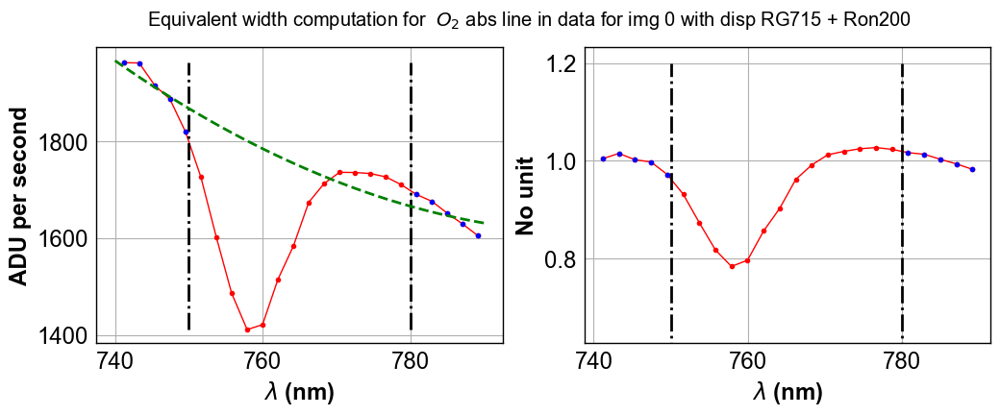

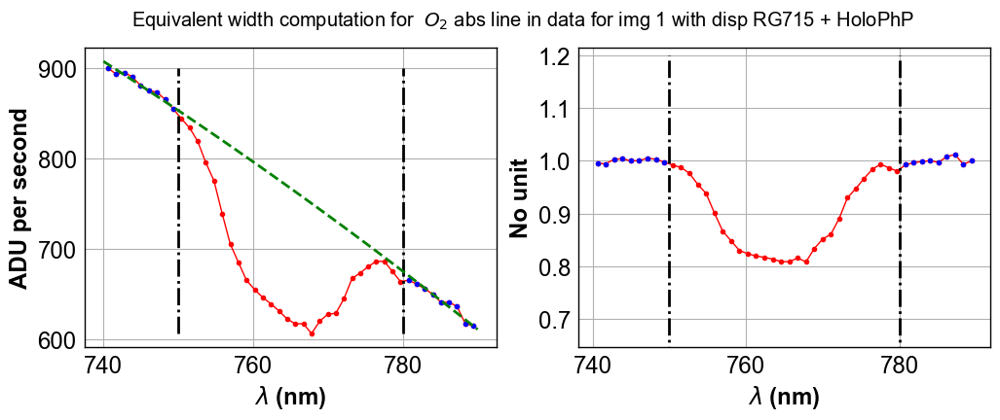

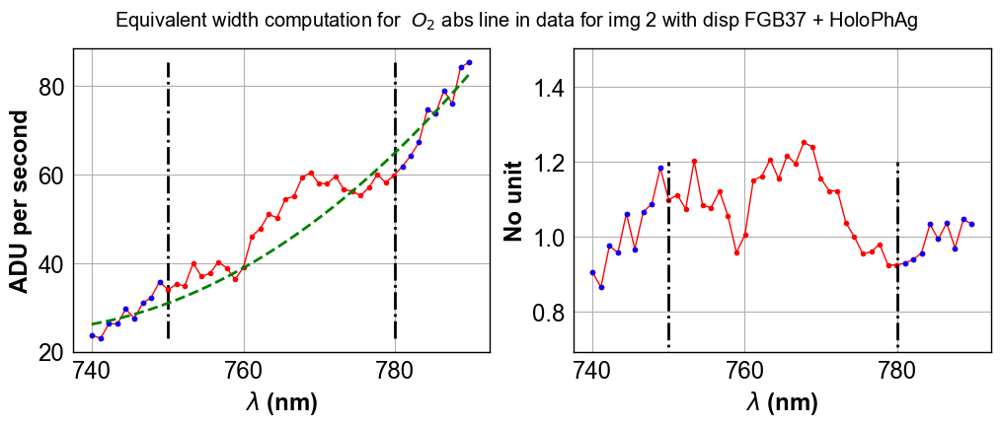

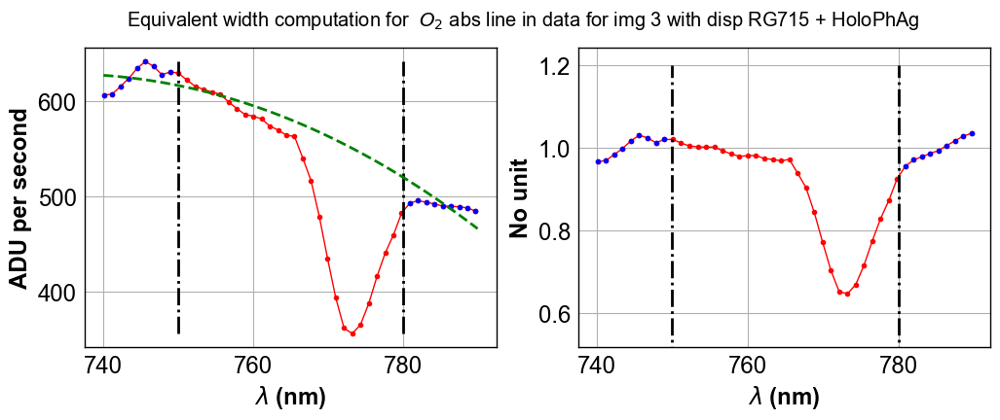

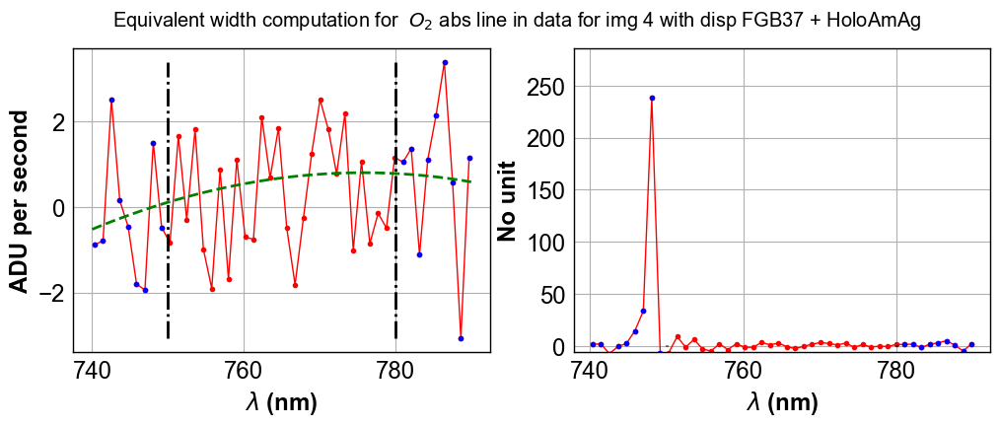

...

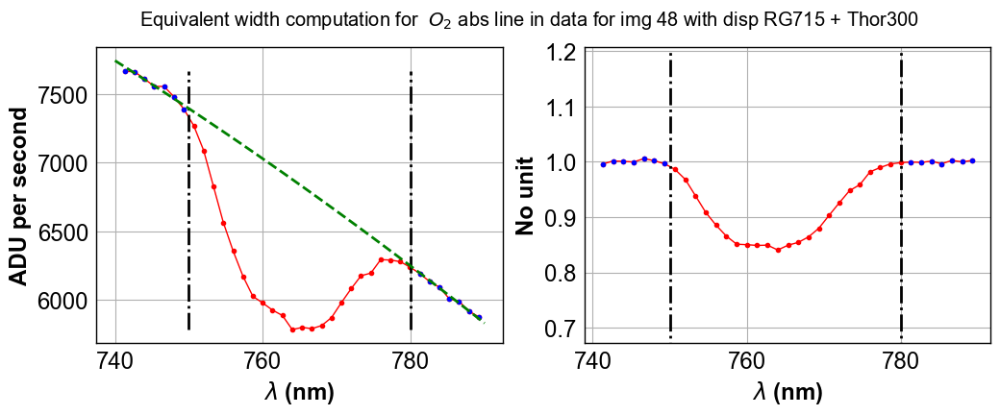

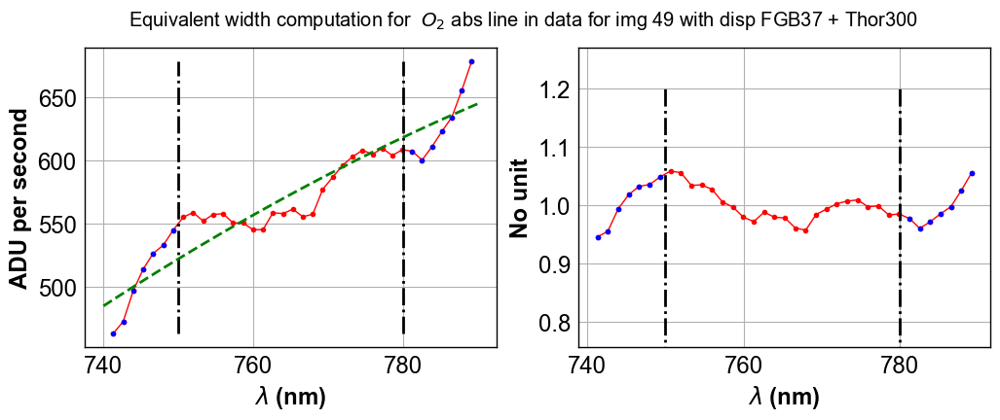

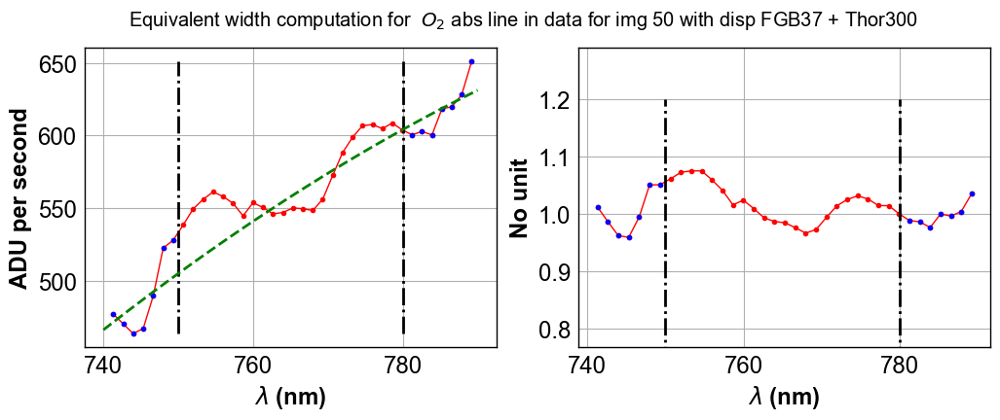

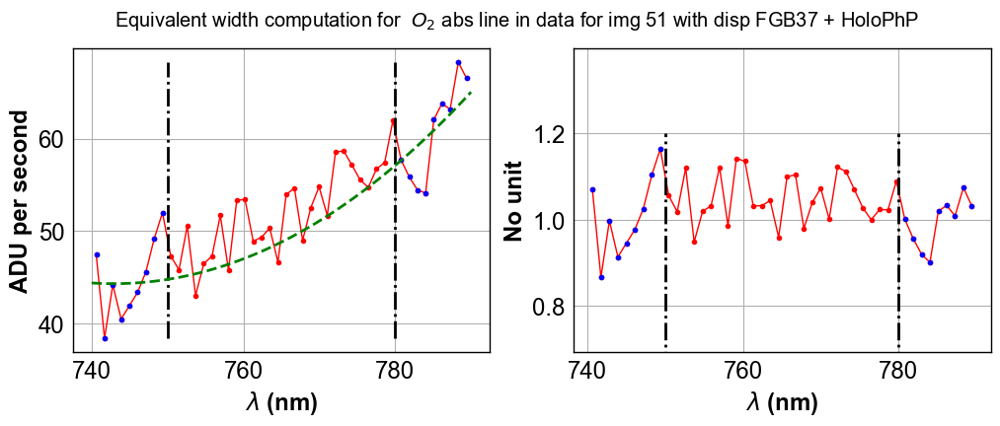

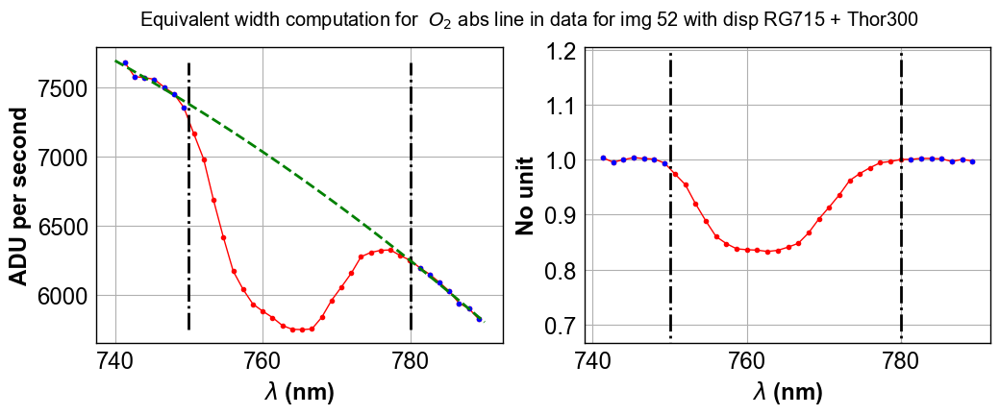

In [266]:
ShowAllEquivalentWidthNonLinear(all_rightspectra_wl,all_rightspectra_data,WL1_O2_DATA,WL2_O2_DATA,WL3_O2_DATA,WL4_O2_DATA,' $O_2$ abs line in data',ndeg=3)

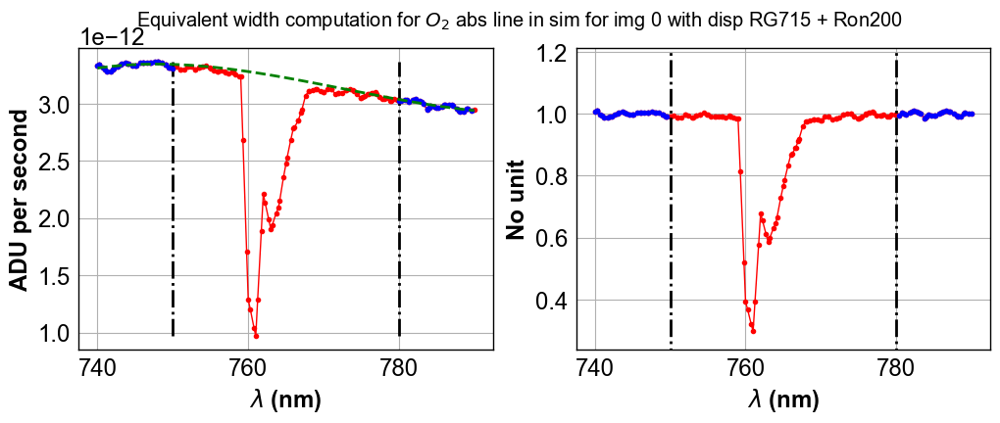

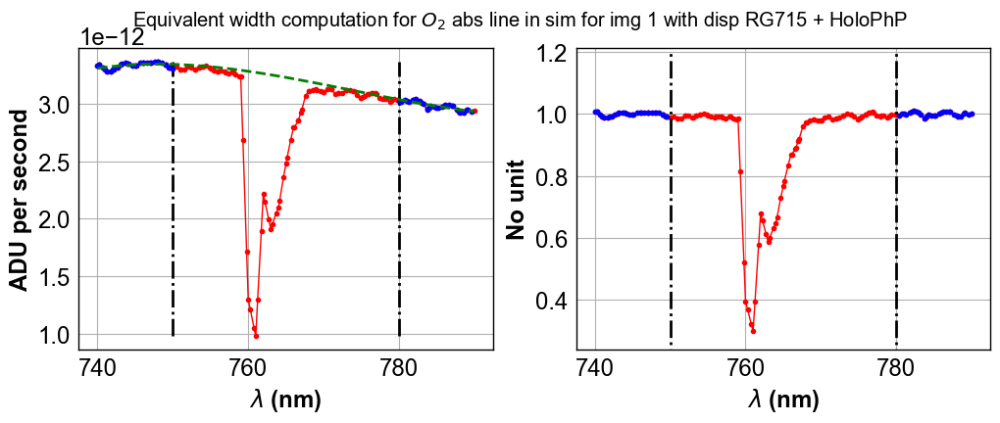

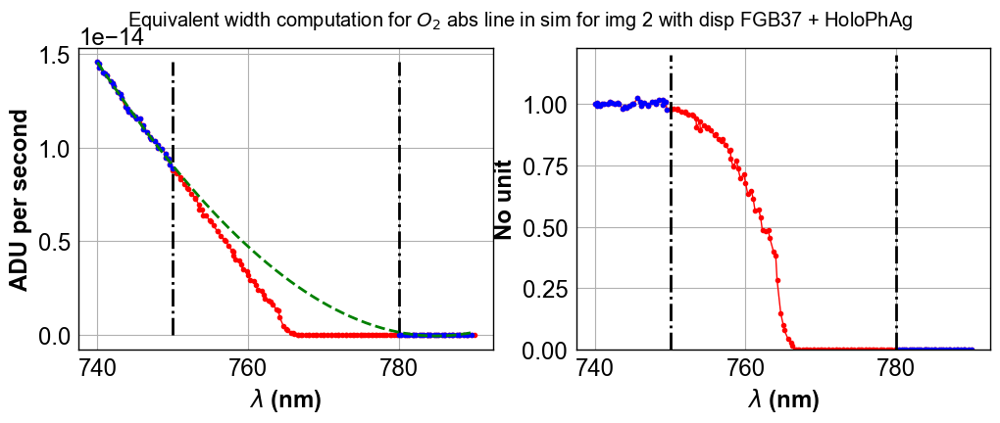

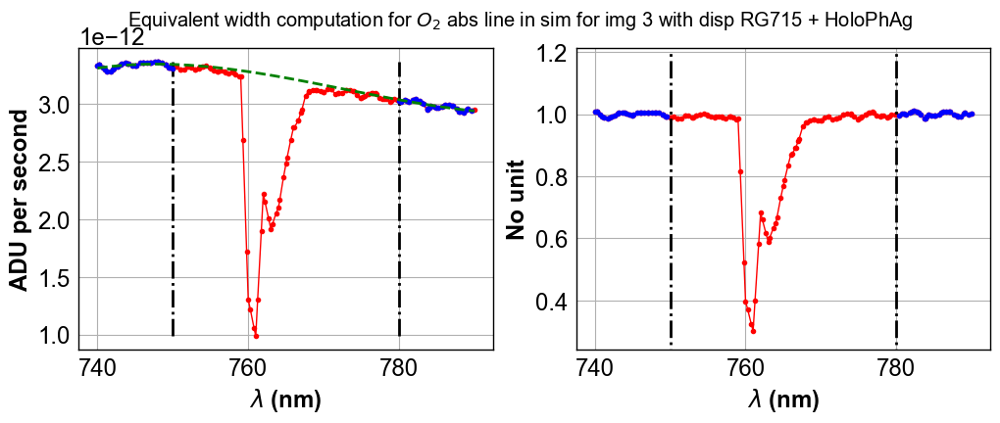

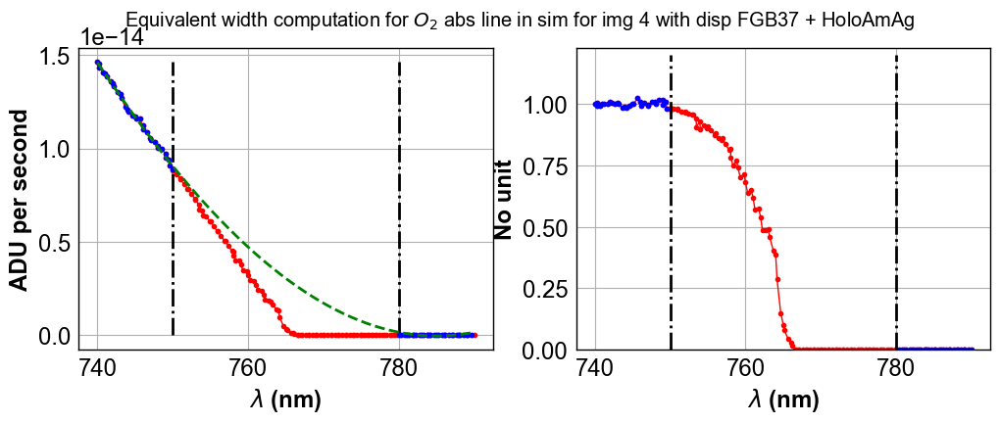

...

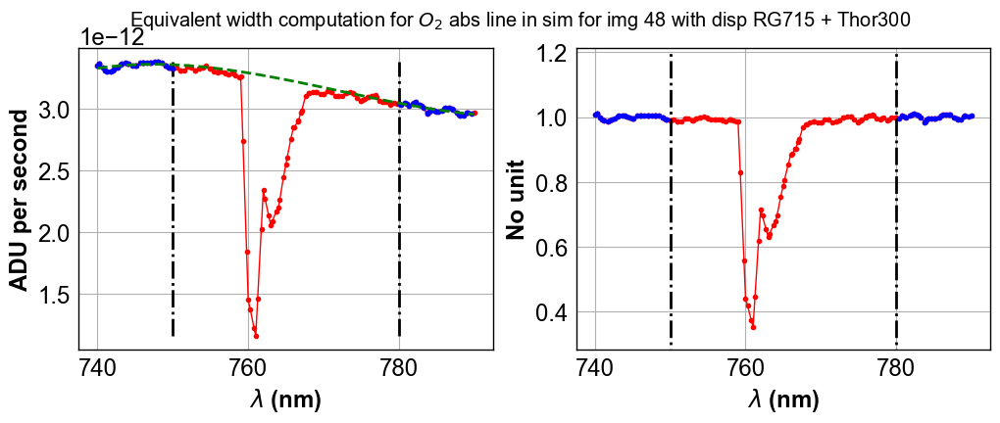

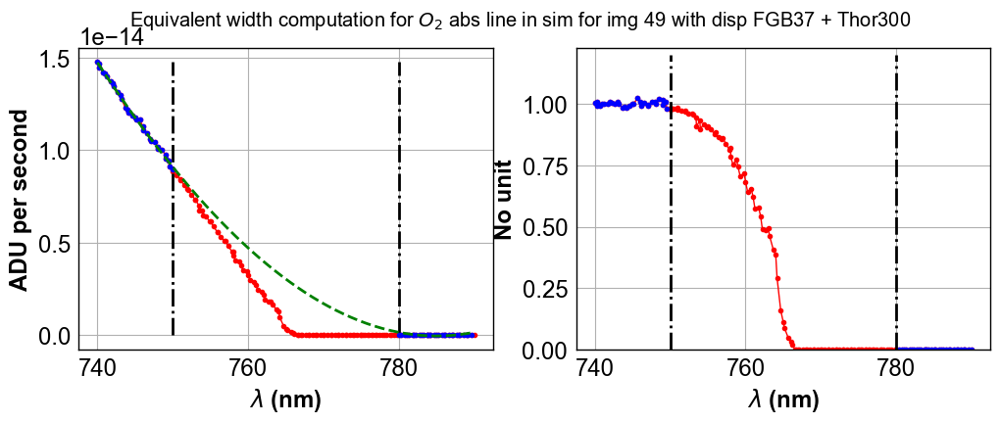

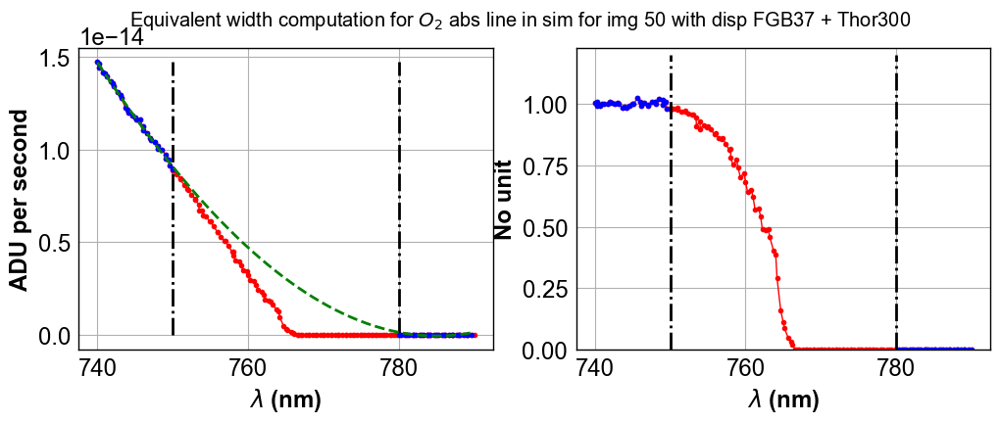

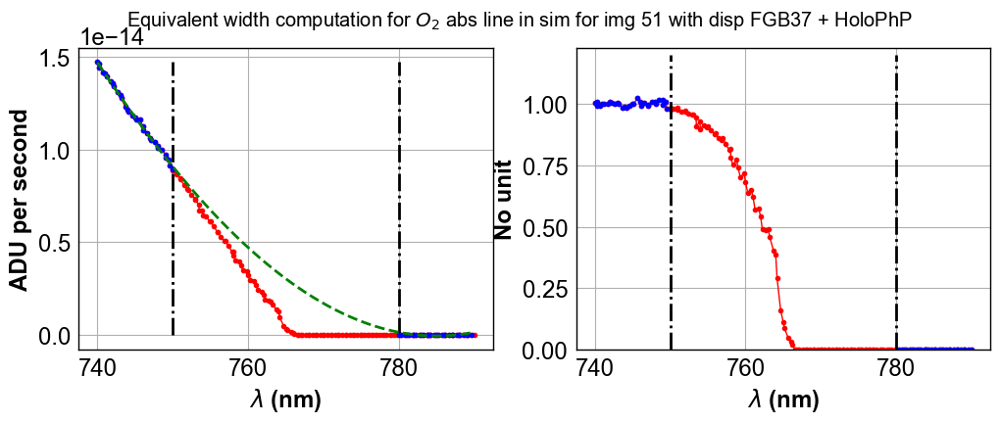

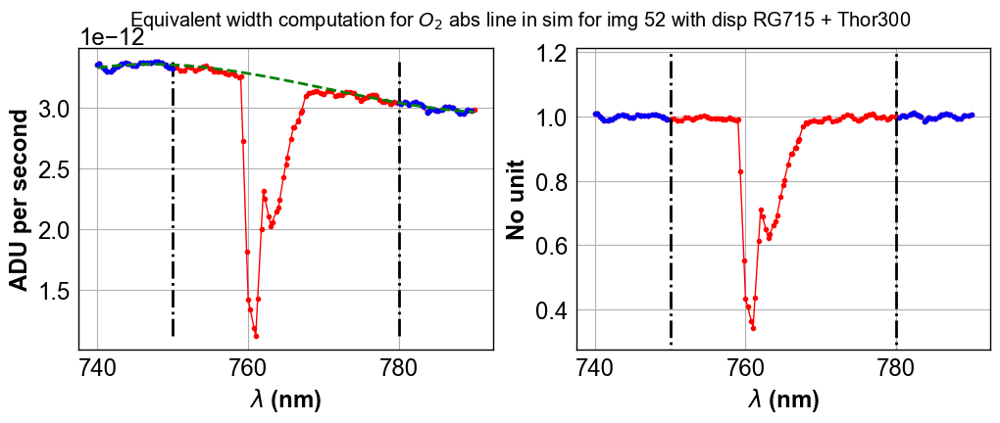

In [267]:
ShowAllEquivalentWidthNonLinear(allwl_sim,allspectra_sim,WL1_O2_SIM,WL2_O2_SIM,WL3_O2_SIM,WL4_O2_SIM,'$O_2$ abs line in sim',ndeg=3)

In [268]:
All_eqw_O2_Data=ComputeAllEquivalentWidthNonLinear(all_rightspectra_wl,all_rightspectra_data,WL1_O2_DATA,WL2_O2_DATA,WL3_O2_DATA,WL4_O2_DATA,ndeg=3)

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RuntimeWarning: divide by zero encountered in divide
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:38: RuntimeWarning: invalid value encountered in multiply


In [269]:
print All_eqw_O2_Data

[2.0757949, 3.210644, -2.3929374, 3.1993148, nan, 2.3162458, 3.3666039, 2.9726205, -0.78583646, 2.9273949, 2.4153554, 3.2027421, -0.93788469, 3.2986331, -0.29573011, 3.06304, -6.3209395, 3.0146883, 3.0620949, 2.6524491, 2.7709324, -1.23247, 2.8636866, -1.5863857, -14.53859, -0.041437201, 2.9244187, 2.7833846, 3.945292, -0.10216808, -1.6657667, 16.521049, 2.6641729, -1.0142347, 1.6822424, 0.06479048, 2.8016386, -0.23539063, 3.1252818, -0.4315595, 2.866715, 1.7998335, inf, -1.692889, 3.0806069, 2.6860847, -99.653442, 2.7754664, 2.7428668, 0.094827652, -0.53865874, -1.4407494, 2.8893983]


In [270]:
All_eqw_O2_Data,All_eqw_O2_Data_Err=ComputeAllEquivalentWidthNonLinearwthStatErr(all_rightspectra_wl,all_rightspectra_data,all_rightspectra_data_staterr,WL1_O2_DATA,WL2_O2_DATA,WL3_O2_DATA,WL4_O2_DATA,ndeg=3)

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/li

In [271]:
print All_eqw_O2_Data

[2.0416598, 3.2157564, -2.8099046, 3.1814857, 17.609179, 2.3058481, 3.3690729, 2.9335461, -0.80388033, 2.905405, 2.3895967, 3.2041588, -1.1514753, 3.2857225, -0.31857473, 3.0620561, -6.3881025, 3.0185943, 3.0590277, 2.6322887, 2.7547393, -1.2556567, 2.8585649, -2.8837738, -12.557518, -0.044671729, 2.9254744, 2.767755, 3.9246924, -0.11753345, -1.6056858, 2.7769628, 2.6543446, -0.72325456, 1.6490288, 0.0093326569, 2.7947631, -0.25549737, 3.1303635, -0.43803105, 2.8665512, 1.9498243, -220.13283, -1.7130188, 3.0825286, 2.6863427, -153.42386, 2.7716179, 2.7444632, 0.018641658, -0.57126582, -1.5186629, 2.88799]


In [272]:
print All_eqw_O2_Data_Err

[2.0153342936513008, 0.080241871276313007, 0.52852586344948516, 0.16425638771404305, 129.71161892307344, 1.5546381467940469, 0.17240740153694359, 0.11912244138721303, 0.44164796925049277, 0.083095524924239675, 1.8321734327318526, 0.1057789133926146, 0.32030032124412039, 0.090423748079016666, 0.45128686038699561, 0.35952649195090425, 2.6199630056355891, 0.084596711062500801, 0.13060974361474026, 0.53066294291023786, 0.18849279117574463, 0.89384326002195413, 0.13994949824877073, 42.250600626094574, 24.433811671693814, 0.39774075830848538, 0.2828541981977154, 0.18150167607998871, 6.4135819317079941, 0.40225215160242345, 1.0298998448643861, 7.5983612729542171, 0.0548606574677587, 2.0764071592635913, 2.976095642159712, 0.48254825351826874, 0.065887740062015462, 0.58085883798868432, 0.075975501527007411, 0.40263921742350539, 0.1521679567541257, 0.58096301385416682, 2133.4549424681231, 0.4927152940128382, 0.11990054150388726, 0.22434535625531615, 850.08991488763581, 0.091199270473857202, 0.40

In [273]:
All_eqw_O2_Sim=ComputeAllEquivalentWidthNonLinear(allwl_sim,allspectra_sim,WL1_O2_SIM,WL2_O2_SIM,WL3_O2_SIM,WL4_O2_SIM,ndeg=3)

In [274]:
All_eqw_O2_Data=np.array(All_eqw_O2_Data)
All_eqw_O2_Data_Err=np.array(All_eqw_O2_Data_Err)
All_eqw_O2_Sim=np.array(All_eqw_O2_Sim)

In [275]:
am=np.array(all_airmass)

In [351]:
ListOfDisperserNames=['Ron200', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg']

In [352]:
def PlotEquivalentWidthVsAirMass(all_eqw_width,all_eqw_err,all_eqw_width_sim,all_am,tagabsline,figname):
    """
    """
    am0 = []
    eqw0 = []
    eqw0_err = []
    
    am1 = []
    eqw1 = []
    eqw1_err = []
    
    am2 = []
    eqw2 = []
    eqw2_err = []
    
    am3 = []
    eqw3 = []
    eqw3_err = []
    
    am4 = []
    eqw4 = []
    eqw4_err = []
    
    amsim= []
    eqwsim= []
    
    max_y_to_plot=max(all_eqw_width)*1.2
    min_y_to_plot=0.
    
    
    for index,eqw in np.ndenumerate(all_eqw_width):
        idx=index[0]
        grating_name=all_filt[idx]
        am=all_am[idx]
        eqw_err=all_eqw_err[idx]
        
        amsim.append(am)
        eqwsim.append(all_eqw_width_sim[idx])
        
        if re.search(ListOfDisperserNames[0],grating_name):
            am0.append(am)
            eqw0.append(eqw)
            eqw0_err.append(eqw_err)
        elif re.search(ListOfDisperserNames[1],grating_name):
            am1.append(am)
            eqw1.append(eqw)
            eqw1_err.append(eqw_err)
        elif re.search(ListOfDisperserNames[2],grating_name):
            am2.append(am)
            eqw2.append(eqw)
            eqw2_err.append(eqw_err)
        elif re.search(ListOfDisperserNames[3],grating_name):
            am3.append(am)
            eqw3.append(eqw)
            eqw3_err.append(eqw_err)
        elif re.search(ListOfDisperserNames[4],grating_name):
            am4.append(am)
            eqw4.append(eqw)
            eqw4_err.append(eqw_err)
        else:
            print 'disperser ',grating_name,' not found'
            
    fig=plt.figure(figsize=(20,8))

    ax=fig.add_subplot(1,1,1)
    # remove Ronchi
    # ax.plot(am0,eqw0,marker='o',color='red',lw=1,label=ListOfDisperserNames[0])
    ax.plot(am1,eqw1,'-',color='blue',lw=2)
    ax.errorbar(am1,eqw1,yerr=eqw1_err,fmt='o',markersize='10',color='blue',lw=2,label=ListOfDisperserNames[1])
    ax.plot(am2,eqw2,'-',color='green',lw=2)
    ax.errorbar(am2,eqw2,yerr=eqw2_err,marker='o',markersize='10',color='green',lw=2,label=ListOfDisperserNames[2])
    ax.plot(am3,eqw3,'-',color='cyan',lw=2)
    ax.errorbar(am3,eqw3,yerr=eqw3_err,marker='o',markersize='10',color='cyan',lw=2,label=ListOfDisperserNames[3])
    ax.plot(am4,eqw4,'-',color='magenta',lw=2)
    ax.errorbar(am4,eqw4,yerr=eqw4_err,marker='o',markersize='10',color='magenta',lw=2,label=ListOfDisperserNames[4])
    
    ax.plot(amsim,eqwsim,marker='o',color='black',markersize='10',lw=1,label='simulation')

    ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())   
    ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())

    ax.grid(b=True, which='major', color='k', linewidth=2.0)
    ax.grid(b=True, which='minor', color='grey', linewidth=0.5)

    ax.set_ylabel('Equivalent width (nm)')
    ax.set_xlabel('AirMass')
    #ax.set_ylim(min_y_to_plot,max_y_to_plot)
    


    title='Equivalent Width vs airmass for {} for object {}'.format(tagabsline,object_name)

    plt.title(title)
    plt.legend(loc='best')

    figfilename=os.path.join(dir_top_images,figname)
    fig.savefig(figfilename)
 

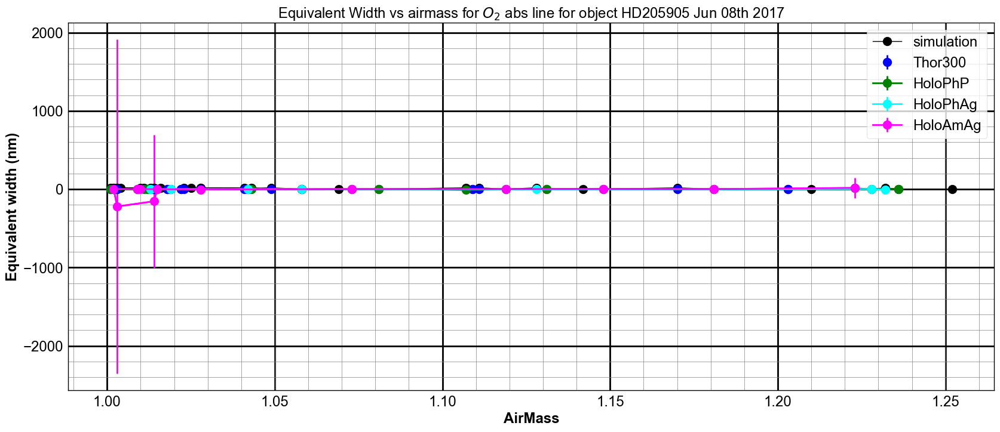

In [353]:
PlotEquivalentWidthVsAirMass(All_eqw_O2_Data,All_eqw_O2_Data_Err,All_eqw_O2_Sim,am,'$O_2$ abs line','eqwvsam_O2.pdf')

In [279]:
def PlotEquivalentWidthVsTime(all_eqw_width,all_eqw_width_sim,all_am,all_dt,tagabsline,figname):
    """
    """
    am0 = []
    eqw0 = []
    tim0 = []
    
    am1 = []
    eqw1 = []
    tim1=[]
    
    am2 = []
    eqw2 = []
    tim2=[]
    
    am3 = []
    eqw3 = []
    tim3=[]
    
    am4 = []
    eqw4 = []
    tim4=[]
    
    timsim = []
    eqwsim = []
    
    date_range = all_dt[NDATA-1] - all_dt[0]
    
    max_y_to_plot=max(all_eqw_width)*1.2
    min_y_to_plot=0.
    
    for index,eqw in np.ndenumerate(all_eqw_width):
        idx=index[0]
        grating_name=all_filt[idx]
        am=all_am[idx]
        
        timsim.append(all_dt[idx])
        eqwsim.append(all_eqw_width_sim[idx])
        
        
        if re.search(ListOfDisperserNames[0],grating_name):
            am0.append(am)
            eqw0.append(eqw)
            tim0.append(all_dt[idx])
        elif re.search(ListOfDisperserNames[1],grating_name):
            am1.append(am)
            eqw1.append(eqw)
            tim1.append(all_dt[idx])
        elif re.search(ListOfDisperserNames[2],grating_name):
            am2.append(am)
            eqw2.append(eqw)
            tim2.append(all_dt[idx])
        elif re.search(ListOfDisperserNames[3],grating_name):
            am3.append(am)
            eqw3.append(eqw)
            tim3.append(all_dt[idx])
        elif re.search(ListOfDisperserNames[4],grating_name):
            am4.append(am)
            eqw4.append(eqw)
            tim4.append(all_dt[idx])
        else:
            print 'disperser ',grating_name,' not found'
            
    fig=plt.figure(figsize=(20,8))

    ax=fig.add_subplot(1,1,1)

    #ax.plot_date(tim0,eqw0,'-',marker='o',color='red',lw=1,label=ListOfDisperserNames[0])
    ax.plot_date(tim1,eqw1,'-',marker='o',markersize='10',color='blue',lw=1,label=ListOfDisperserNames[1])
    ax.plot_date(tim2,eqw2,'-',marker='o',markersize='10',color='green',lw=1,label=ListOfDisperserNames[2])
    ax.plot_date(tim3,eqw3,'-',marker='o',markersize='10',color='cyan',lw=1,label=ListOfDisperserNames[3])
    ax.plot_date(tim4,eqw4,'-',marker='o',markersize='10',color='magenta',lw=1,label=ListOfDisperserNames[4])
    
    ax.plot(timsim,eqwsim,marker='o',markersize='10',color='black',lw=1,label='simulation')
    
    date_range = all_dt[NDATA-1] - all_dt[0]

    if date_range > datetime.timedelta(days = 1):
        ax.xaxis.set_major_locator(mdates.DayLocator(bymonthday=range(1,32), interval=1))
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
        ax.get_xaxis().set_minor_locator(mdates.HourLocator(byhour=range(0,24,2)))
        #ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    else:
        ax.xaxis.set_major_locator(mdates.HourLocator(byhour=range(0,24,2)))
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
        #ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        ax.get_xaxis().set_minor_locator(mdates.MinuteLocator(byminute=range(0,60,5)))
    
    ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())

    ax.grid(b=True, which='major', color='k', linewidth=2.0)
    ax.grid(b=True, which='minor', color='grey', linewidth=0.5)
    ax.set_ylabel('Equivalent width (nm)')
    ax.set_xlabel('time')
#    ax.set_ylim(0.,5.)
    #ax.set_ylim(min_y_to_plot,max_y_to_plot)


    title='Equivalent Width vs airmass for {} for object {}'.format(tagabsline,object_name)

    plt.title(title)
    plt.legend(loc='best')
    
    figfilename=os.path.join(dir_top_images,figname)
    fig.savefig(figfilename)
 

disperser  RG715 + Ron200  not found
disperser  RG715 + Ron200  not found
disperser  RG715 + Ron200  not found
disperser  RG715 + Ron200  not found
disperser  FGB37 + Ron200  not found
disperser  FGB37 + Ron200  not found
disperser  FGB37 + Ron200  not found
disperser  RG715 + Ron200  not found


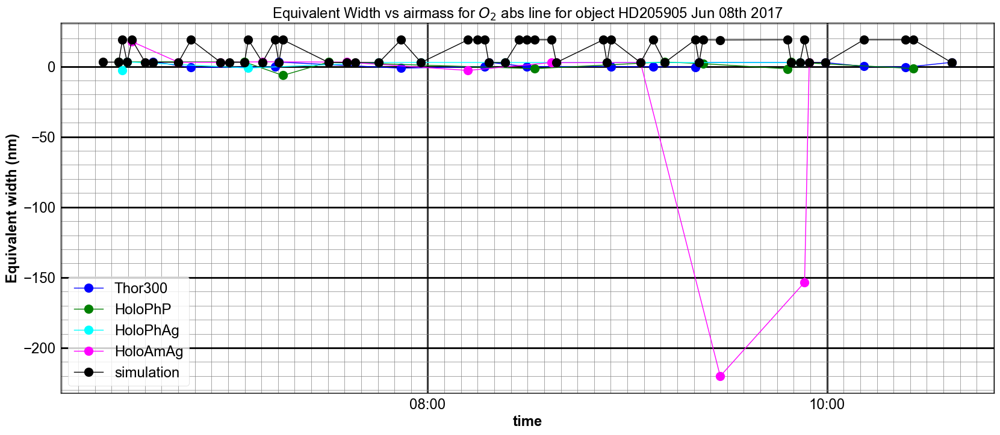

In [280]:
PlotEquivalentWidthVsTime(All_eqw_O2_Data,All_eqw_O2_Sim,am,all_dt,'$O_2$ abs line','eqwvstime_O2.pdf')

## Fit equivalent width

In [281]:
def EqwModel(z,a,b):
    return np.exp(a*np.log(z))+b

In [282]:
def FitEquivalentWidthVsAirMass(all_eqw_width,all_eqw_width_sim,all_am,tagabsline,figname):
    """
    """
    am0 = []
    eqw0 = []
    
    am1 = []
    eqw1 = []
    
    am2 = []
    eqw2 = []
    
    am3 = []
    eqw3 = []
    
    am4 = []
    eqw4 = []
    
    amsim= []
    eqwsim= []
    
    max_y_to_plot=max(all_eqw_width)*1.2
    min_y_to_plot=0.
    
    zmin=1.
    zmax=2.
   
    # 1) Fill data
    
    for index,eqw in np.ndenumerate(all_eqw_width):
        idx=index[0]
        grating_name=all_filt[idx]
        am=all_am[idx]
        
        amsim.append(am)
        eqwsim.append(all_eqw_width_sim[idx])
        
        if re.search(ListOfDisperserNames[0],grating_name):
            am0.append(am)
            eqw0.append(eqw)
        elif re.search(ListOfDisperserNames[1],grating_name):
            am1.append(am)
            eqw1.append(eqw)
        elif re.search(ListOfDisperserNames[2],grating_name):
            am2.append(am)
            eqw2.append(eqw)
        elif re.search(ListOfDisperserNames[3],grating_name):
            am3.append(am)
            eqw3.append(eqw)
        elif re.search(ListOfDisperserNames[4],grating_name):
            am4.append(am)
            eqw4.append(eqw)
        else:
            print 'disperser ',grating_name,' not found'
    
    
    # 2) Fit and plot
    fig=plt.figure(figsize=(20,8))
    allz=np.linspace(zmin,zmax,50)
    ax=fig.add_subplot(1,1,1)

    #am0=np.array(am0)
    #eqw0=np.array(eqw0)
    #popt0, pcov0 = curve_fit(EqwModel, am0, eqw0)
    #print popt0
    #labelfit0='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(popt0[0],popt0[1])    
    #ax.plot(am0,eqw0,marker='o',color='red',lw=0,label=ListOfDisperserNames[0])
    #ax.plot(allz, EqwModel(allz, *popt0),'red', label=labelfit0)
    
    
    
    am1=np.array(am1)
    eqw1=np.array(eqw1)
    popt1, pcov1 = curve_fit(EqwModel, am1, eqw1)
    print popt1
    labelfit1='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(popt1[0],popt1[1])
    ax.plot(am1,eqw1,marker='o',markersize='10',color='blue',lw=0,label=ListOfDisperserNames[1])
    ax.plot(allz, EqwModel(allz, *popt1),'blue', label=labelfit1)
    
    am2=np.array(am2)
    eqw2=np.array(eqw2)
    popt2, pcov2 = curve_fit(EqwModel, am2, eqw2)
    print popt2
    labelfit2='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(popt2[0],popt2[1])   
    ax.plot(am2,eqw2,marker='o',markersize='10',color='green',lw=0,label=ListOfDisperserNames[2])
    ax.plot(allz, EqwModel(allz, *popt2),'green', label=labelfit2)
    
    
    am3=np.array(am3)
    eqw3=np.array(eqw3)
    popt3, pcov3 = curve_fit(EqwModel, am3, eqw3)
    print popt3
    labelfit3='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(popt3[0],popt3[1])   
    ax.plot(am3,eqw3,marker='o',markersize='10',color='cyan',lw=0,label=ListOfDisperserNames[3])
    ax.plot(allz, EqwModel(allz, *popt3),'cyan', label=labelfit3)
    
    am4=np.array(am4)
    eqw4=np.array(eqw4)
    popt4, pcov4 = curve_fit(EqwModel, am4, eqw4)
    print popt4
    labelfit4='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(popt4[0],popt4[1])   
    ax.plot(am4,eqw4,marker='o',markersize='10',color='magenta',lw=0,label=ListOfDisperserNames[4])
    ax.plot(allz, EqwModel(allz, *popt4),'magenta', label=labelfit4)
    
    
    amsim=np.array(amsim)
    eqwsim=np.array(eqwsim)
    poptsim, pcovsim = curve_fit(EqwModel, amsim, eqwsim)
    print poptsim
    labelfitsim='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(poptsim[0],poptsim[1]) 
    ax.plot(amsim,eqwsim,marker='o',markersize='10',color='black',lw=0,label='sim')
    ax.plot(allz, EqwModel(allz, *poptsim),'black', label=labelfitsim)
    
    
    
    
    # Final
    ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())   
    ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())

    ax.grid(b=True, which='major', color='k', linewidth=2.0)
    ax.grid(b=True, which='minor', color='grey', linewidth=0.5)

    ax.set_ylabel('Equivalent width (nm)')
    ax.set_xlabel('AirMass')
    ax.set_ylim(min_y_to_plot,max_y_to_plot)
    ax.set_xlim(0.92*zmin,zmax)


    title='Fit Equivalent Width vs airmass for {} for object {}'.format(tagabsline,object_name)

    plt.title(title)
    plt.legend(loc=2)

    figfilename=os.path.join(dir_top_images,figname)
    fig.savefig(figfilename)
 

disperser  RG715 + Ron200  not found
disperser  RG715 + Ron200  not found
disperser  RG715 + Ron200  not found
disperser  RG715 + Ron200  not found
disperser  FGB37 + Ron200  not found
disperser  FGB37 + Ron200  not found
disperser  FGB37 + Ron200  not found
disperser  RG715 + Ron200  not found
[ 4.12950075 -0.38747158]
[ 5.41582923 -0.84539381]
[-12.86872991   1.03301673]
[ 21.08457751 -40.10574133]
[-19.38085267   9.92162051]


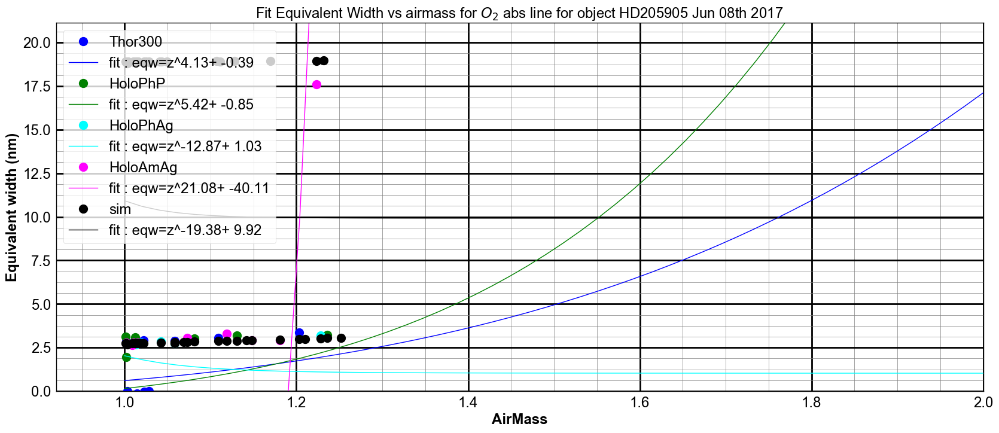

In [283]:
FitEquivalentWidthVsAirMass(All_eqw_O2_Data,All_eqw_O2_Sim,am,'$O_2$ abs line','fiteqwvsam_O2.pdf')

## B) H2O absorption line
-------------------------------

In [354]:
sel=3
thespectrum=all_rightspectra_data[sel]
thewl=all_rightspectra_wl[sel]
thespecstaterr=all_rightspectra_data_staterr[sel]
thelabel=all_filt[sel]

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned


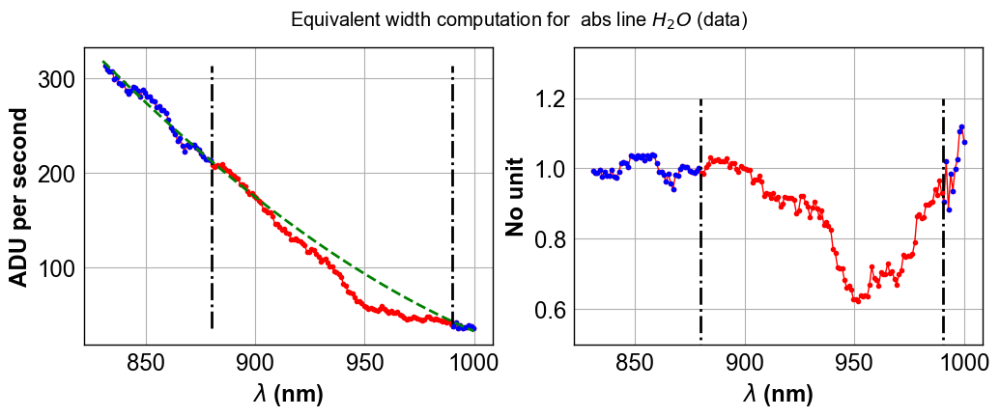

In [355]:
EQW_H2O_DATA = ShowEquivalentWidth2NonLinear(thewl,thespectrum,830,880,990,1000,' abs line $H_2O$ (data)',ndeg=3)

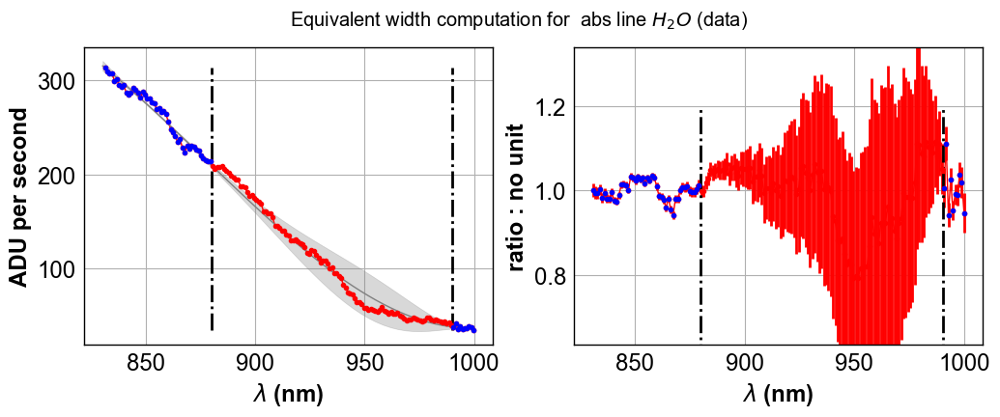

In [356]:
EQW_H2O_DATA = ShowEquivalentWidth2NonLinearwthStatErr(thewl,thespectrum,thespecstaterr,830,880,990,1000,' abs line $H_2O$ (data)',ndeg=3)

In [287]:
#EQW_H2O_SIM = ShowEquivalentWidth2(thewl,thesimspectrum,910,920,984,995,' abs line H2O (sim)')

In [288]:
#print EQW_H2O_SIM,' ' ,EQW_H2O_SIM

In [357]:
#EQW_H2O_DATA = ShowEquivalentWidth(thewl,thespectrum,810,850,980,1000)
WL1_H2O_DATA=830
WL2_H2O_DATA=880
WL3_H2O_DATA=990
WL4_H2O_DATA=1000

In [358]:
#EQW_H2O_SIM = ShowEquivalentWidth(thewl,thesimspectrum,910,920,984,995)
WL1_H2O_SIM=WL1_H2O_DATA
WL2_H2O_SIM=WL2_H2O_DATA
WL3_H2O_SIM=WL3_H2O_DATA
WL4_H2O_SIM=WL4_H2O_DATA

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/li

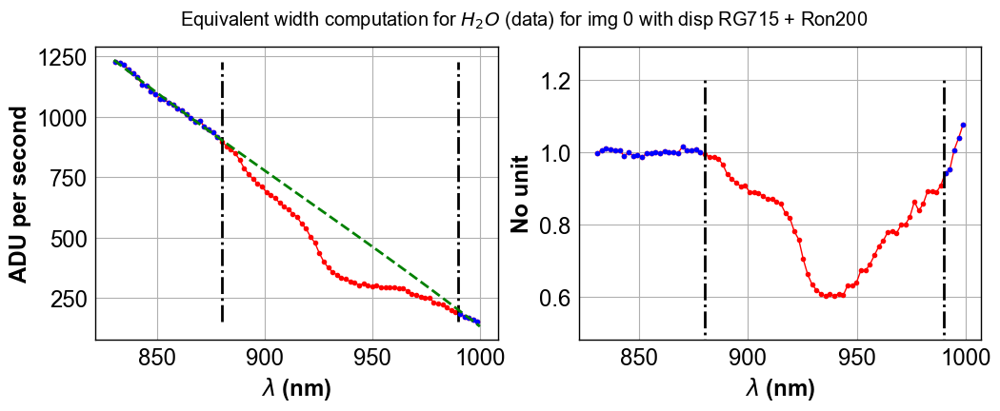

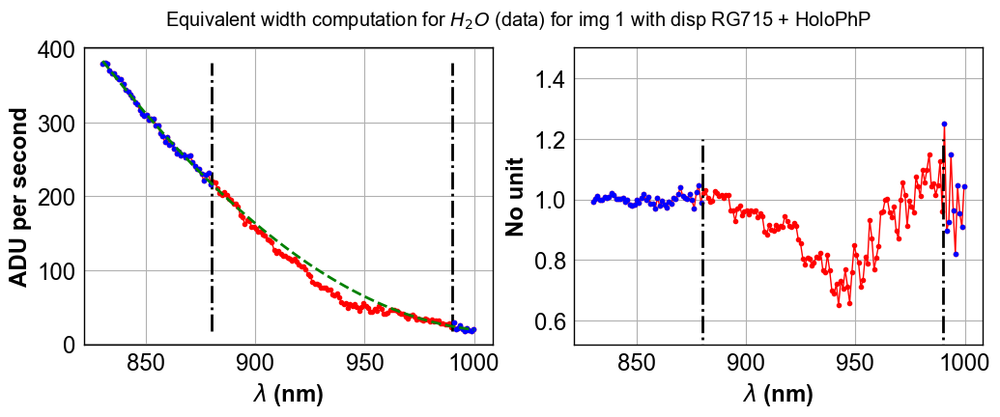

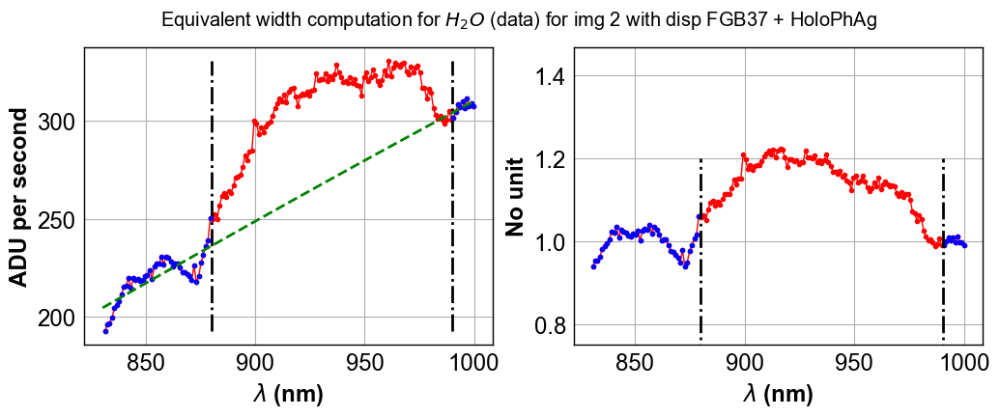

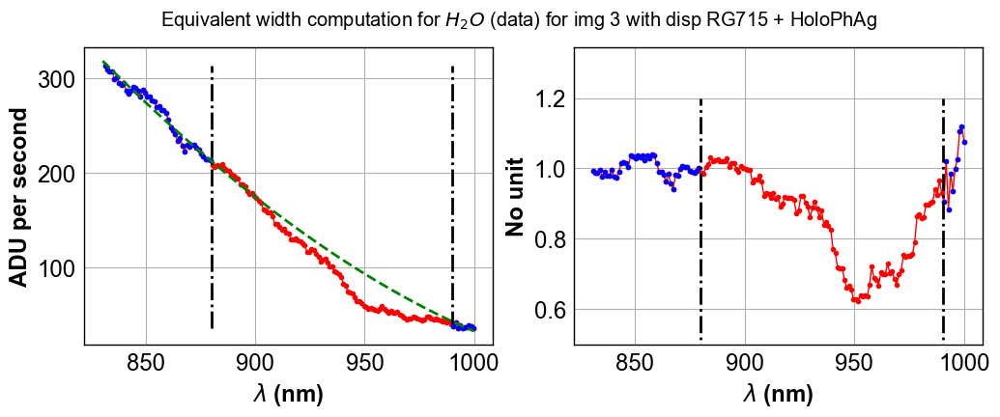

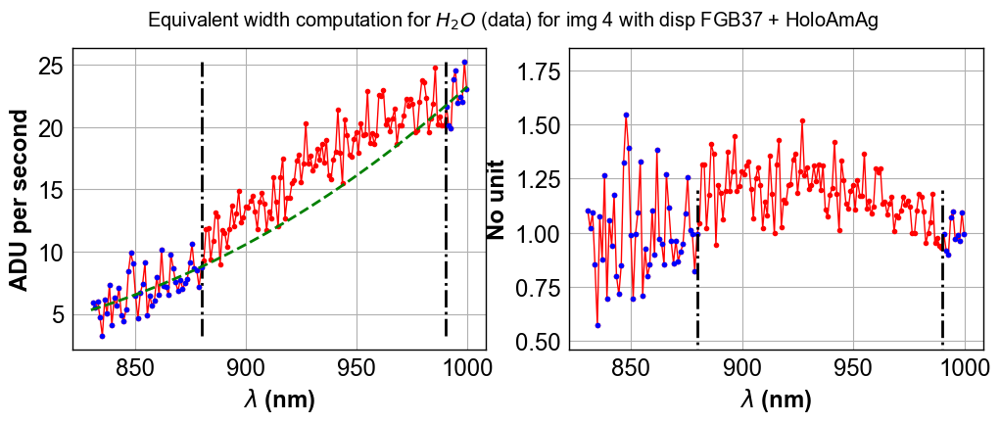

...

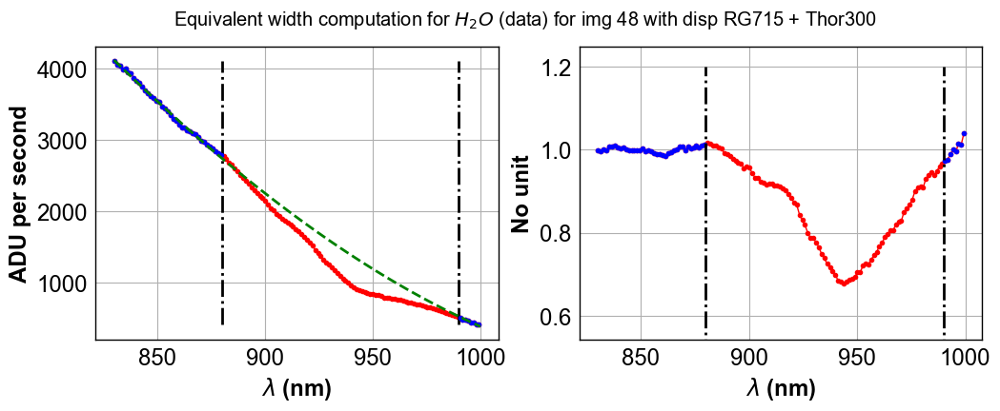

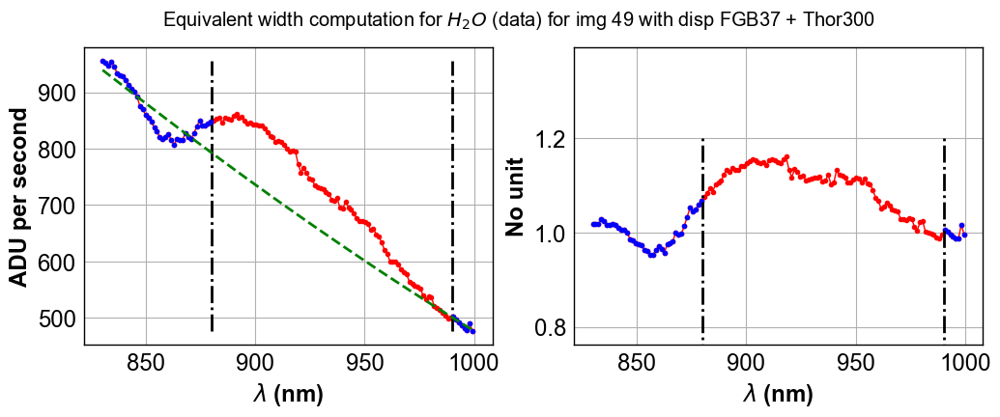

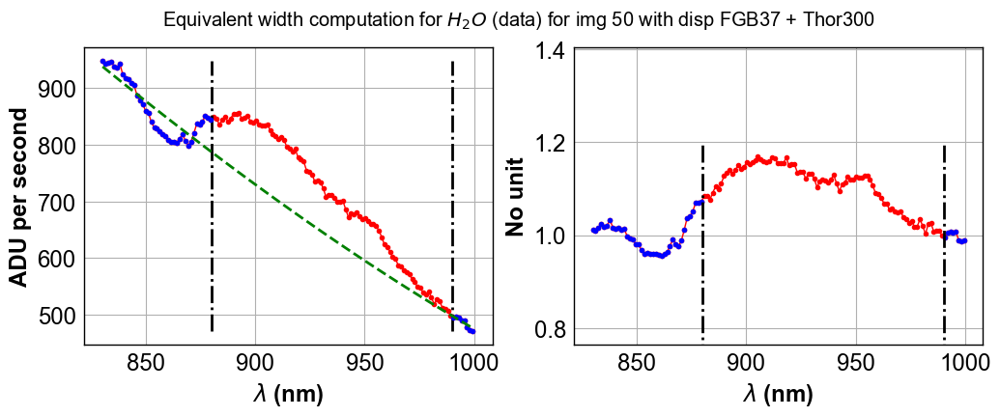

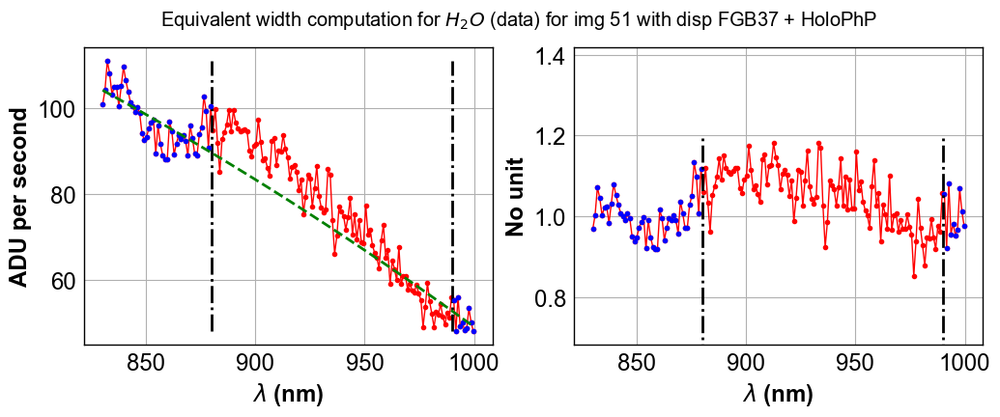

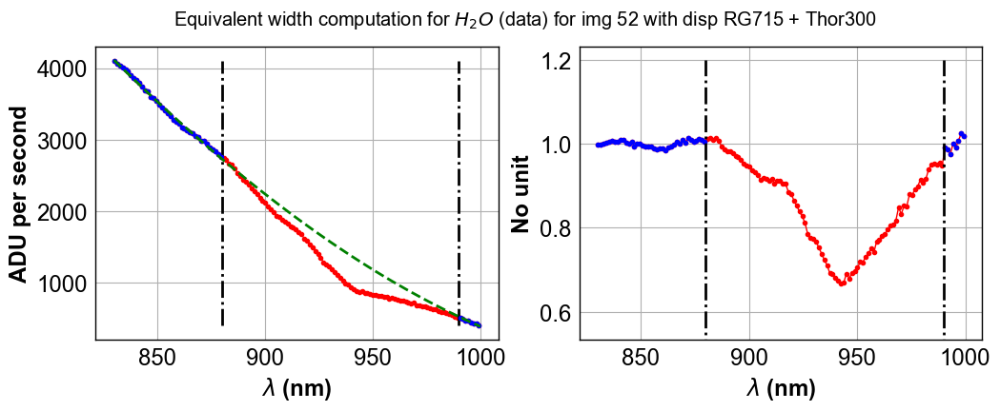

In [359]:
ShowAllEquivalentWidthNonLinear(all_rightspectra_wl,all_rightspectra_data,WL1_H2O_DATA,WL2_H2O_DATA,WL3_H2O_DATA,WL4_H2O_DATA,'$H_2O$ (data)',ndeg=3)

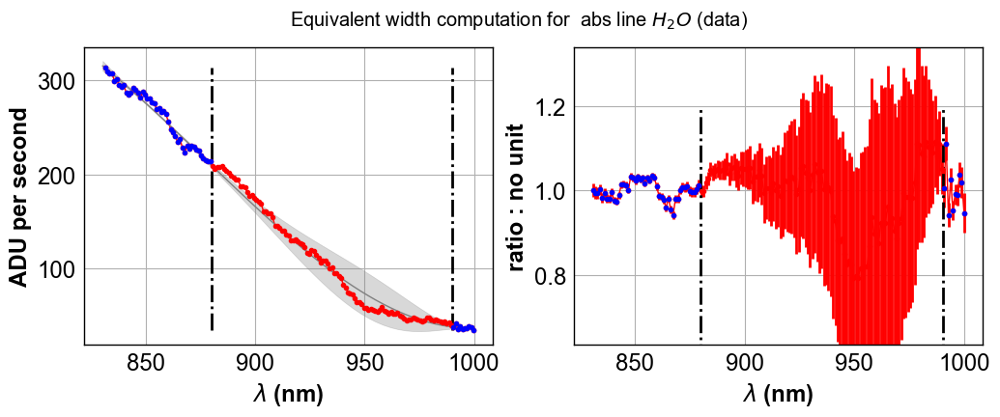

In [292]:
EQW_H2O_DATA = ShowEquivalentWidth2NonLinearwthStatErr(thewl,thespectrum,thespecstaterr,WL1_H2O_DATA,WL2_H2O_DATA,WL3_H2O_DATA,WL4_H2O_DATA,' abs line $H_2O$ (data)',ndeg=3)

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/li

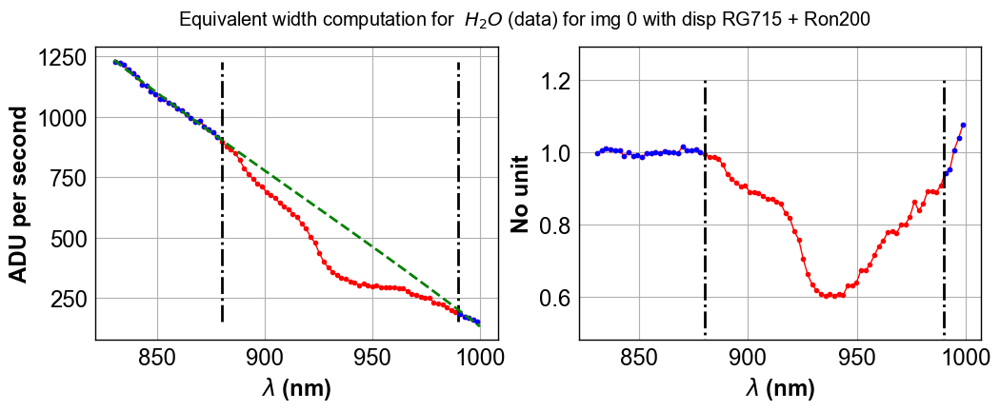

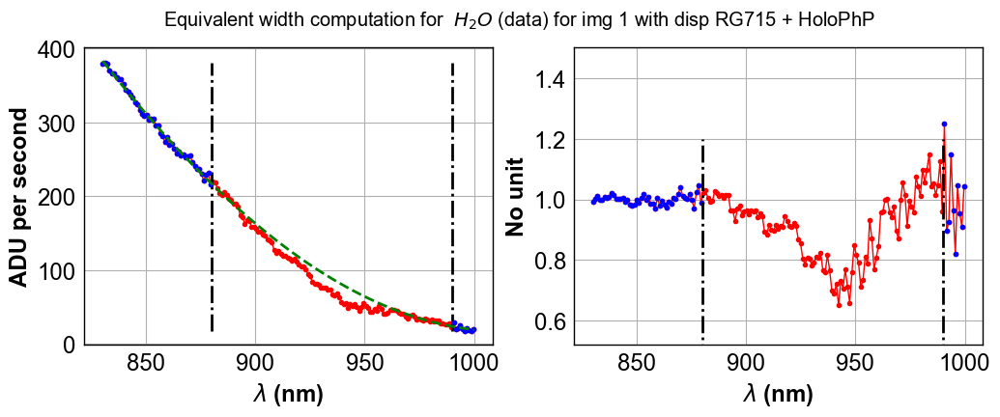

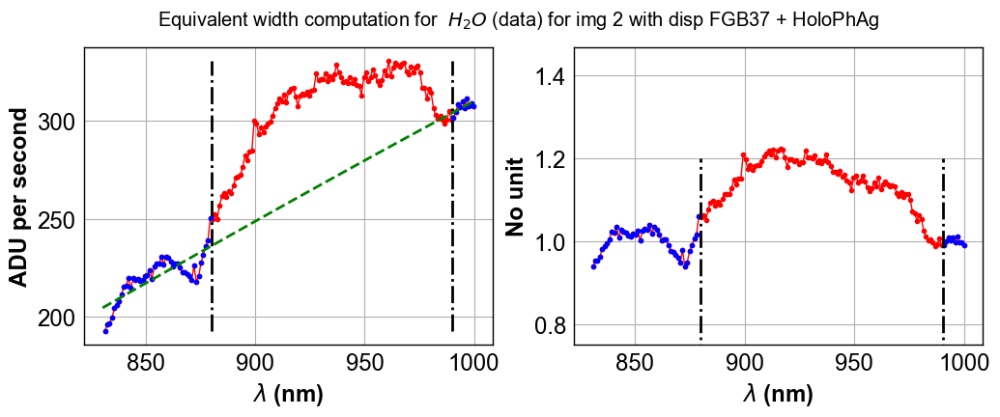

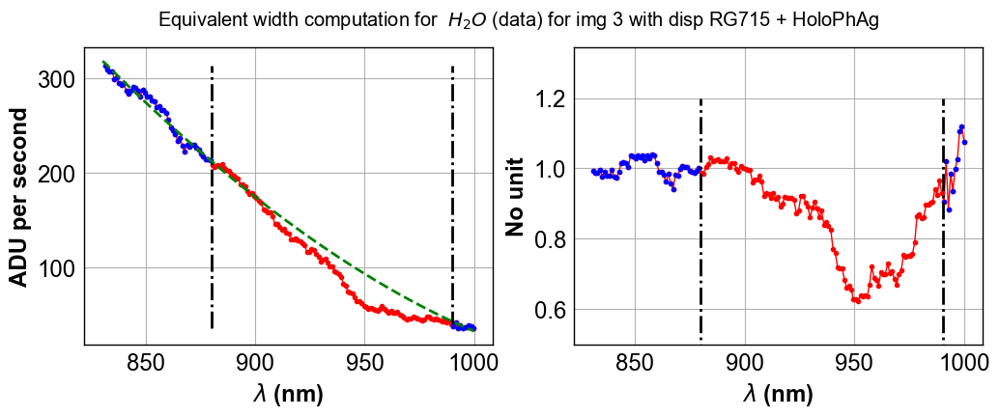

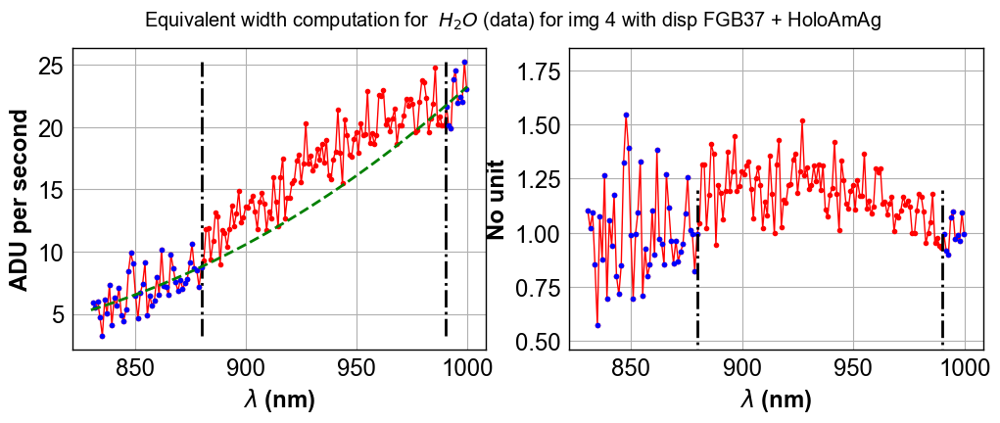

...

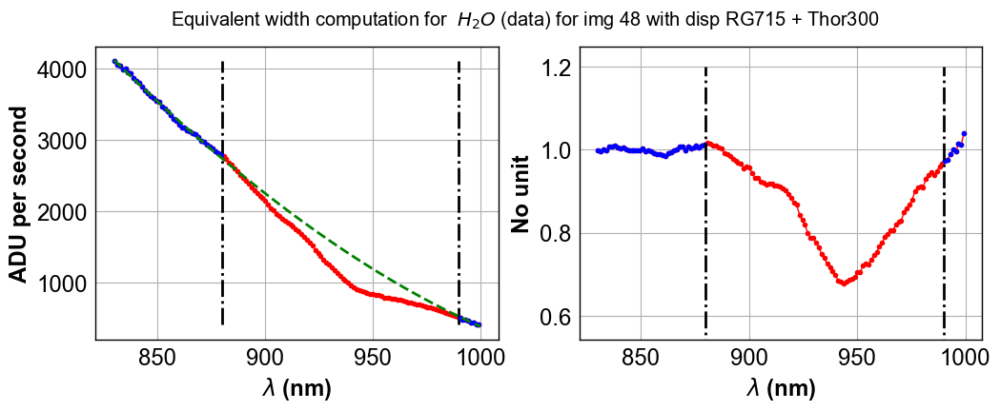

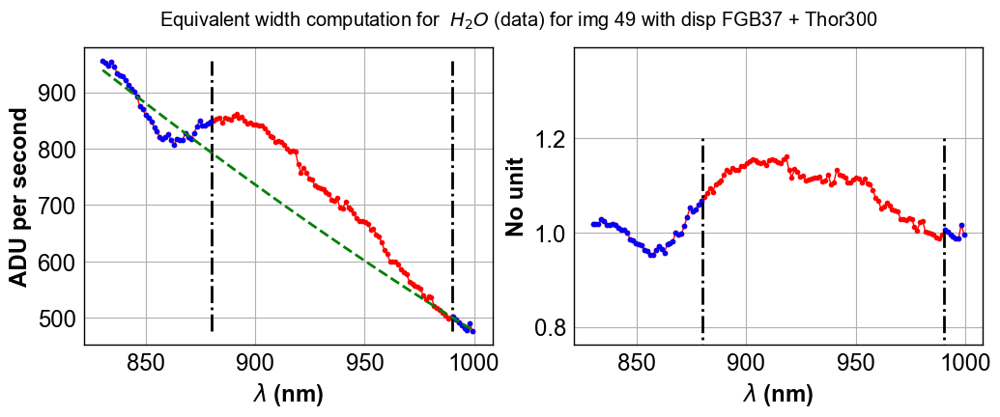

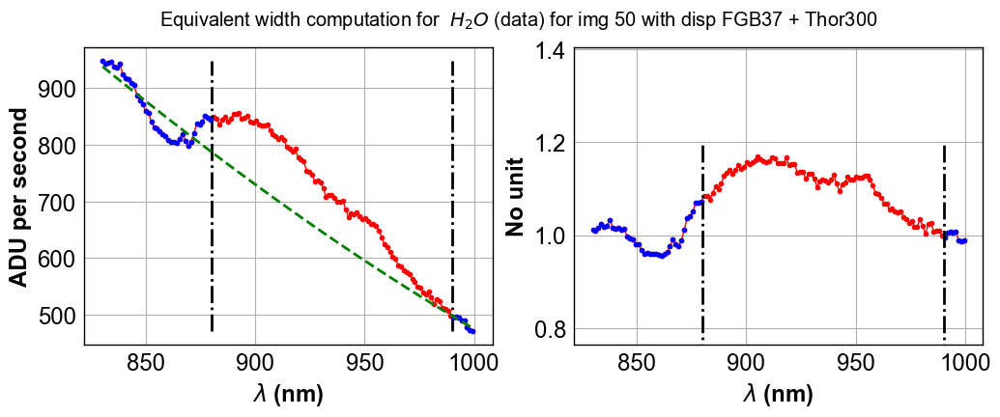

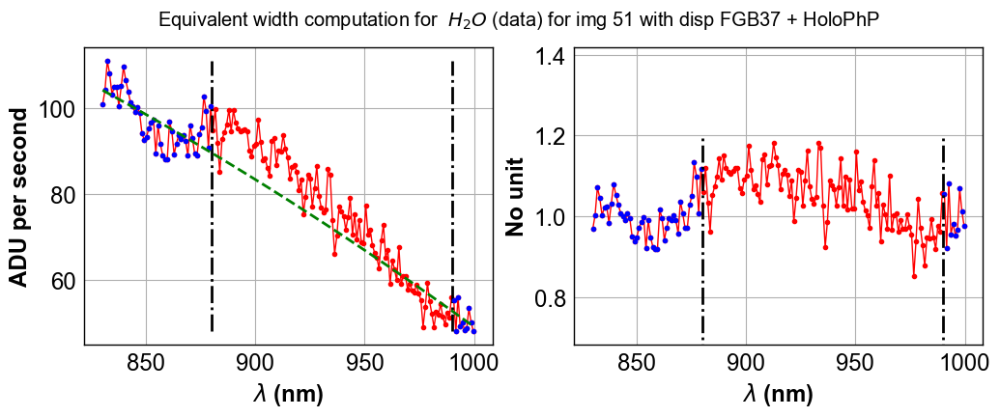

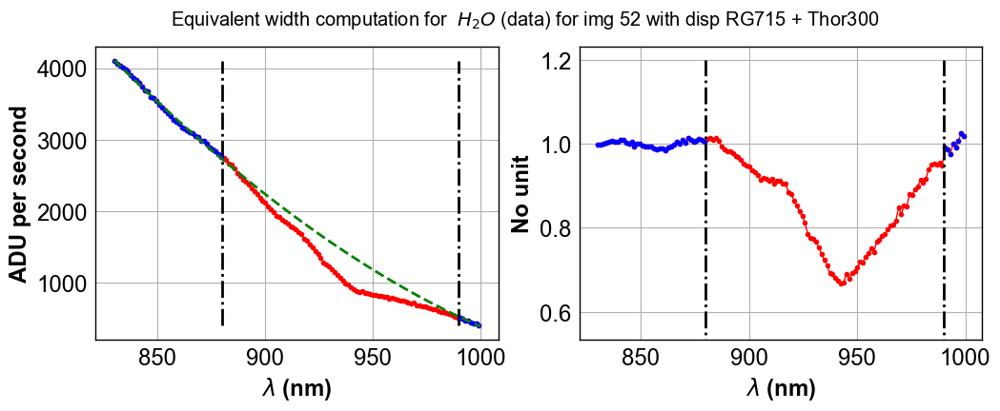

In [293]:
ShowAllEquivalentWidthNonLinear(all_rightspectra_wl,all_rightspectra_data,WL1_H2O_DATA,WL2_H2O_DATA,WL3_H2O_DATA,WL4_H2O_DATA,' $H_2O$ (data)',ndeg=3)

17.0283  nm 3.01002961173  nm
16.7659  nm 1.31689115356  nm
-24.2712  nm 3.43545471498  nm
1.02583  nm 2.10382757313  nm
-34.7807  nm 4.54812711642  nm
18.9636  nm 5.52559121198  nm
16.9297  nm 3.68371305406  nm
7.35552  nm 0.639025455116  nm
6.00202  nm 13.1128345696  nm
8.99714  nm 0.499629383617  nm
15.9725  nm 4.89019113131  nm
20.4041  nm 1.19554165056  nm
-25.0383  nm 3.62445040474  nm
3.95007  nm 0.729722273643  nm
5.46183  nm 14.0083406213  nm
16.3538  nm 3.97527084243  nm
0.342211  nm 2.61630731332  nm
18.0388  nm 0.822331307567  nm
6.47224  nm 0.598148623485  nm
18.5122  nm 5.67745811745  nm
8.10159  nm 1.63390556253  nm
6.10115  nm 13.3460244591  nm
5.83627  nm 1.09663467997  nm
-20.3013  nm 3.66438995847  nm
8.86943  nm 12.3756220802  nm
5.92221  nm 11.5751290001  nm
16.4779  nm 3.32612956036  nm
7.4618  nm 1.14888612733  nm
-9.0771  nm 26.3660620257  nm
6.5884  nm 11.6577571882  nm
-7.59367  nm 4.44866309658  nm
-16.8592  nm 1.7246842803  nm
10.6387  nm 0.399582409635  nm


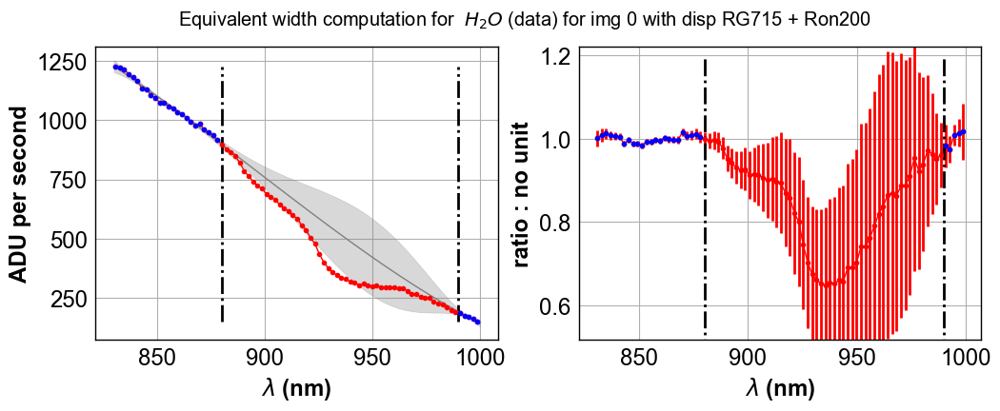

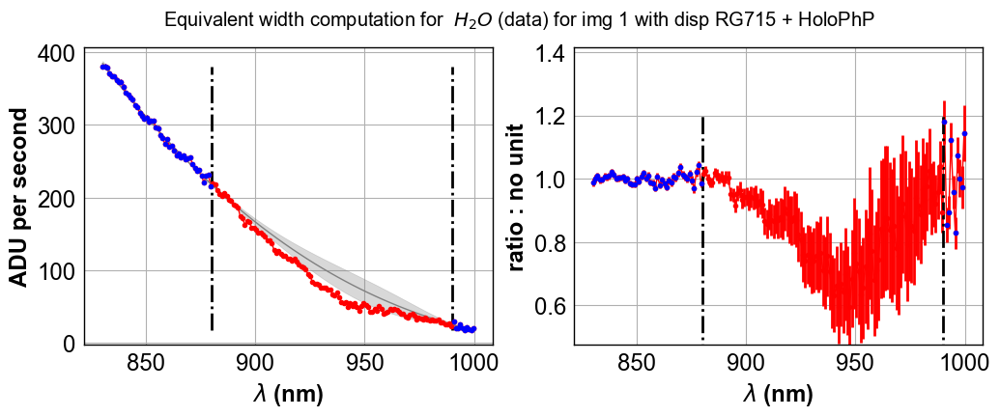

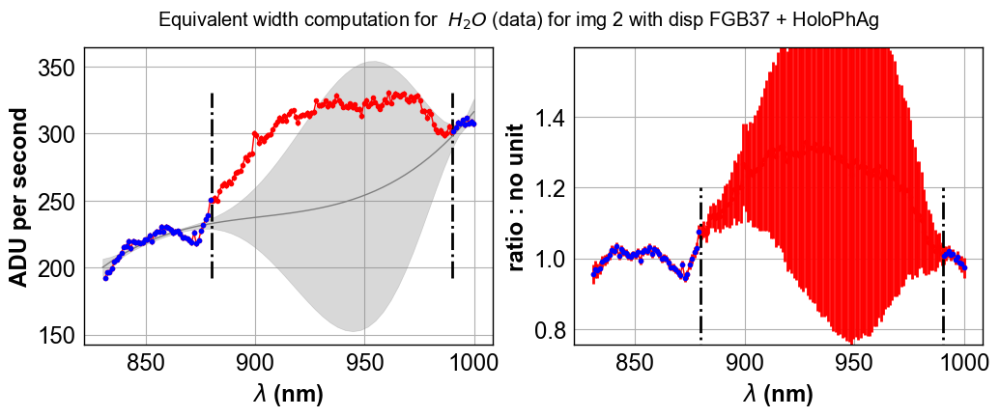

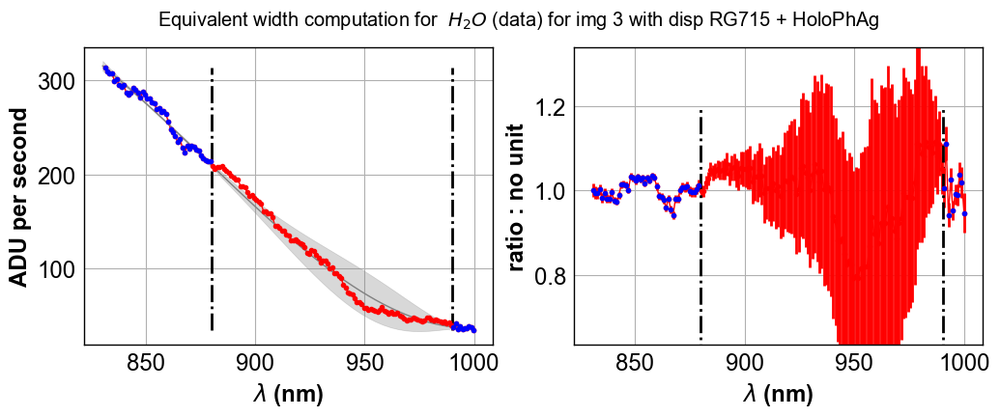

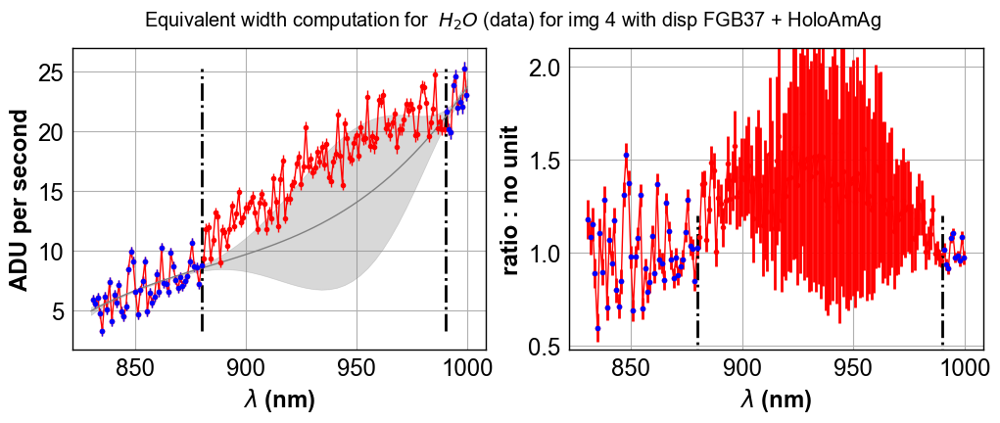

...

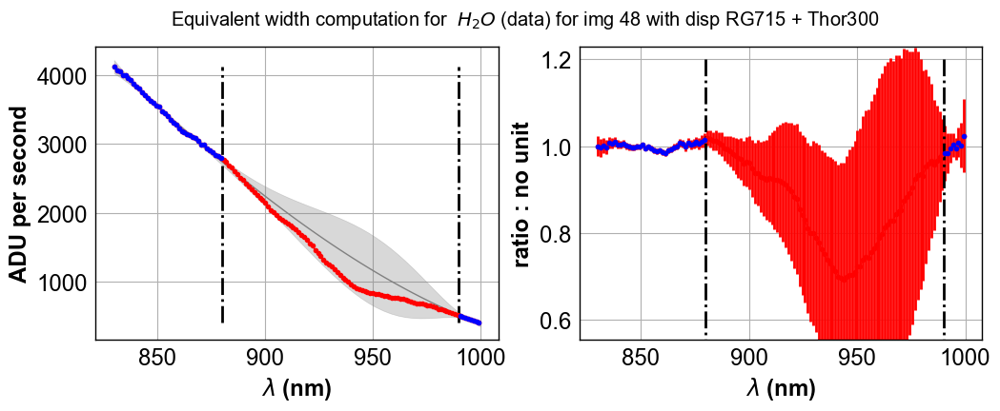

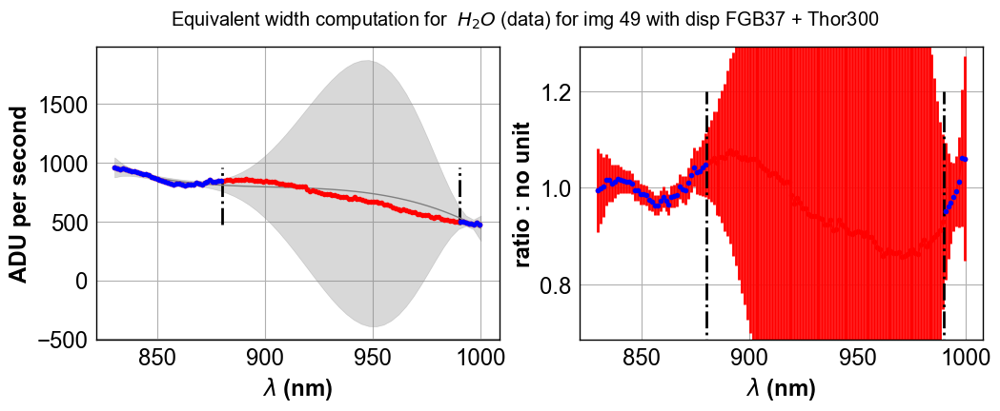

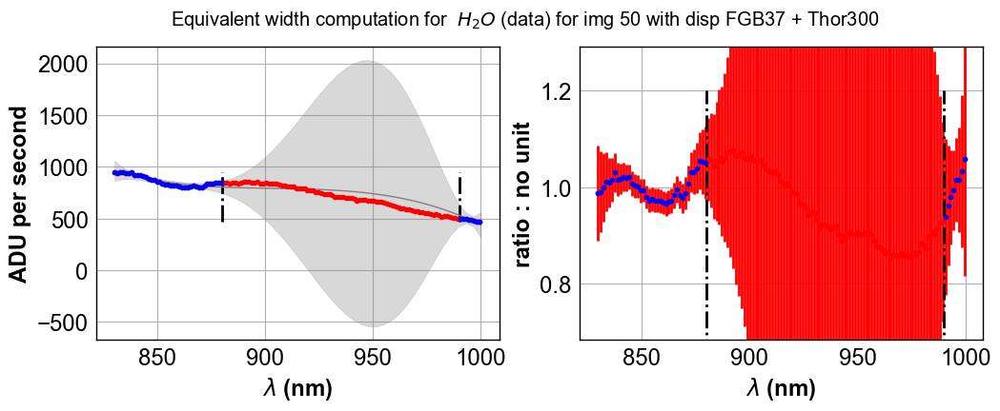

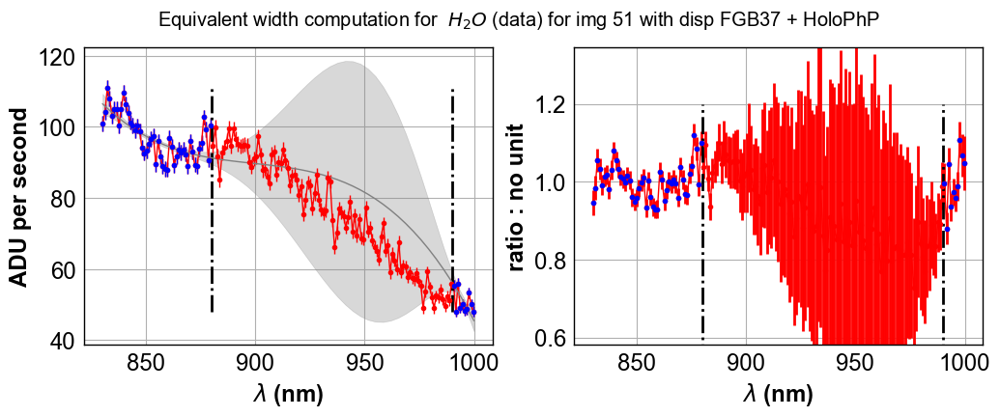

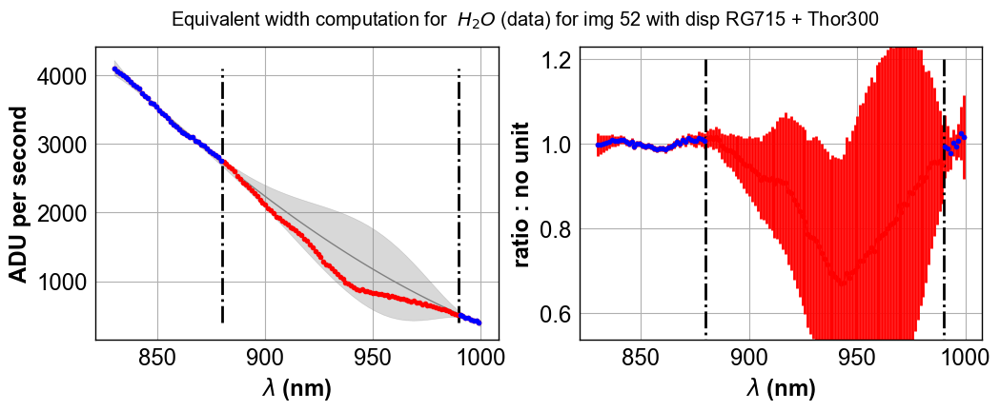

In [294]:
ShowAllEquivalentWidthNonLinearwthStatErr(all_rightspectra_wl,all_rightspectra_data,all_rightspectra_data_staterr,WL1_H2O_DATA,WL2_H2O_DATA,WL3_H2O_DATA,WL4_H2O_DATA,' $H_2O$ (data)',ndeg=3)

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:43: RuntimeWarning: invalid value encountered in divide


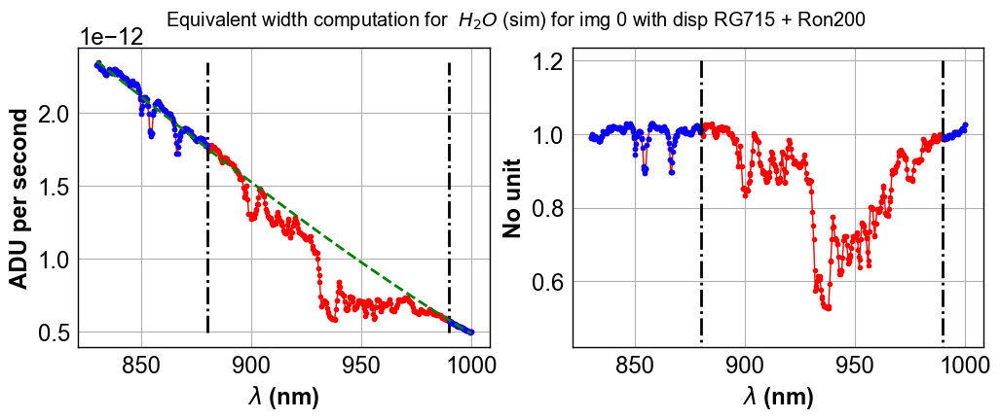

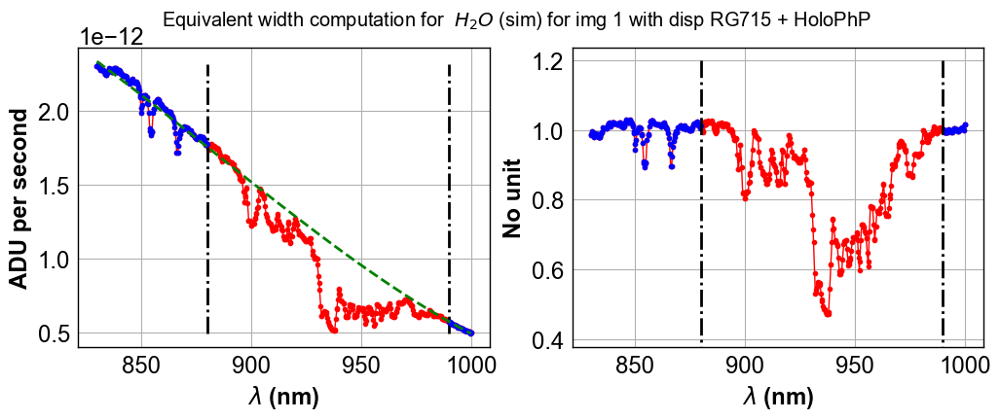

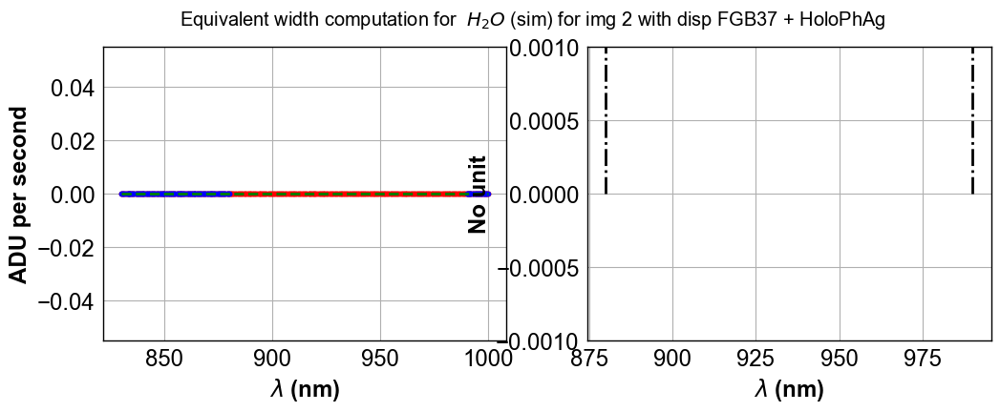

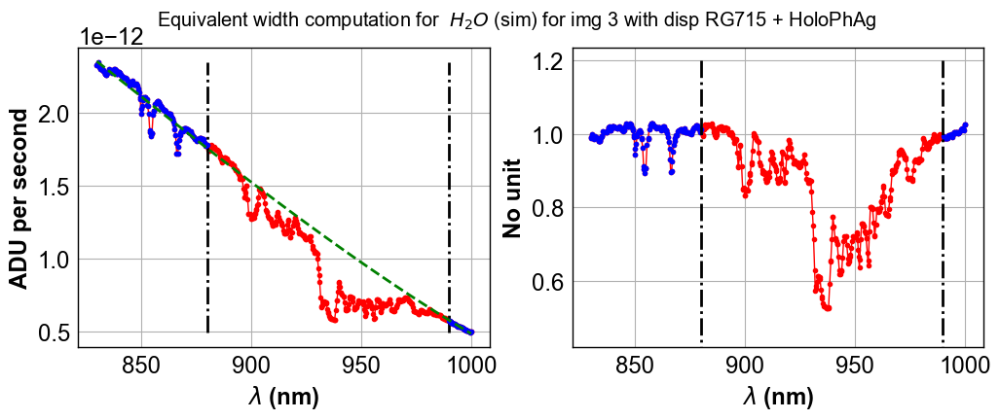

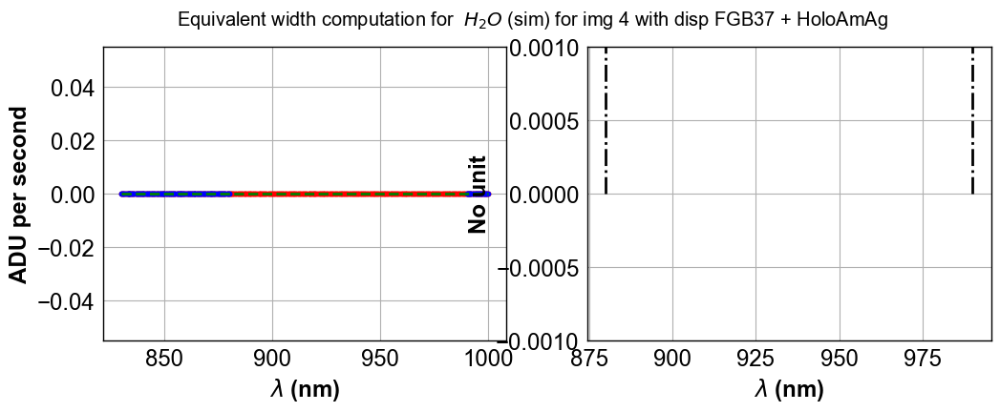

...

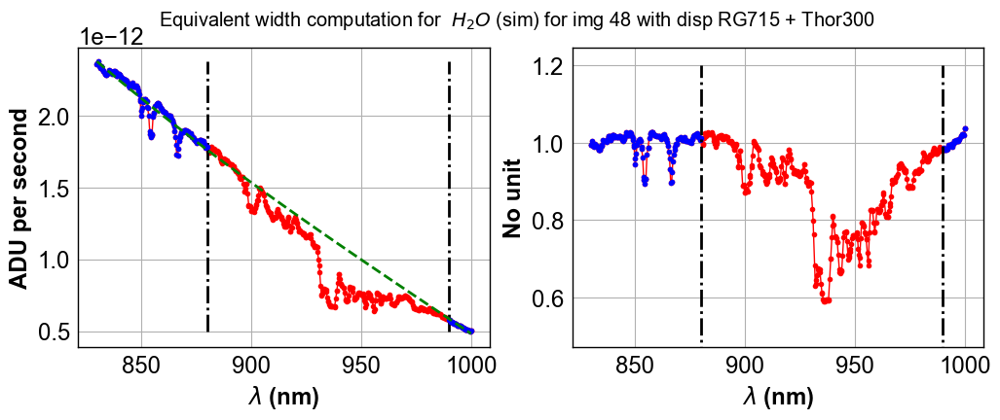

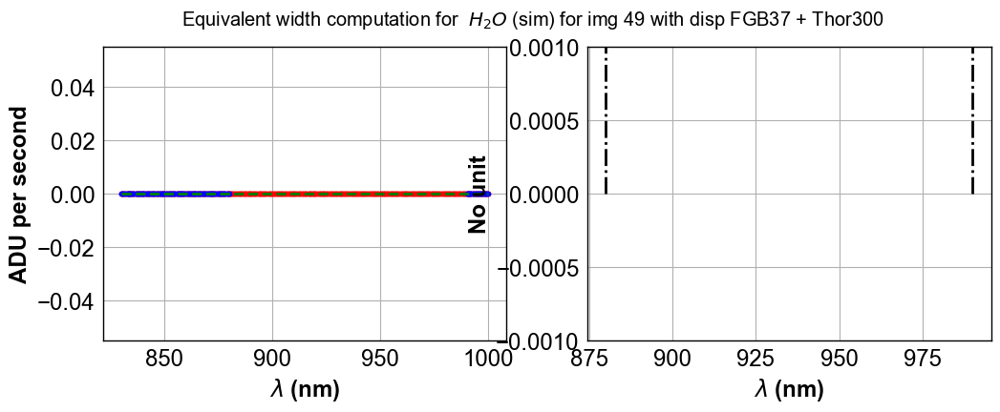

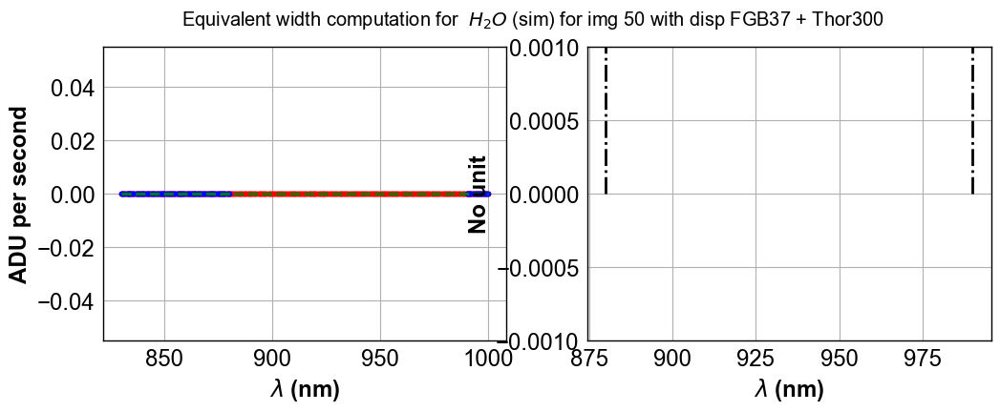

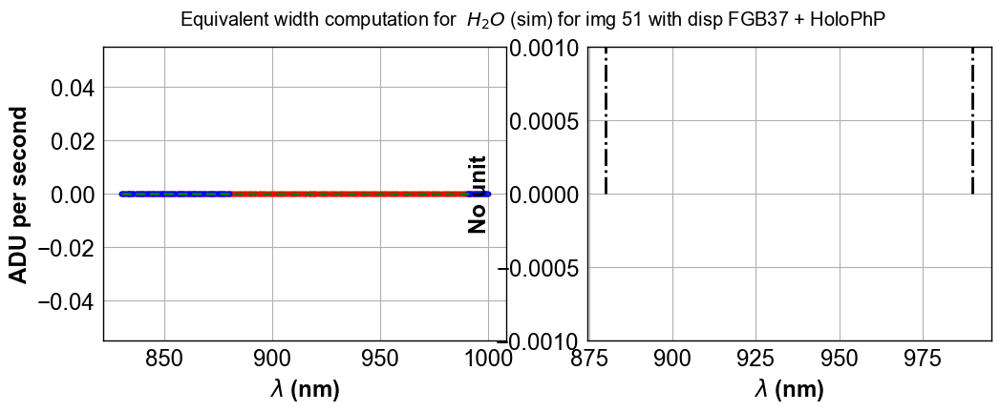

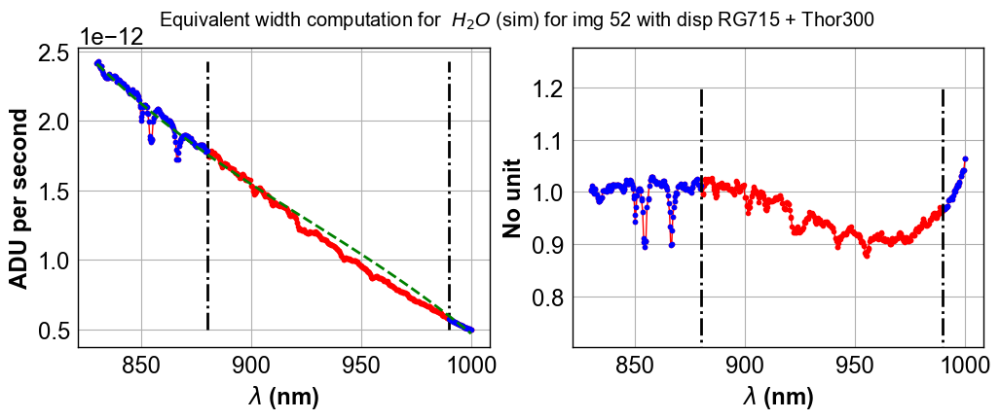

In [295]:
ShowAllEquivalentWidthNonLinear(allwl_sim,allspectra_sim,WL1_H2O_SIM,WL2_H2O_SIM,WL3_H2O_SIM,WL4_H2O_SIM,' $H_2O$ (sim)',ndeg=3)

In [296]:
#ShowAllEquivalentWidth(allwl_sim,allspectra_sim,WL1_H2O_SIM,WL2_H2O_SIM,WL3_H2O_SIM,WL4_H2O_SIM,' H2O (sim)')

In [360]:
All_eqw_H2O_Data=ComputeAllEquivalentWidthNonLinear(all_rightspectra_wl,all_rightspectra_data,WL1_H2O_DATA,WL2_H2O_DATA,WL3_H2O_DATA,WL4_H2O_DATA)

In [361]:
All_eqw_H2O_Data,All_eqw_H2O_Data_Err=ComputeAllEquivalentWidthNonLinearwthStatErr(all_rightspectra_wl,all_rightspectra_data,all_rightspectra_data_staterr,WL1_H2O_DATA,WL2_H2O_DATA,WL3_H2O_DATA,WL4_H2O_DATA,ndeg=3)

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/li

In [299]:
All_eqw_H2O_Sim=ComputeAllEquivalentWidthNonLinear(allwl_sim,allspectra_sim,WL1_H2O_SIM,WL2_H2O_SIM,WL3_H2O_SIM,WL4_H2O_SIM)

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RuntimeWarning: invalid value encountered in divide


In [300]:
All_eqw_H2O_Data=np.array(All_eqw_H2O_Data)
All_eqw_H2O_Sim=np.array(All_eqw_H2O_Sim)

disperser  RG715 + Ron200  not found
disperser  RG715 + Ron200  not found
disperser  RG715 + Ron200  not found
disperser  RG715 + Ron200  not found
disperser  FGB37 + Ron200  not found
disperser  FGB37 + Ron200  not found
disperser  FGB37 + Ron200  not found
disperser  RG715 + Ron200  not found


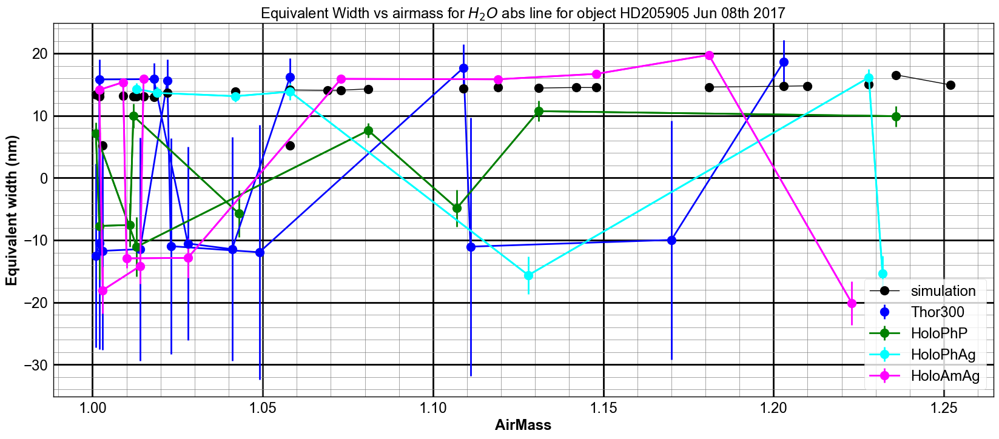

In [301]:
PlotEquivalentWidthVsAirMass(All_eqw_H2O_Data,All_eqw_H2O_Data_Err,All_eqw_H2O_Sim,am,'$H_2O$ abs line','eqwvsam_H2O.pdf')

[ 14.56625829  -3.92889397]
[ 12.27670192  -2.28196826]
[-14.12021515   5.31747879]
[ 4.5522012   1.55867574]


ValueError: array must not contain infs or NaNs

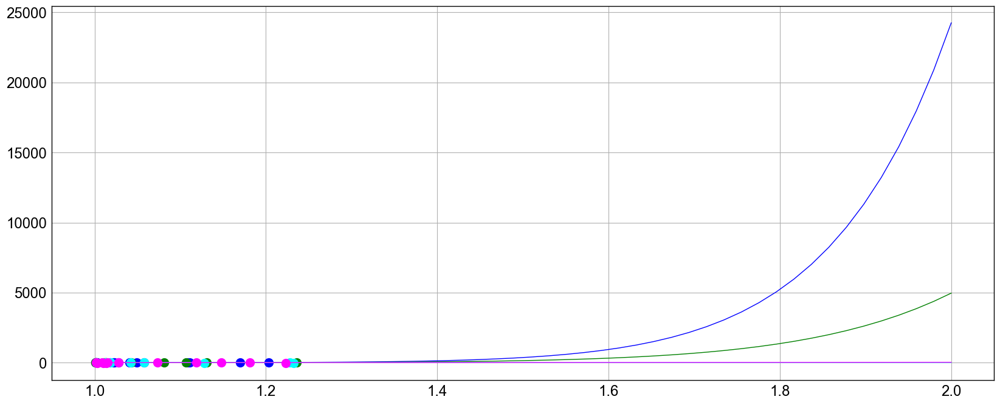

In [362]:
FitEquivalentWidthVsAirMass(All_eqw_H2O_Data,All_eqw_H2O_Sim,am,'$H_2O$ abs line','fiteqwvsam_H2O.pdf')

In [ ]:
PlotEquivalentWidthVsTime(All_eqw_H2O_Data,All_eqw_H2O_Sim,am,all_dt,'$H_2O$ abs line','eqwvstime_H20.pdf')

In [ ]:
plt.plot(am,all_hum,'o')

In [ ]:
X=All_eqw_H2O_Sim/All_eqw_O2_Sim

In [ ]:
plt.plot(all_hum,X,'o')
plt.xlabel("Relative humidity (%)")
plt.ylabel("$EQW(H_2O)/EQW(O_2)$")
plt.title("Equivalent width ratio vs rel humidity in sim")

In [ ]:
print Thor300_index
print Ron400_index
print HoloPhP_index
print HoloPhAg_index
print HoloAmAg_index

In [ ]:
X_Thor=All_eqw_H2O_Sim[Thor300_index]/All_eqw_O2_Sim[Thor300_index]
Y_Thor=All_eqw_H2O_Data[Thor300_index]/All_eqw_O2_Data[Thor300_index]

In [ ]:
X_HoloPhP=All_eqw_H2O_Sim[HoloPhP_index]/All_eqw_O2_Sim[HoloPhP_index]
Y_HoloPhP=All_eqw_H2O_Data[HoloPhP_index]/All_eqw_O2_Data[HoloPhP_index]

In [ ]:
X_HoloPhAg=All_eqw_H2O_Sim[HoloPhAg_index]/All_eqw_O2_Sim[HoloPhAg_index]
Y_HoloPhAg=All_eqw_H2O_Data[HoloPhAg_index]/All_eqw_O2_Data[HoloPhAg_index]

In [ ]:
X_HoloAmAg=All_eqw_H2O_Sim[HoloAmAg_index]/All_eqw_O2_Sim[HoloAmAg_index]
Y_HoloAmAg=All_eqw_H2O_Data[HoloAmAg_index]/All_eqw_O2_Data[HoloAmAg_index]

In [ ]:
plt.figure(figsize=(10,10))
plt.plot(X_Thor,Y_Thor,'bo',label='Thor 300')
plt.plot(X_HoloPhP,Y_HoloPhP,'go',label='HoloPhP')
plt.plot(X_HoloPhAg,Y_HoloPhAg,'o',color="cyan",label='HoloPhAg')
plt.plot(X_HoloAmAg,Y_HoloAmAg,'o',color="magenta",label='HoloAmAg')
plt.xlabel('EQW(H2O)/EQW(O2) in sim')
plt.ylabel('EQW(H2O)/EQW(O2) in data')
plt.legend()

## Save pandas file

In [ ]:
df=pd.DataFrame()

In [ ]:
df["airmass"]=all_airmass
df["time"]=all_dates
df["disperser"]=all_filt
df["humidity"]=all_hum
df["EQW_O2_DATA"]= All_eqw_O2_Data
df["EQW_H2O_DATA"]= All_eqw_H2O_Data
df["EQW_O2_DATA_ERR"]= All_eqw_O2_Data_Err
df["EQW_H2O_DATA_ERR"]= All_eqw_H2O_Data_Err
df["EQW_O2_SIM"]= All_eqw_O2_Sim
df["EQW_H2O_SIM"]= All_eqw_H2O_Sim

In [ ]:
df

In [ ]:
fulloutput=os.path.join(outputdir,output_file)

In [ ]:
fulloutput

In [ ]:
df.to_csv(fulloutput)